In [1]:
# enable automatic reloading of the notebook
%load_ext autoreload
%autoreload 2

# Data Analysis
This notebook contains the scripts used for analyzing the retrieved data.

## Load Dataset

Loads the dataset, counts the number of articles loaded, and converts the
list of json objects into a Python Pandas Data Frame.

In [2]:
# import the dataset loader
from src.data.dataset import load_dataset


In [3]:
# load the raw articles
dataset = load_dataset

In [5]:
# check how many articles were loaded
len(dataset())

default path: 
/home/matevzm/WorldNews/data/raw
default path: 
/home/matevzm/WorldNews/data/raw


KeyboardInterrupt: 

## Dataset Statistics

Dataset statistics will provide insight into what type of articles 
did we collect. To best simulate the real-world scenario, we must
first find the articles distribution per 

- datetime
- language
- source
- events

In order to do so, here is a list of tasks we need to perform.

- **Datetime distribution.** Create a histogram or line chart with the
  datetime on the x-axis and the article count on the y-axis.
- **Language distribution.** Create a bar chart showing the article's
  distribution by language.
- **Language coocurrence.** Create a heatmap showing in which languages
  are the events most commonly reported in (based on the `eventUri` 
  attribute).
- **Source distribution.** Create a bar chart showing the article's 
  distribution by source.
- **Number of duplicates.** Get the number of article duplicates in the
  data set.

In addition, we are interested in the above distributions for each 
group of articles, where a group of articles is defined as the articles
that contain the same `concept` values.

In [4]:
# import required libraries
import pandas as pd

In [104]:
import matplotlib.pyplot as plt
import numpy as np
%matplotlib inline


In [6]:
import seaborn as sns

In [7]:
df = pd.DataFrame.from_dict(dataset())

default path: 
/home/matevzm/WorldNews/data/raw
default path: 
/home/matevzm/WorldNews/data/raw
default path: 
/home/matevzm/WorldNews/data/raw
default path: 
/home/matevzm/WorldNews/data/raw
default path: 
/home/matevzm/WorldNews/data/raw
default path: 
/home/matevzm/WorldNews/data/raw
default path: 
/home/matevzm/WorldNews/data/raw
default path: 
/home/matevzm/WorldNews/data/raw
default path: 
/home/matevzm/WorldNews/data/raw
default path: 
/home/matevzm/WorldNews/data/raw
default path: 
/home/matevzm/WorldNews/data/raw


In [9]:
dataset()[0]

default path: 
/home/matevzm/WorldNews/data/raw
default path: 
/home/matevzm/WorldNews/data/raw
default path: 
/home/matevzm/WorldNews/data/raw
default path: 
/home/matevzm/WorldNews/data/raw
default path: 
/home/matevzm/WorldNews/data/raw
default path: 
/home/matevzm/WorldNews/data/raw
default path: 
/home/matevzm/WorldNews/data/raw
default path: 
/home/matevzm/WorldNews/data/raw
default path: 
/home/matevzm/WorldNews/data/raw
default path: 
/home/matevzm/WorldNews/data/raw
default path: 
/home/matevzm/WorldNews/data/raw


{'uri': '1453078729',
 'lang': 'deu',
 'isDuplicate': True,
 'date': datetime.datetime(2020, 2, 19, 0, 0),
 'time': '06:26:00',
 'dateTime': datetime.datetime(2020, 2, 19, 6, 26),
 'dateTimePub': datetime.datetime(2020, 2, 19, 5, 49),
 'dataType': 'news',
 'sim': 0,
 'url': 'https://www.watson.de/!350934492',
 'title': 'Zoff zwischen US-Präsidenten: Obama twittert - Trump völlig aus',
 'body': 'BVB: Sammer bereitet wohl mögliches Favre-Aus vor - zwei Kandidaten im Gespräch\n\nDonald Trump, 45. Präsident der Vereinigten Staaten von Amerika, hat eine sehr kurze Zündschnur. Vor allem dann, wenn es irgendeiner wagt, auch nur im Entferntesten über seine Person zu sprechen. Oder seine Erfolge.\n\nHeißt dieser "irgendeiner" dann noch Barack Obama, dann gute Nacht!\n\nDiese unheilvolle Kombination aus Barack Obama und einem Thema, das Donald Trump sehr am Herzen liegt, sorgte Anfang dieser Woche für einen spontanen Wutausbruch des Präsidenten.\n\nBegonnen hat alles mit diesem Tweet von Ex-Präs

array([[<AxesSubplot:title={'center':'dateTime'}>]], dtype=object)

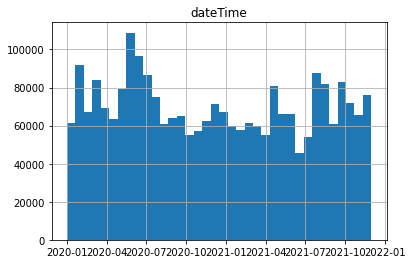

In [20]:
df.hist(column='dateTime', bins=36)

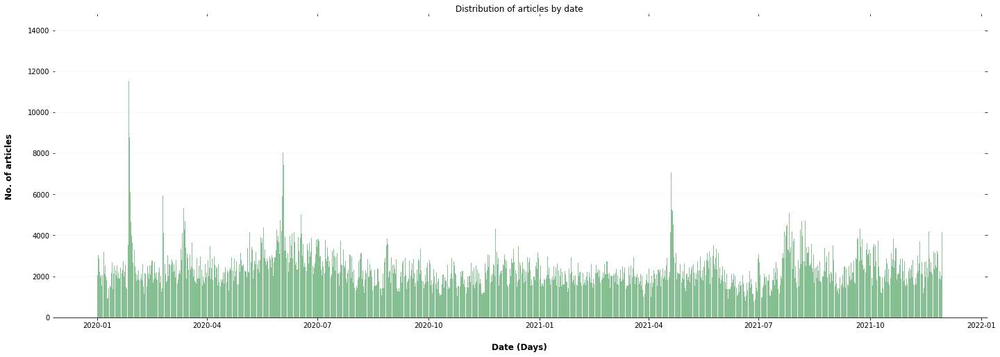

In [503]:
ax = df.hist(column='dateTime', bins=1080, grid=False, figsize=(24,8), color='#86bf91', zorder=2, rwidth=0.9)

ax = ax[0]
for x in ax:

    # Despine
    x.spines['right'].set_visible(False)
    x.spines['top'].set_visible(False)
    x.spines['left'].set_visible(False)

    # Switch off ticks
    x.tick_params(axis="both", which="both", bottom="off", top="off", labelbottom="on", left="off", right="off", labelleft="on")

    # Draw horizontal axis lines
    vals = x.get_yticks()
    for tick in vals:
        x.axhline(y=tick, linestyle='dashed', alpha=0.4, color='#eeeeee', zorder=1)

    # Remove title
    x.set_title("Distribution of articles by date")

    # Set x-axis label
    x.set_xlabel("Date (Days)", labelpad=20, weight='bold', size=12)

    # Set y-axis label
    x.set_ylabel("No. of articles", labelpad=20, weight='bold', size=12)


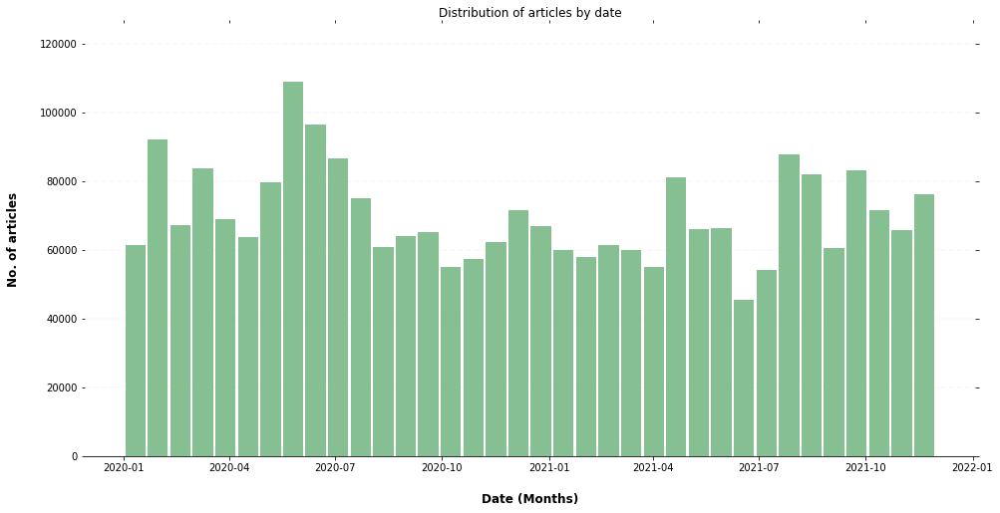

In [502]:
ax = df.hist(column='dateTime', bins=36, grid=False, figsize=(16,8), color='#86bf91', zorder=2, rwidth=0.9)

ax = ax[0]
for x in ax:

    # Despine
    x.spines['right'].set_visible(False)
    x.spines['top'].set_visible(False)
    x.spines['left'].set_visible(False)

    # Switch off ticks
    x.tick_params(axis="both", which="both", bottom="off", top="off", labelbottom="on", left="off", right="off", labelleft="on")

    # Draw horizontal axis lines
    vals = x.get_yticks()
    for tick in vals:
        x.axhline(y=tick, linestyle='dashed', alpha=0.4, color='#eeeeee', zorder=1)

    # Remove title
    x.set_title("Distribution of articles by date")

    # Set x-axis label
    x.set_xlabel("Date (Months)", labelpad=20, weight='bold', size=12)

    # Set y-axis label
    x.set_ylabel("No. of articles", labelpad=20, weight='bold', size=12)


In [19]:
df['lang'].value_counts()

eng    1313804
spa     431470
deu     306985
fra     151301
por      94747
rus      92385
zho      73433
jpn      34936
slv      10796
ara       9201
Name: lang, dtype: int64

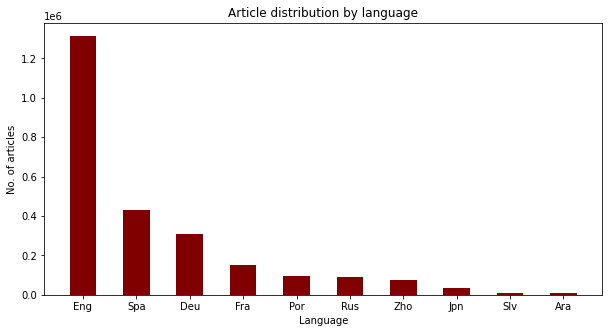

In [112]:
import numpy as np
import matplotlib.pyplot as plt

data_dict = {'Eng':1313804, 'Spa':431470, 'Deu':306985,'Fra':151301, 'Por':94747, 'Rus':92385, 'Zho':73433,'Jpn':35936, 'Slv':10796, 'Ara':9201}
lang = list(data_dict.keys())
no = list(data_dict.values())
fig = plt.figure(figsize = (10, 5))
#  Bar plot
plt.bar(lang, no, color ='maroon',
        width = 0.5)
plt.xlabel("Language")
plt.ylabel("No. of articles")
plt.title("Article distribution by language")
plt.show()

<AxesSubplot:title={'center':'Article distribution by language'}, ylabel='No. of Articles'>

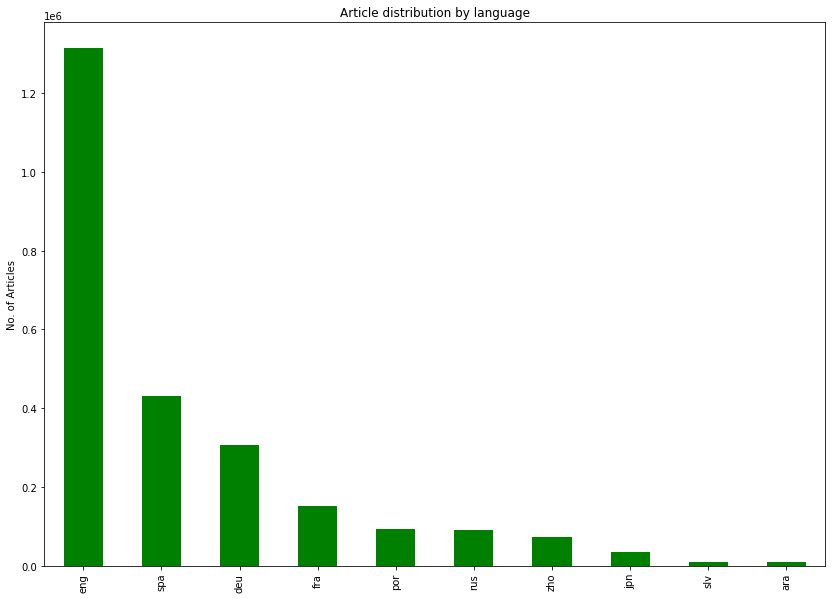

In [161]:
df['lang'].value_counts().plot(kind='bar', title='Article distribution by language', ylabel='No. of Articles', figsize=(14,10), color='green')

<AxesSubplot:title={'center':'Article distribution by source'}, ylabel='No. of Articles'>

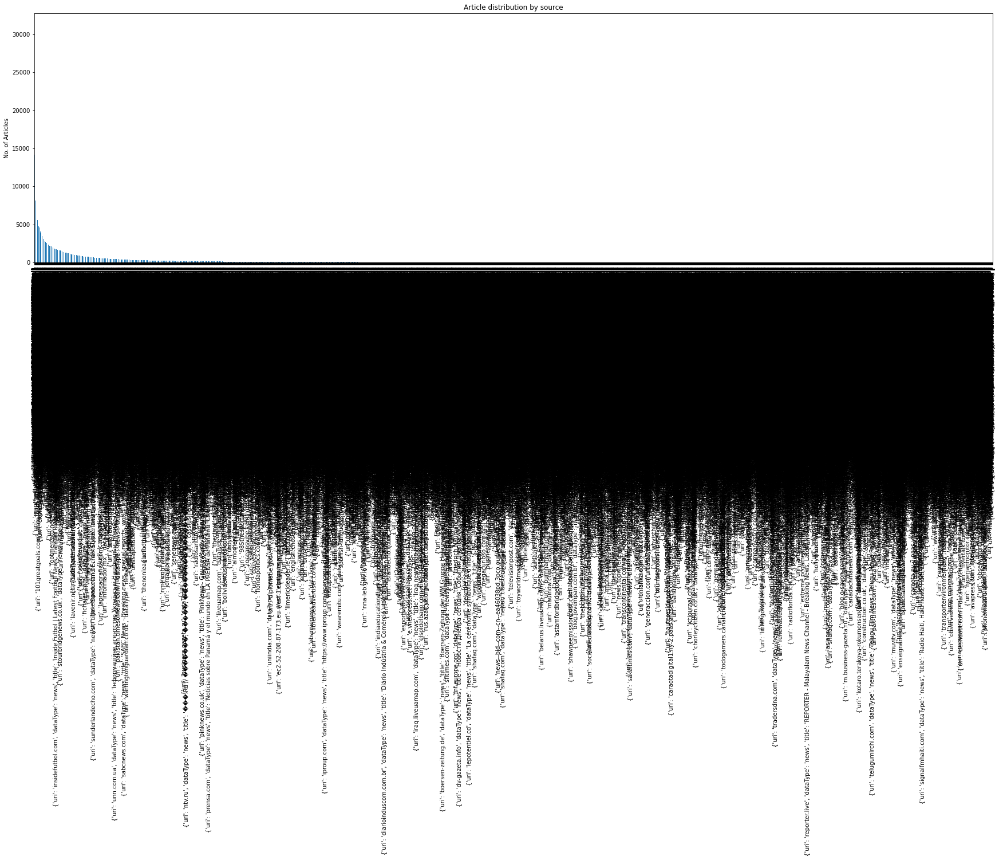

In [164]:
df.source.value_counts().plot(kind='bar', title='Article distribution by source', ylabel='No. of Articles', figsize=(30, 8) )

<AxesSubplot:title={'center':'Article distribution by Eventuri'}, ylabel='No. of Articles'>

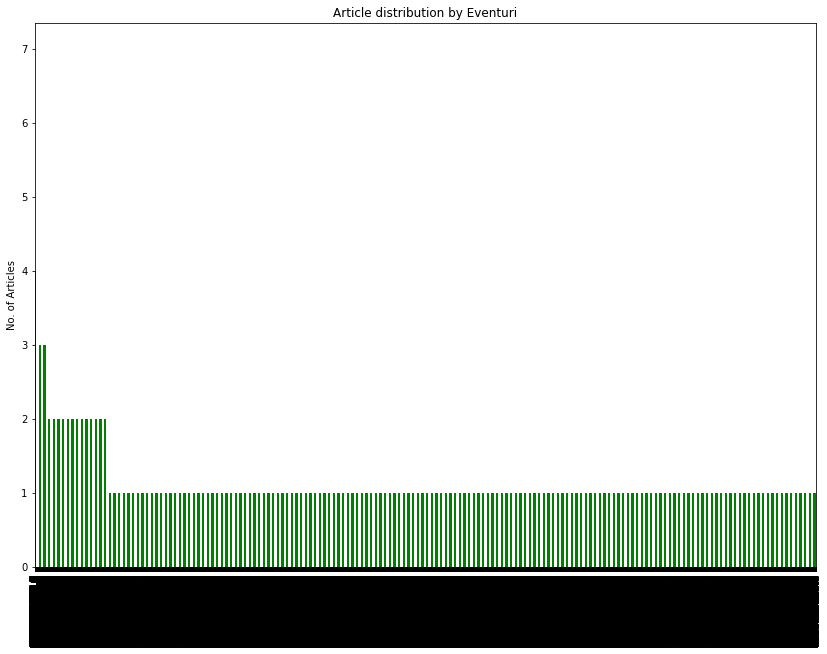

In [517]:
df['eventUri'].value_counts().plot(kind='bar', title='Article distribution by Eventuri', ylabel='No. of Articles', figsize=(14,10), color='green')

In [ ]:
df['concepts'].value_counts()

TypeError: unhashable type: 'list'

Exception ignored in: 'pandas._libs.index.IndexEngine._call_map_locations'
Traceback (most recent call last):
  File "pandas/_libs/hashtable_class_helper.pxi", line 5231, in pandas._libs.hashtable.PyObjectHashTable.map_locations
TypeError: unhashable type: 'list'


[association_football, premier_league]                697260
[association_football, la_liga]                       375361
[basketball, nba]                                     352636
[association_football, bundesliga]                    298314
[association_football, UEFA_europa_league]            146060
[european_migrant_crisis]                             118421
[me_too_movement]                                     114268
[volcano, types_of_volcanic_eruptions]                 80729
[presidency_of_the_council_of_the_european_union]      73621
[black_lives_matter]                                   73053
[hong_kong, demonstration]                             60031
[kobe_bryant, helicopter]                              41587
[olympic_games, japan, basketball]                     16850
[panama_papers]                                        15981
[olympic_games, japan, judo]                           15579
[olympic_games, japan, skateboarding]                  10833
[olympic_games, japan, r

In [ ]:
# pandas pivot
heatmap1_data = pd.pivot(df, values='eventUri',  columns='lang')

In [ ]:
def list2Str(lst):
    if type(lst) is list: # apply conversion to list columns
        return";".join(lst)
    else:
        return lst
g=df[[''eventUri','lang']].apply(lambda x: [list2Str(i) for i in x])
g


SyntaxError: invalid syntax (1392053663.py, line 6)

In [ ]:
results=df.groupby('lang').sum()
print(results)

      isDuplicate            sim      eventUri     sentiment              wgt  \
lang                                                                            
ara          2030    2866.474562  5.116288e+13       0.00000    3178627924620   
deu        144299   61524.691329  1.737933e+15       0.00000  104678276805360   
eng        467096  417778.692010  7.550504e+15  169155.72549  453346794543300   
fra         35194   42555.255759  8.779499e+14       0.00000   52319238997980   
jpn          5200   12140.898318  2.037933e+14       0.00000   12021358768200   
por         20295   28395.345699  5.677857e+14       0.00000   32943179151660   
rus          5369   19655.576993  5.497596e+14       0.00000   32085177192240   
slv          1023    1692.556885  6.217482e+13       0.00000    3732756875160   
spa         82233  138414.363852  2.519113e+15       0.00000  149478613274340   
zho          5994   37323.177377  4.249713e+14       0.00000   25231444001040   

          relevance  
lang 

In [ ]:
print(heatmap1_data.head(10))

lang  ara           deu  eng  fra  jpn  por  rus  slv  spa  zho
0     NaN  1.453079e+09  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN
1     NaN  1.453470e+09  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN
2     NaN  1.453494e+09  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN
3     NaN  1.454035e+09  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN
4     NaN  1.454366e+09  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN
..    ...           ...  ...  ...  ...  ...  ...  ...  ...  ...
95    NaN  6.082685e+09  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN
96    NaN  6.082696e+09  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN
97    NaN  6.082696e+09  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN
98    NaN  6.082726e+09  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN
99    NaN  6.082735e+09  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN

[100 rows x 10 columns]


go through eventUriri and change strings to float (coerce errors)

In [ ]:
df["eventUri"] = pd.to_numeric(df["eventUri"], downcast="integer", errors='coerce')

<AxesSubplot:xlabel='lang'>

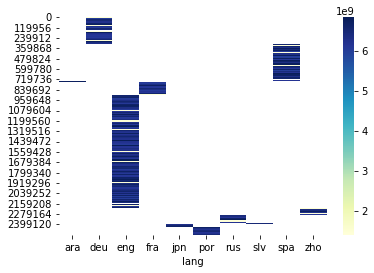

In [ ]:
sns.heatmap(heatmap1_data, cmap="YlGnBu", gigl)

Stevilo duplikatov in unikatnih clankov

In [ ]:
df['isDuplicate'].value_counts()

False    1750325
True      768733
Name: isDuplicate, dtype: int64

making a new Data frame using with just the required parameters and making sure all columns are the right object

This dataframe is called str

In [ ]:
def list2Str(lst):
    if type(lst) is list: # apply conversion to list columns
        return";".join(lst)
    else:
        return lst
str=df[['concepts','source', 'eventUri','lang','dateTime', 'isDuplicate']].apply(lambda x: [list2Str(i) for i in x])

In [ ]:
str

,concepts,source,eventUri,lang,dateTime,isDuplicate
0,volcano;types_of_volcanic_eruptions,"{'uri': 'watson.de', 'dataType': 'news', 'titl...",1.453079e+09,deu,2020-02-19 06:26:00,True
1,volcano;types_of_volcanic_eruptions,"{'uri': 'thueringer-allgemeine.de', 'dataType'...",1.453470e+09,deu,2020-02-19 12:46:00,False
2,volcano;types_of_volcanic_eruptions,"{'uri': 'tlz.de', 'dataType': 'news', 'title':...",1.453494e+09,deu,2020-02-19 13:09:00,True
3,volcano;types_of_volcanic_eruptions,"{'uri': 'br.de', 'dataType': 'news', 'title': ...",1.454035e+09,deu,2020-02-19 21:59:00,False
4,volcano;types_of_volcanic_eruptions,"{'uri': 'arte.tv', 'dataType': 'news', 'title'...",1.454366e+09,deu,2020-02-20 05:37:00,False
...,...,...,...,...,...,...
2519053,volcano;types_of_volcanic_eruptions,"{'uri': 'jtm.com.mo', 'dataType': 'news', 'tit...",6.408992e+09,por,2021-01-28 07:30:00,False
2519054,volcano;types_of_volcanic_eruptions,"{'uri': 'renovamidia.com.br', 'dataType': 'new...",6.409983e+09,por,2021-01-28 19:54:00,False
2519055,volcano;types_of_volcanic_eruptions,"{'uri': 'pt.euronews.com', 'dataType': 'news',...",6.410506e+09,por,2021-01-29 06:21:00,False
2519056,volcano;types_of_volcanic_eruptions,"{'uri': 'inforpress.cv', 'dataType': 'news', '...",6.412184e+09,por,2021-01-30 11:38:00,False


creating a dict dataframe by concepts

In [ ]:
df_concepts={name: str[str['concepts']==name] for name in str['concepts'].unique()}

accessing individual concepts 

In [ ]:
df_concepts['association_football;premier_league']

,concepts,source,eventUri,lang,dateTime
5976,association_football;premier_league,"{'uri': 'thueringer-allgemeine.de', 'dataType'...",6.202342e+09,deu,2020-09-02 06:05:00
5977,association_football;premier_league,"{'uri': 'salzgitter-zeitung.de', 'dataType': '...",6.202353e+09,deu,2020-09-02 06:17:00
5978,association_football;premier_league,"{'uri': 'wolfsburger-nachrichten.de', 'dataTyp...",6.202381e+09,deu,2020-09-02 06:47:00
5979,association_football;premier_league,"{'uri': 'weltfussball.at', 'dataType': 'news',...",6.202400e+09,deu,2020-09-02 07:05:00
5980,association_football;premier_league,"{'uri': 'focus.de', 'dataType': 'news', 'title...",6.202546e+09,deu,2020-09-02 09:14:00
...,...,...,...,...,...
2518423,association_football;premier_league,"{'uri': 'mg.superesportes.com.br', 'dataType':...",6.664957e+09,por,2021-07-27 22:38:00
2518424,association_football;premier_league,"{'uri': 'superesportes.com.br', 'dataType': 'n...",6.664978e+09,por,2021-07-27 23:09:00
2518425,association_football;premier_league,"{'uri': 'observatoriodocinema.uol.com.br', 'da...",6.664992e+09,por,2021-07-27 23:29:00
2518426,association_football;premier_league,"{'uri': 'superesportes.com.br', 'dataType': 'n...",6.665005e+09,por,2021-07-27 23:48:00


NameError: name 'StrMethodFormatter' is not defined

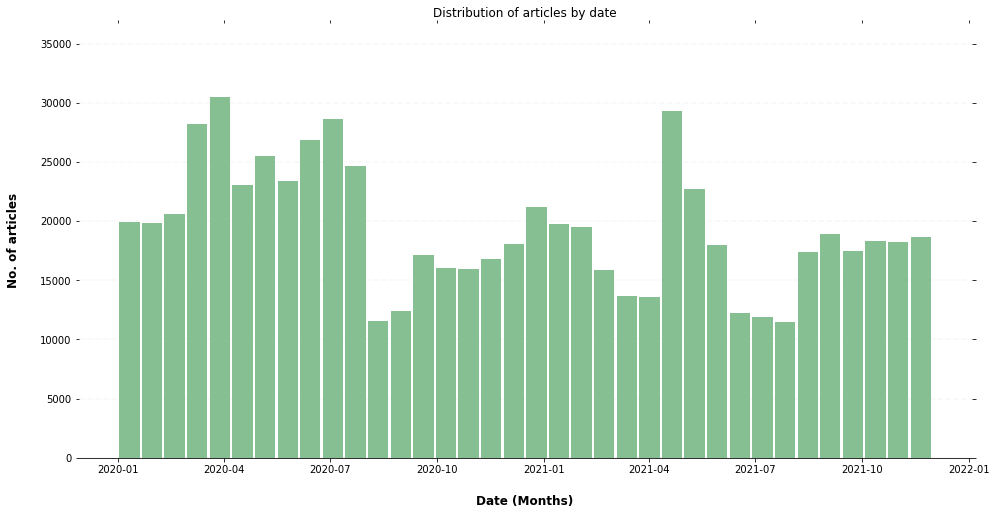

In [ ]:
ax = df_concepts['association_football;premier_league'].hist(column='dateTime', bins=36, grid=False, figsize=(16,8), color='#86bf91', zorder=2, rwidth=0.9)

ax = ax[0]
for x in ax:

    # Despine
    x.spines['right'].set_visible(False)
    x.spines['top'].set_visible(False)
    x.spines['left'].set_visible(False)

    # Switch off ticks
    x.tick_params(axis="both", which="both", bottom="off", top="off", labelbottom="on", left="off", right="off", labelleft="on")

    # Draw horizontal axis lines
    vals = x.get_yticks()
    for tick in vals:
        x.axhline(y=tick, linestyle='dashed', alpha=0.4, color='#eeeeee', zorder=1)

    # Remove title
    x.set_title("Distribution of articles by date")

    # Set x-axis label
    x.set_xlabel("Date (Months)", labelpad=20, weight='bold', size=12)

    # Set y-axis label
    x.set_ylabel("No. of articles", labelpad=20, weight='bold', size=12)

    # Format y-axis label
    x.yaxis.set_major_formatter(StrMethodFormatter('{x:,g}'))

NameError: name 'StrMethodFormatter' is not defined

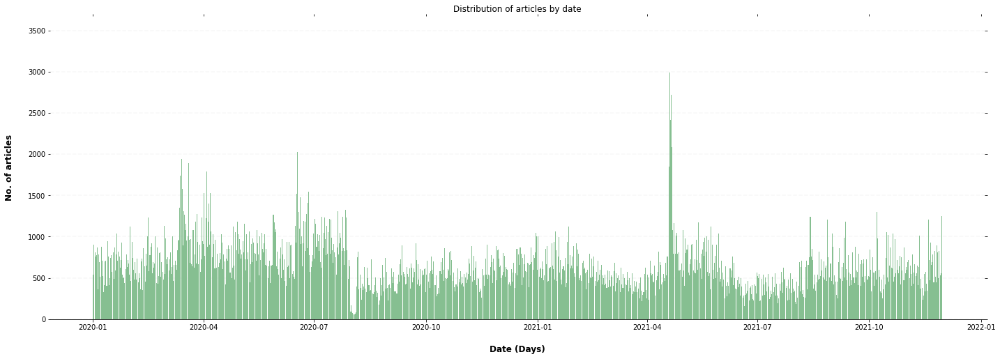

In [ ]:
ax = df_concepts['association_football;premier_league'].hist(column='dateTime', bins=1080, grid=False, figsize=(24,8), color='#86bf91', zorder=2, rwidth=0.9)

ax = ax[0]
for x in ax:

    # Despine
    x.spines['right'].set_visible(False)
    x.spines['top'].set_visible(False)
    x.spines['left'].set_visible(False)

    # Switch off ticks
    x.tick_params(axis="both", which="both", bottom="off", top="off", labelbottom="on", left="off", right="off", labelleft="on")

    # Draw horizontal axis lines
    vals = x.get_yticks()
    for tick in vals:
        x.axhline(y=tick, linestyle='dashed', alpha=0.4, color='#eeeeee', zorder=1)

    # Remove title
    x.set_title("Distribution of articles by date")

    # Set x-axis label
    x.set_xlabel("Date (Days)", labelpad=20, weight='bold', size=12)

    # Set y-axis label
    x.set_ylabel("No. of articles", labelpad=20, weight='bold', size=12)

    # Format y-axis label
    x.yaxis.set_major_formatter(StrMethodFormatter('{x:,g}'))

<AxesSubplot:title={'center':'Article distribution by language'}, ylabel='No. of Articles'>

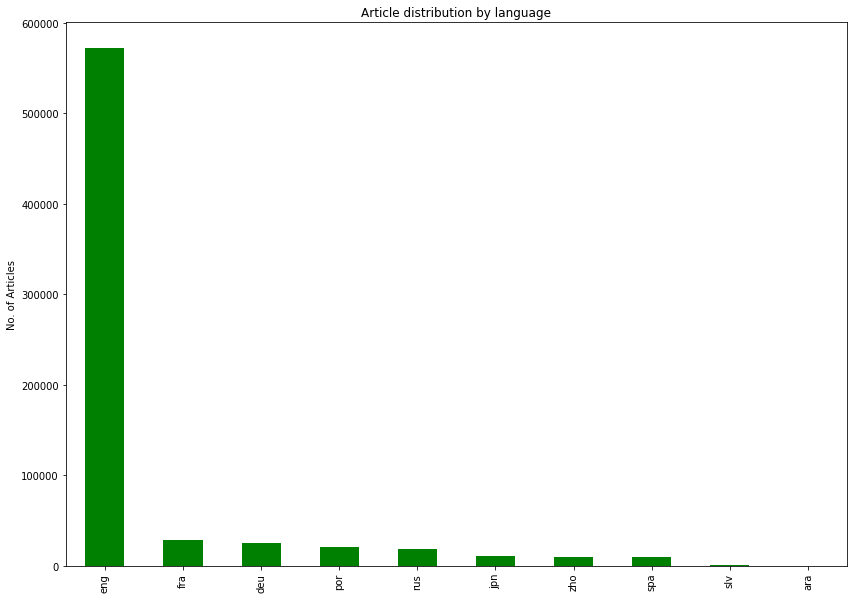

In [ ]:
df_concepts['association_football;premier_league']['lang'].value_counts().plot(kind='bar', title='Article distribution by language', ylabel='No. of Articles', figsize=(14,10), color='green')

<AxesSubplot:title={'center':'Article distribution by source'}, ylabel='No. of Articles'>

/home/matevzm/.local/lib/python3.8/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 12501 (\N{KATAKANA LETTER HU}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/matevzm/.local/lib/python3.8/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 12483 (\N{KATAKANA LETTER SMALL TU}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/matevzm/.local/lib/python3.8/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 12488 (\N{KATAKANA LETTER TO}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/matevzm/.local/lib/python3.8/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 12508 (\N{KATAKANA LETTER BO}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/matevzm/.local/lib/python3.8/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 12540 (\N{KATAKANA-HIRAGANA PROLONGED SOUND MARK}) missing from current font.
  fig.canvas.pri

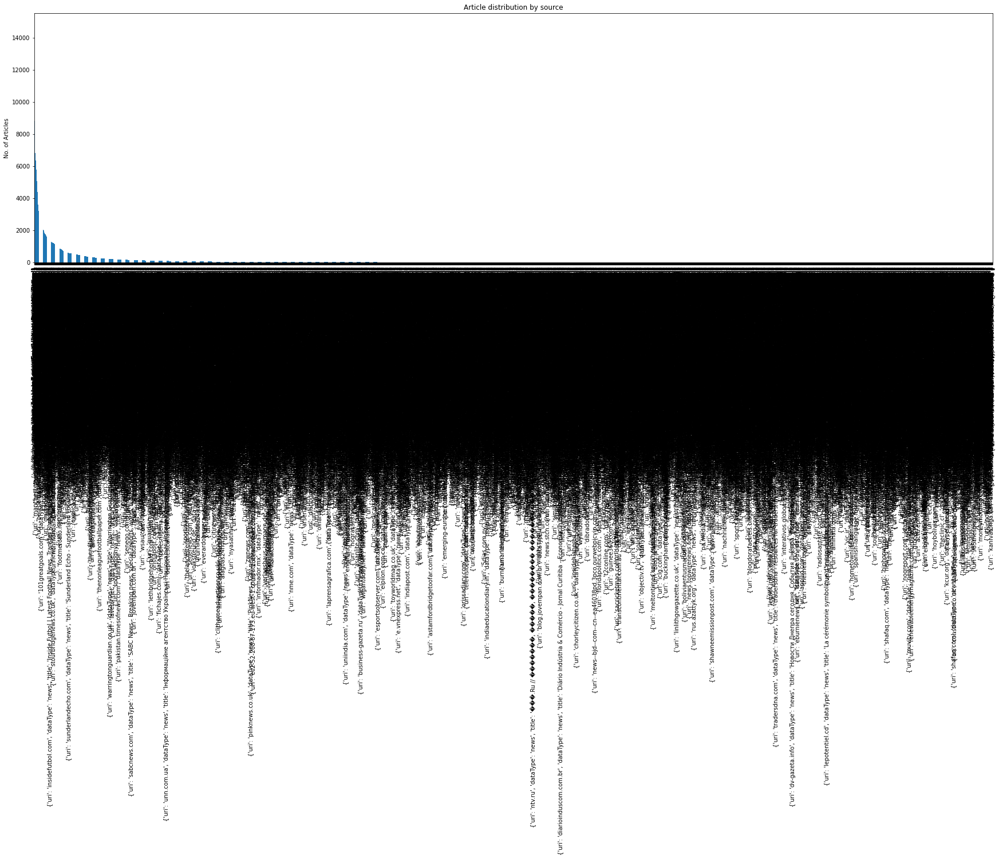

In [ ]:
df_concepts['association_football;premier_league'].source.value_counts().plot(kind='bar', title='Article distribution by source', ylabel='No. of Articles', figsize=(30, 8) )

In [ ]:
df_concepts['association_football;premier_league']['isDuplicate'].value_counts()

False    463507
True     233753
Name: isDuplicate, dtype: int64

In [ ]:
df_concepts['association_football;la_liga']

,concepts,source,eventUri,lang,dateTime,isDuplicate
61,association_football;la_liga,"{'uri': 'fnp.de', 'dataType': 'news', 'title':...",6.081896e+09,deu,2020-05-27 05:31:00,True
62,association_football;la_liga,"{'uri': 'prignitzer.de', 'dataType': 'news', '...",6.082194e+09,deu,2020-05-27 10:18:00,False
63,association_football;la_liga,"{'uri': 'morgenpost.de', 'dataType': 'news', '...",6.082190e+09,deu,2020-05-27 10:24:00,True
64,association_football;la_liga,"{'uri': 'nnn.de', 'dataType': 'news', 'title':...",6.082203e+09,deu,2020-05-27 10:27:00,True
65,association_football;la_liga,"{'uri': 't-online.de', 'dataType': 'news', 'ti...",6.082206e+09,deu,2020-05-27 10:30:00,True
...,...,...,...,...,...,...
2518794,association_football;la_liga,"{'uri': 'observador.pt', 'dataType': 'news', '...",6.049244e+09,por,2020-04-28 21:04:00,False
2518795,association_football;la_liga,"{'uri': 'sicnoticias.pt', 'dataType': 'news', ...",6.049262e+09,por,2020-04-28 21:26:00,False
2518796,association_football;la_liga,"{'uri': 'diariodecuiaba.com.br', 'dataType': '...",6.049272e+09,por,2020-04-28 21:38:00,True
2518797,association_football;la_liga,"{'uri': 'otempo.com.br', 'dataType': 'news', '...",6.049290e+09,por,2020-04-28 21:58:00,True


NameError: name 'StrMethodFormatter' is not defined

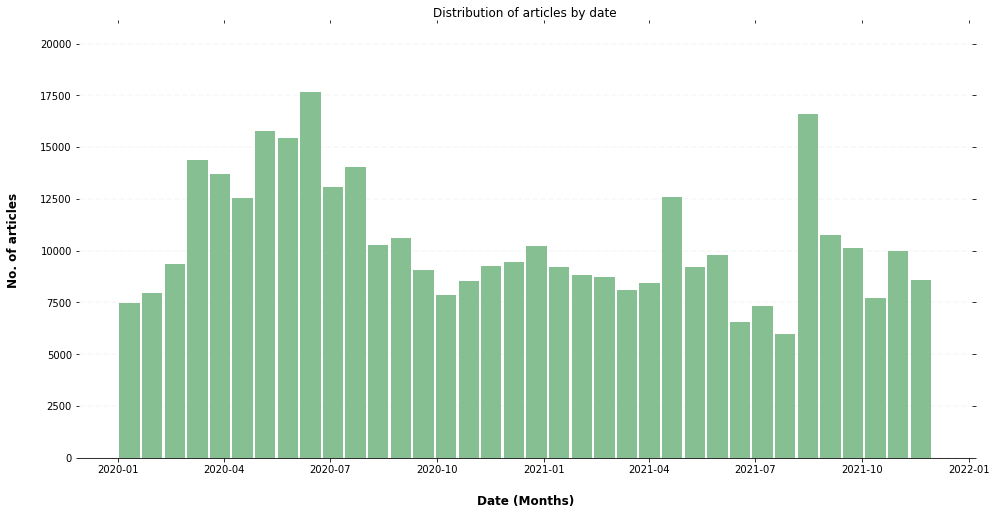

In [ ]:
ax = df_concepts['association_football;la_liga'].hist(column='dateTime', bins=36, grid=False, figsize=(16,8), color='#86bf91', zorder=2, rwidth=0.9)

ax = ax[0]
for x in ax:

    # Despine
    x.spines['right'].set_visible(False)
    x.spines['top'].set_visible(False)
    x.spines['left'].set_visible(False)

    # Switch off ticks
    x.tick_params(axis="both", which="both", bottom="off", top="off", labelbottom="on", left="off", right="off", labelleft="on")

    # Draw horizontal axis lines
    vals = x.get_yticks()
    for tick in vals:
        x.axhline(y=tick, linestyle='dashed', alpha=0.4, color='#eeeeee', zorder=1)

    # Remove title
    x.set_title("Distribution of articles by date")

    # Set x-axis label
    x.set_xlabel("Date (Months)", labelpad=20, weight='bold', size=12)

    # Set y-axis label
    x.set_ylabel("No. of articles", labelpad=20, weight='bold', size=12)

    # Format y-axis label
    x.yaxis.set_major_formatter(StrMethodFormatter('{x:,g}'))

NameError: name 'StrMethodFormatter' is not defined

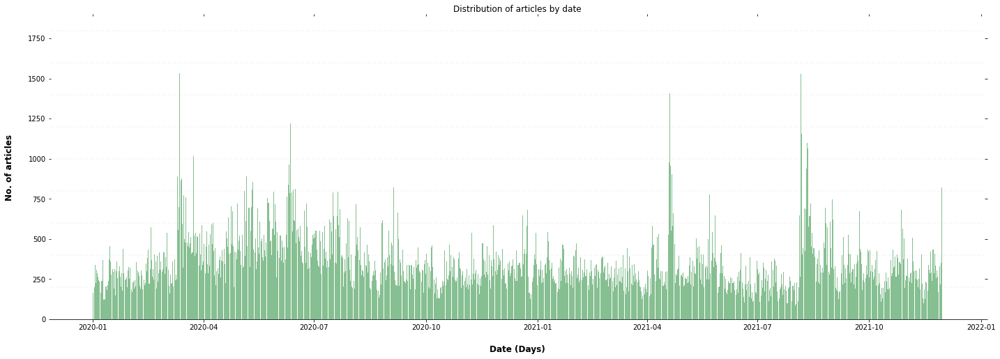

In [ ]:
ax = df_concepts['association_football;la_liga'].hist(column='dateTime', bins=1080, grid=False, figsize=(24,8), color='#86bf91', zorder=2, rwidth=0.9)

ax = ax[0]
for x in ax:

    # Despine
    x.spines['right'].set_visible(False)
    x.spines['top'].set_visible(False)
    x.spines['left'].set_visible(False)

    # Switch off ticks
    x.tick_params(axis="both", which="both", bottom="off", top="off", labelbottom="on", left="off", right="off", labelleft="on")

    # Draw horizontal axis lines
    vals = x.get_yticks()
    for tick in vals:
        x.axhline(y=tick, linestyle='dashed', alpha=0.4, color='#eeeeee', zorder=1)

    # Remove title
    x.set_title("Distribution of articles by date")

    # Set x-axis label
    x.set_xlabel("Date (Days)", labelpad=20, weight='bold', size=12)

    # Set y-axis label
    x.set_ylabel("No. of articles", labelpad=20, weight='bold', size=12)

    # Format y-axis label
    x.yaxis.set_major_formatter(StrMethodFormatter('{x:,g}'))

<AxesSubplot:title={'center':'Article distribution by language'}, ylabel='No. of Articles'>

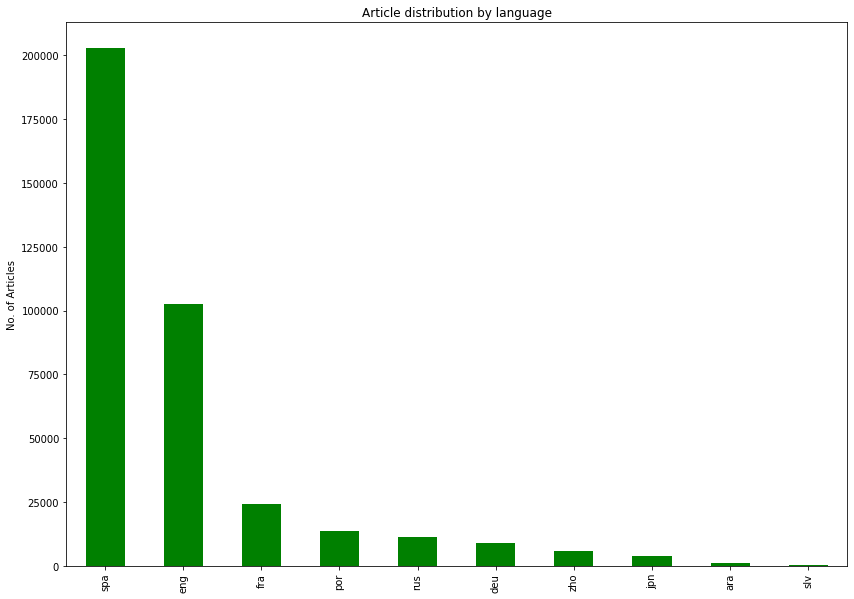

In [ ]:
df_concepts['association_football;la_liga']['lang'].value_counts().plot(kind='bar', title='Article distribution by language', ylabel='No. of Articles', figsize=(14,10), color='green')

<AxesSubplot:title={'center':'Article distribution by source'}, ylabel='No. of Articles'>

/home/matevzm/.local/lib/python3.8/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 12501 (\N{KATAKANA LETTER HU}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/matevzm/.local/lib/python3.8/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 12483 (\N{KATAKANA LETTER SMALL TU}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/matevzm/.local/lib/python3.8/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 12488 (\N{KATAKANA LETTER TO}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/matevzm/.local/lib/python3.8/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 12508 (\N{KATAKANA LETTER BO}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/matevzm/.local/lib/python3.8/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 12540 (\N{KATAKANA-HIRAGANA PROLONGED SOUND MARK}) missing from current font.
  fig.canvas.pri

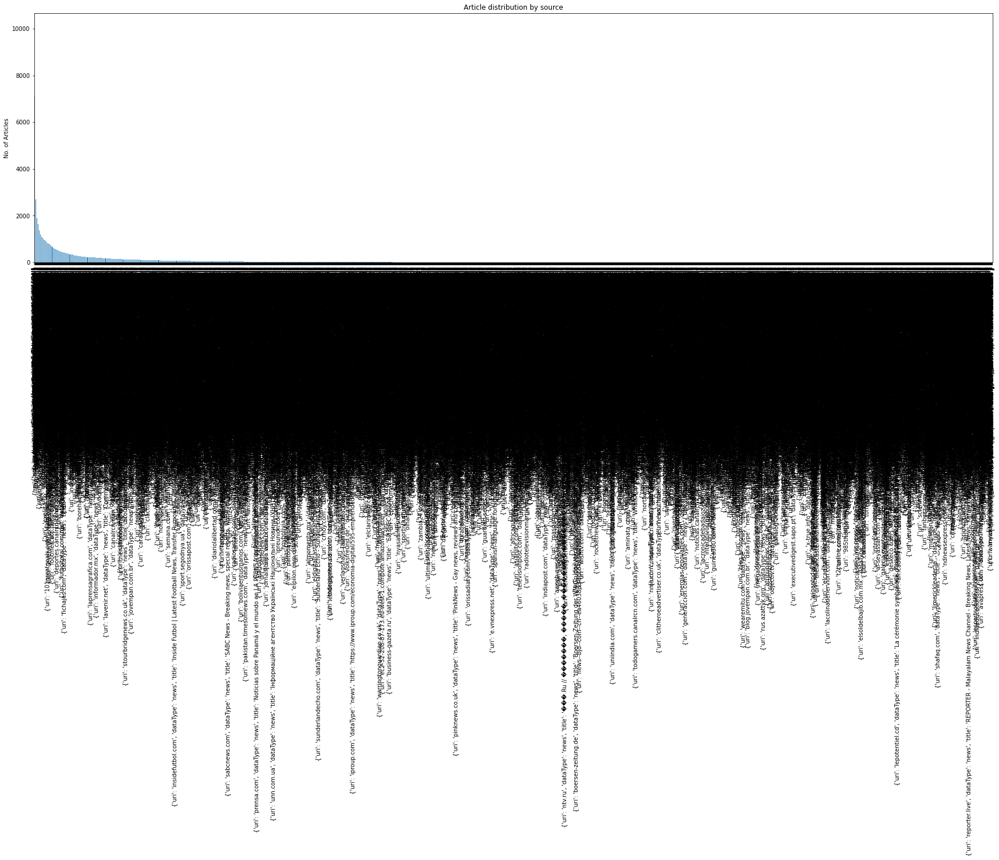

In [ ]:
df_concepts['association_football;la_liga'].source.value_counts().plot(kind='bar', title='Article distribution by source', ylabel='No. of Articles', figsize=(30, 8) )

In [ ]:
df_concepts['association_football;la_liga']['isDuplicate'].value_counts()

False    292423
True      82938
Name: isDuplicate, dtype: int64

In [ ]:
df_concepts['basketball;nba']

,concepts,source,eventUri,lang,dateTime,isDuplicate
245,basketball;nba,"{'uri': 'otz.de', 'dataType': 'news', 'title':...",NaN,deu,2020-05-27 09:46:00,False
246,basketball;nba,"{'uri': 'tlz.de', 'dataType': 'news', 'title':...",NaN,deu,2020-05-27 09:52:00,False
247,basketball;nba,"{'uri': 'thueringer-allgemeine.de', 'dataType'...",NaN,deu,2020-05-27 10:23:00,False
248,basketball;nba,"{'uri': 'wp.de', 'dataType': 'news', 'title': ...",NaN,deu,2020-05-27 12:17:00,False
249,basketball;nba,"{'uri': 'wr.de', 'dataType': 'news', 'title': ...",NaN,deu,2020-05-27 12:23:00,False
...,...,...,...,...,...,...
2519041,basketball;nba,"{'uri': 'espn.com.br', 'dataType': 'news', 'ti...",6.049122e+09,por,2020-04-28 18:41:00,False
2519042,basketball;nba,"{'uri': 'jornalcidade.net', 'dataType': 'news'...",6.049141e+09,por,2020-04-28 19:04:00,True
2519043,basketball;nba,"{'uri': 'cmjornal.pt', 'dataType': 'news', 'ti...",6.049176e+09,por,2020-04-28 19:44:00,False
2519044,basketball;nba,"{'uri': 'uol.com.br', 'dataType': 'news', 'tit...",6.049232e+09,por,2020-04-28 20:49:00,False


NameError: name 'StrMethodFormatter' is not defined

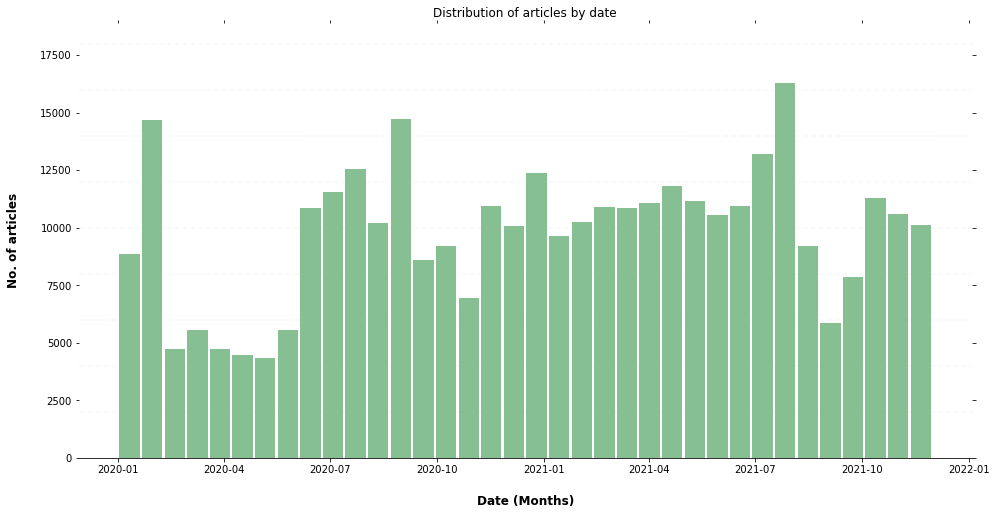

In [ ]:
ax = df_concepts['basketball;nba'].hist(column='dateTime', bins=36, grid=False, figsize=(16,8), color='#86bf91', zorder=2, rwidth=0.9)

ax = ax[0]
for x in ax:

    # Despine
    x.spines['right'].set_visible(False)
    x.spines['top'].set_visible(False)
    x.spines['left'].set_visible(False)

    # Switch off ticks
    x.tick_params(axis="both", which="both", bottom="off", top="off", labelbottom="on", left="off", right="off", labelleft="on")

    # Draw horizontal axis lines
    vals = x.get_yticks()
    for tick in vals:
        x.axhline(y=tick, linestyle='dashed', alpha=0.4, color='#eeeeee', zorder=1)

    # Remove title
    x.set_title("Distribution of articles by date")

    # Set x-axis label
    x.set_xlabel("Date (Months)", labelpad=20, weight='bold', size=12)

    # Set y-axis label
    x.set_ylabel("No. of articles", labelpad=20, weight='bold', size=12)

    # Format y-axis label
    x.yaxis.set_major_formatter(StrMethodFormatter('{x:,g}'))

NameError: name 'StrMethodFormatter' is not defined

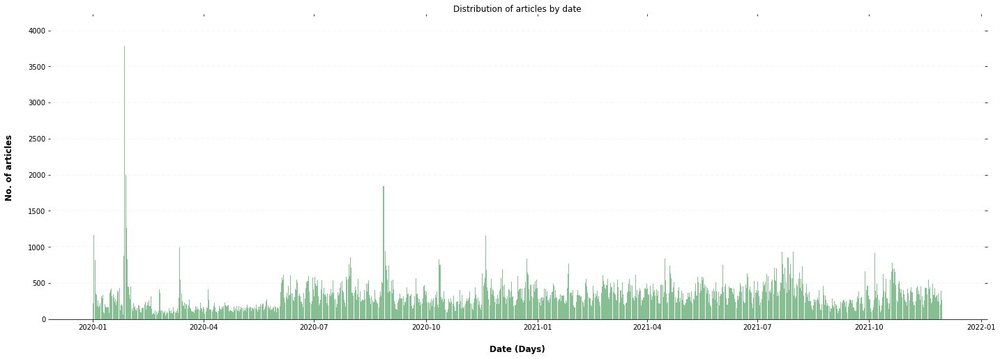

In [ ]:
ax = df_concepts['basketball;nba'].hist(column='dateTime', bins=1080, grid=False, figsize=(24,8), color='#86bf91', zorder=2, rwidth=0.9)

ax = ax[0]
for x in ax:

    # Despine
    x.spines['right'].set_visible(False)
    x.spines['top'].set_visible(False)
    x.spines['left'].set_visible(False)

    # Switch off ticks
    x.tick_params(axis="both", which="both", bottom="off", top="off", labelbottom="on", left="off", right="off", labelleft="on")

    # Draw horizontal axis lines
    vals = x.get_yticks()
    for tick in vals:
        x.axhline(y=tick, linestyle='dashed', alpha=0.4, color='#eeeeee', zorder=1)

    # Remove title
    x.set_title("Distribution of articles by date")

    # Set x-axis label
    x.set_xlabel("Date (Days)", labelpad=20, weight='bold', size=12)

    # Set y-axis label
    x.set_ylabel("No. of articles", labelpad=20, weight='bold', size=12)

    # Format y-axis label
    x.yaxis.set_major_formatter(StrMethodFormatter('{x:,g}'))

<AxesSubplot:title={'center':'Article distribution by language'}, ylabel='No. of Articles'>

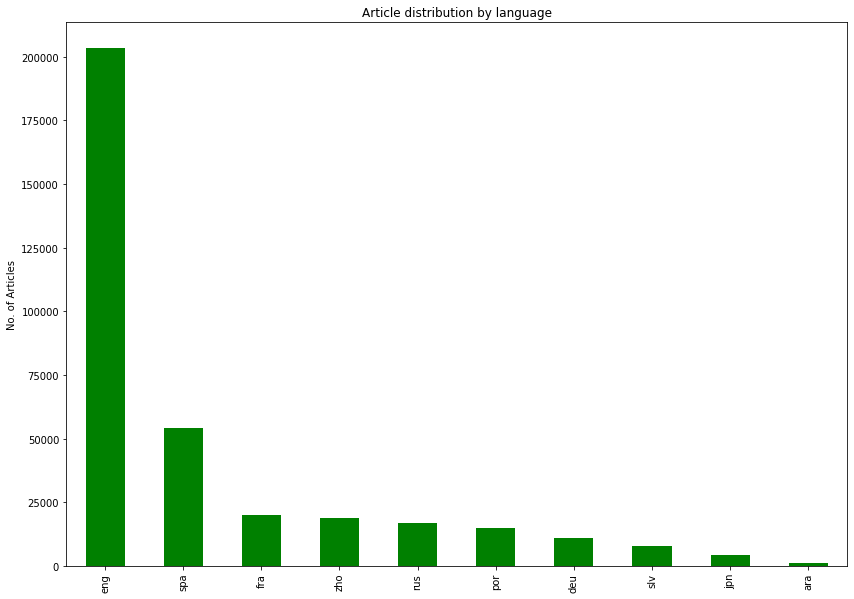

In [ ]:
df_concepts['basketball;nba']['lang'].value_counts().plot(kind='bar', title='Article distribution by language', ylabel='No. of Articles', figsize=(14,10), color='green')

<AxesSubplot:title={'center':'Article distribution by source'}, ylabel='No. of Articles'>

/home/matevzm/.local/lib/python3.8/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 22855 (\N{CJK UNIFIED IDEOGRAPH-5947}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/matevzm/.local/lib/python3.8/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 25705 (\N{CJK UNIFIED IDEOGRAPH-6469}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/matevzm/.local/lib/python3.8/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 26032 (\N{CJK UNIFIED IDEOGRAPH-65B0}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/matevzm/.local/lib/python3.8/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 32862 (\N{CJK UNIFIED IDEOGRAPH-805E}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/matevzm/.local/lib/python3.8/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 33258 (\N{CJK UNIFIED IDEOGRAPH-81EA}) missing from current font.
  

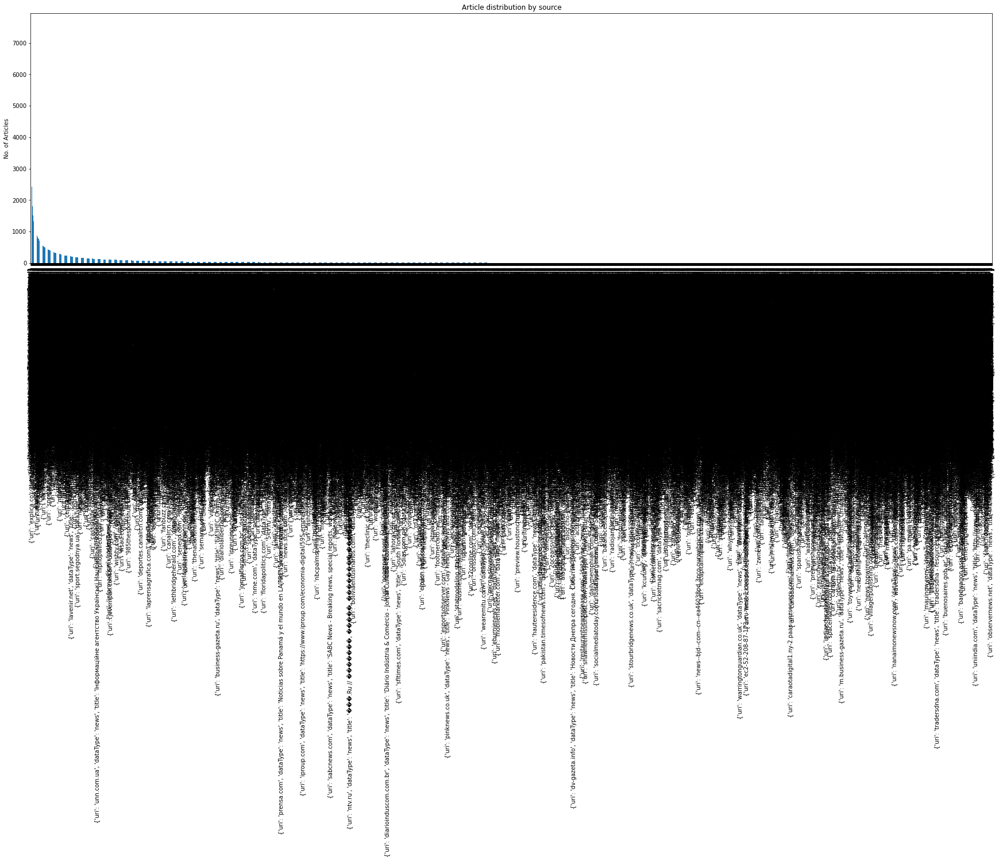

In [ ]:
df_concepts['basketball;nba'].source.value_counts().plot(kind='bar', title='Article distribution by source', ylabel='No. of Articles', figsize=(30, 8) )

In [ ]:
df_concepts['basketball;nba']['isDuplicate'].value_counts()

False    267688
True      84948
Name: isDuplicate, dtype: int64

In [ ]:
df_concepts['association_football;bundesliga']

,concepts,source,eventUri,lang,dateTime,isDuplicate
4589,association_football;bundesliga,"{'uri': 'hz.de', 'dataType': 'news', 'title': ...",6.557982e+09,deu,2021-05-12 01:05:00,False
4590,association_football;bundesliga,"{'uri': 'op-online.de', 'dataType': 'news', 't...",6.557983e+09,deu,2021-05-12 01:06:00,False
4591,association_football;bundesliga,"{'uri': 'wienerzeitung.at', 'dataType': 'news'...",6.558148e+09,deu,2021-05-12 04:37:00,False
4592,association_football;bundesliga,"{'uri': 'welt.de', 'dataType': 'news', 'title'...",6.558201e+09,deu,2021-05-12 05:33:00,False
4593,association_football;bundesliga,"{'uri': 'abendzeitung-muenchen.de', 'dataType'...",6.558250e+09,deu,2021-05-12 06:20:00,False
...,...,...,...,...,...,...
2517512,association_football;bundesliga,"{'uri': 'terra.com.br', 'dataType': 'news', 't...",6.280831e+09,por,2020-11-03 14:37:00,False
2517513,association_football;bundesliga,"{'uri': 'lance.com.br', 'dataType': 'news', 't...",6.280995e+09,por,2020-11-03 16:58:00,False
2517514,association_football;bundesliga,"{'uri': 'terra.com.br', 'dataType': 'news', 't...",6.281004e+09,por,2020-11-03 17:05:00,False
2517515,association_football;bundesliga,"{'uri': 'uol.com.br', 'dataType': 'news', 'tit...",6.281010e+09,por,2020-11-03 17:11:00,True


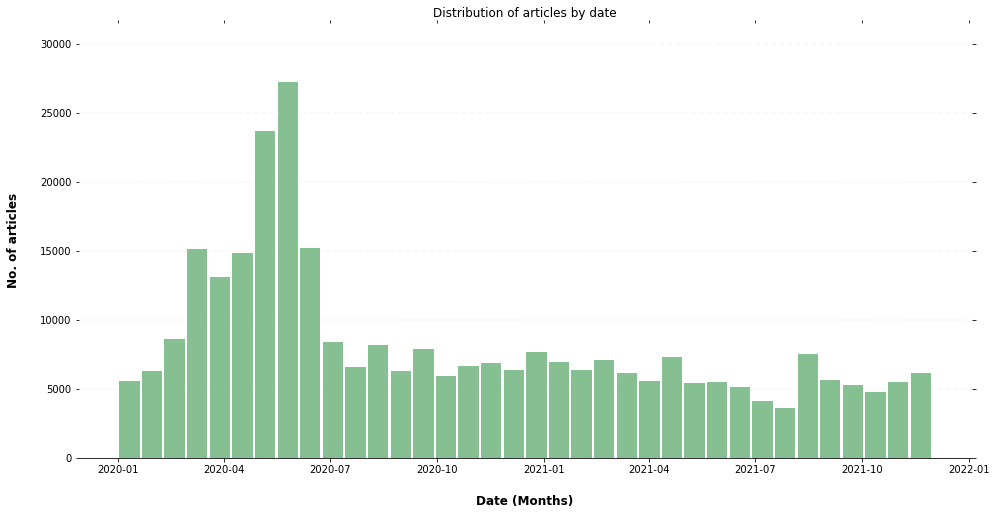

In [ ]:
ax = df_concepts['association_football;bundesliga'].hist(column='dateTime', bins=36, grid=False, figsize=(16,8), color='#86bf91', zorder=2, rwidth=0.9)

ax = ax[0]
for x in ax:

    # Despine
    x.spines['right'].set_visible(False)
    x.spines['top'].set_visible(False)
    x.spines['left'].set_visible(False)

    # Switch off ticks
    x.tick_params(axis="both", which="both", bottom="off", top="off", labelbottom="on", left="off", right="off", labelleft="on")

    # Draw horizontal axis lines
    vals = x.get_yticks()
    for tick in vals:
        x.axhline(y=tick, linestyle='dashed', alpha=0.4, color='#eeeeee', zorder=1)

    # Remove title
    x.set_title("Distribution of articles by date")

    # Set x-axis label
    x.set_xlabel("Date (Months)", labelpad=20, weight='bold', size=12)

    # Set y-axis label
    x.set_ylabel("No. of articles", labelpad=20, weight='bold', size=12)

   

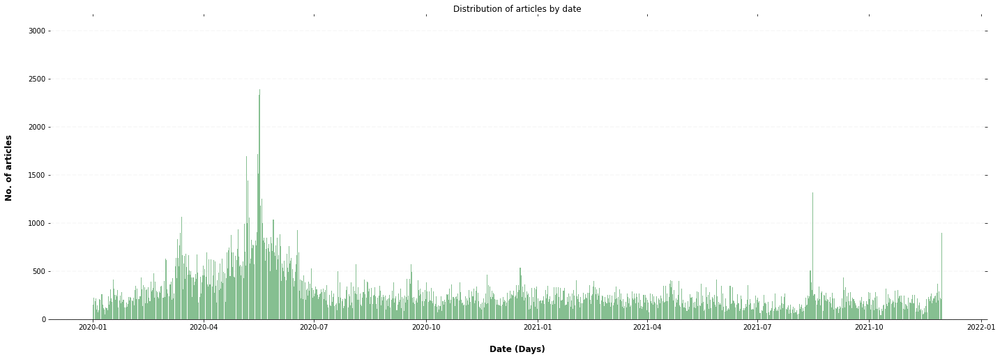

In [ ]:
ax = df_concepts['association_football;bundesliga'].hist(column='dateTime', bins=1080, grid=False, figsize=(24,8), color='#86bf91', zorder=2, rwidth=0.9)

ax = ax[0]
for x in ax:

    # Despine
    x.spines['right'].set_visible(False)
    x.spines['top'].set_visible(False)
    x.spines['left'].set_visible(False)

    # Switch off ticks
    x.tick_params(axis="both", which="both", bottom="off", top="off", labelbottom="on", left="off", right="off", labelleft="on")

    # Draw horizontal axis lines
    vals = x.get_yticks()
    for tick in vals:
        x.axhline(y=tick, linestyle='dashed', alpha=0.4, color='#eeeeee', zorder=1)

    # Remove title
    x.set_title("Distribution of articles by date")

    # Set x-axis label
    x.set_xlabel("Date (Days)", labelpad=20, weight='bold', size=12)

    # Set y-axis label
    x.set_ylabel("No. of articles", labelpad=20, weight='bold', size=12)

    

<AxesSubplot:title={'center':'Article distribution by language'}, ylabel='No. of Articles'>

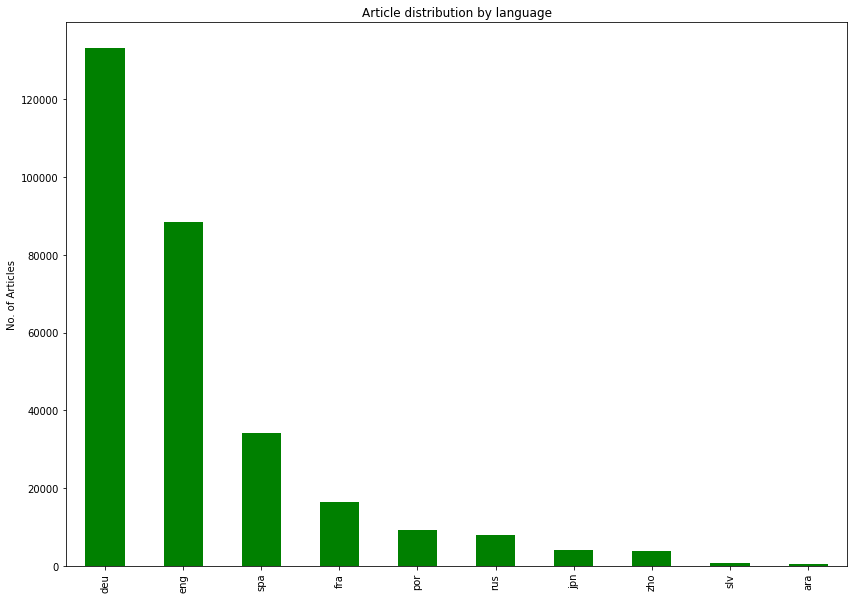

In [ ]:
df_concepts['association_football;bundesliga']['lang'].value_counts().plot(kind='bar', title='Article distribution by language', ylabel='No. of Articles', figsize=(14,10), color='green')

<AxesSubplot:title={'center':'Article distribution by source'}, ylabel='No. of Articles'>

/home/matevzm/.local/lib/python3.8/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 12501 (\N{KATAKANA LETTER HU}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/matevzm/.local/lib/python3.8/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 12483 (\N{KATAKANA LETTER SMALL TU}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/matevzm/.local/lib/python3.8/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 12488 (\N{KATAKANA LETTER TO}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/matevzm/.local/lib/python3.8/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 12508 (\N{KATAKANA LETTER BO}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/matevzm/.local/lib/python3.8/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 12540 (\N{KATAKANA-HIRAGANA PROLONGED SOUND MARK}) missing from current font.
  fig.canvas.pri

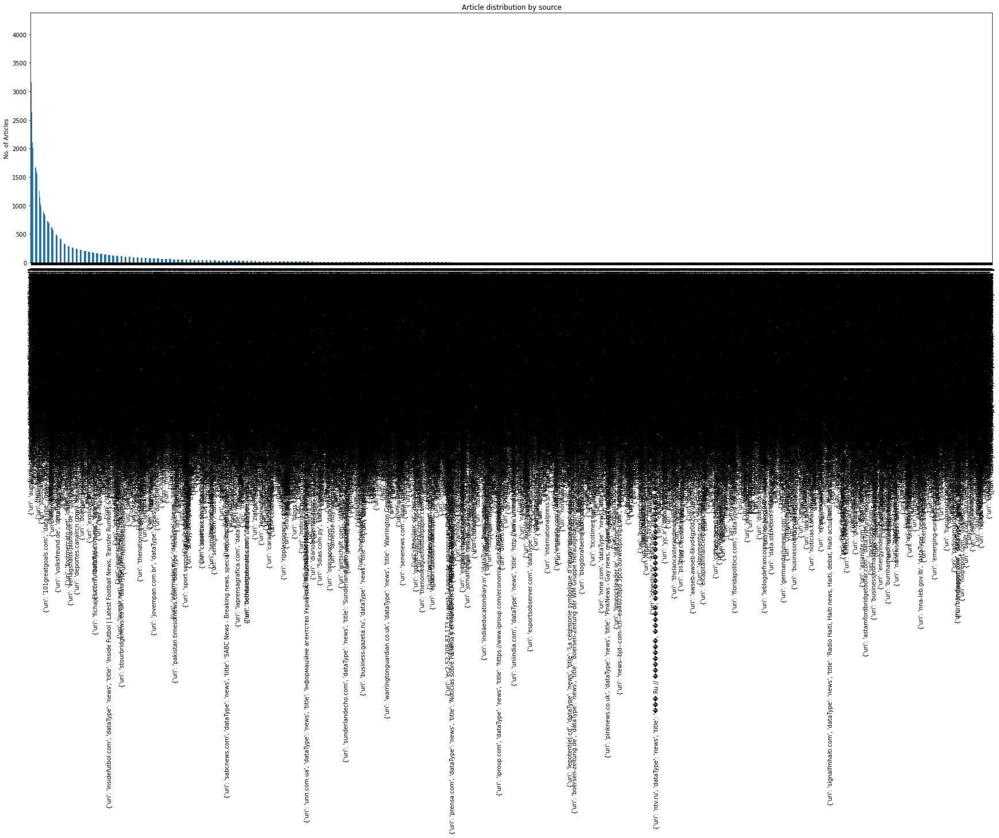

In [ ]:
df_concepts['association_football;bundesliga'].source.value_counts().plot(kind='bar', title='Article distribution by source', ylabel='No. of Articles', figsize=(30, 8) )

In [ ]:
df_concepts['association_football;bundesliga']['isDuplicate'].value_counts()

False    186828
True     111486
Name: isDuplicate, dtype: int64

In [ ]:
df_concepts['association_football;UEFA_europa_league']

,concepts,source,eventUri,lang,dateTime,isDuplicate
398,association_football;UEFA_europa_league,"{'uri': 'spox.com', 'dataType': 'news', 'title...",6.401703e+09,deu,2021-01-23 00:06:00,False
399,association_football;UEFA_europa_league,"{'uri': 'spox.com', 'dataType': 'news', 'title...",6.402002e+09,deu,2021-01-23 07:01:00,False
400,association_football;UEFA_europa_league,"{'uri': 'spox.com', 'dataType': 'news', 'title...",6.402073e+09,deu,2021-01-23 08:24:00,False
401,association_football;UEFA_europa_league,"{'uri': 'stern.de', 'dataType': 'news', 'title...",6.402104e+09,deu,2021-01-23 08:59:00,False
402,association_football;UEFA_europa_league,"{'uri': 'tz.de', 'dataType': 'news', 'title': ...",6.402104e+09,deu,2021-01-23 09:00:00,False
...,...,...,...,...,...,...
2518041,association_football;UEFA_europa_league,"{'uri': 'esportes.r7.com', 'dataType': 'news',...",6.451566e+09,por,2021-02-26 19:29:00,False
2518042,association_football;UEFA_europa_league,"{'uri': 'istoe.com.br', 'dataType': 'news', 't...",6.451595e+09,por,2021-02-26 19:57:00,False
2518043,association_football;UEFA_europa_league,"{'uri': 'veja.abril.com.br', 'dataType': 'news...",6.451619e+09,por,2021-02-26 20:21:00,False
2518044,association_football;UEFA_europa_league,"{'uri': 'rfi.fr', 'dataType': 'news', 'title':...",6.451671e+09,por,2021-02-26 21:15:00,False


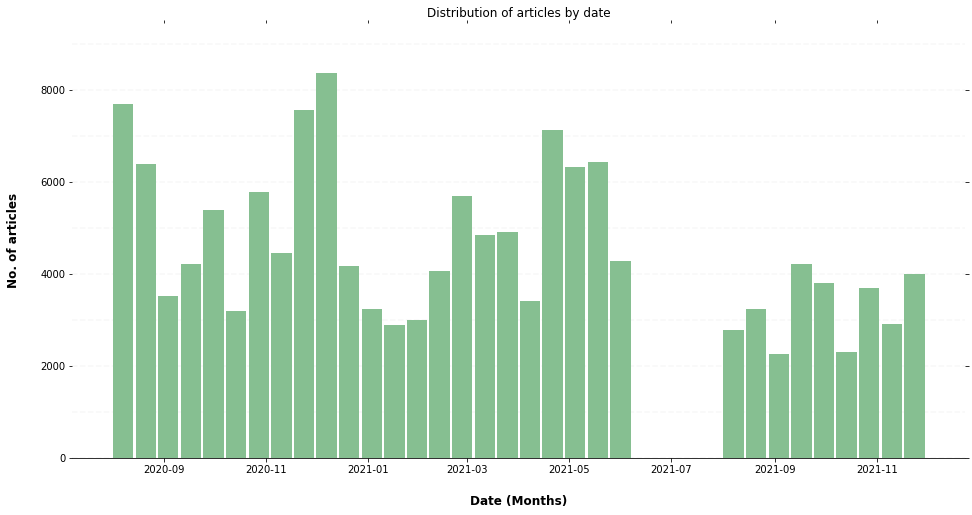

In [ ]:
ax = df_concepts['association_football;UEFA_europa_league'].hist(column='dateTime', bins=36, grid=False, figsize=(16,8), color='#86bf91', zorder=2, rwidth=0.9)

ax = ax[0]
for x in ax:

    # Despine
    x.spines['right'].set_visible(False)
    x.spines['top'].set_visible(False)
    x.spines['left'].set_visible(False)

    # Switch off ticks
    x.tick_params(axis="both", which="both", bottom="off", top="off", labelbottom="on", left="off", right="off", labelleft="on")

    # Draw horizontal axis lines
    vals = x.get_yticks()
    for tick in vals:
        x.axhline(y=tick, linestyle='dashed', alpha=0.4, color='#eeeeee', zorder=1)

    # Remove title
    x.set_title("Distribution of articles by date")

    # Set x-axis label
    x.set_xlabel("Date (Months)", labelpad=20, weight='bold', size=12)

    # Set y-axis label
    x.set_ylabel("No. of articles", labelpad=20, weight='bold', size=12)



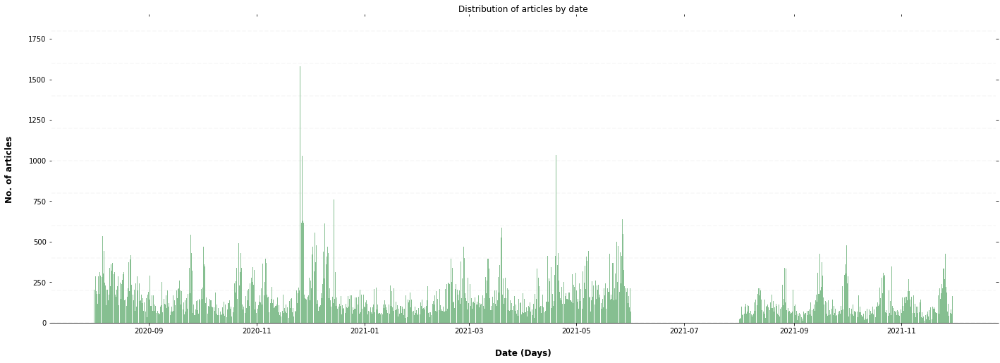

In [ ]:
ax = df_concepts['association_football;UEFA_europa_league'].hist(column='dateTime', bins=1080, grid=False, figsize=(24,8), color='#86bf91', zorder=2, rwidth=0.9)

ax = ax[0]
for x in ax:

    # Despine
    x.spines['right'].set_visible(False)
    x.spines['top'].set_visible(False)
    x.spines['left'].set_visible(False)

    # Switch off ticks
    x.tick_params(axis="both", which="both", bottom="off", top="off", labelbottom="on", left="off", right="off", labelleft="on")

    # Draw horizontal axis lines
    vals = x.get_yticks()
    for tick in vals:
        x.axhline(y=tick, linestyle='dashed', alpha=0.4, color='#eeeeee', zorder=1)

    # Remove title
    x.set_title("Distribution of articles by date")

    # Set x-axis label
    x.set_xlabel("Date (Days)", labelpad=20, weight='bold', size=12)

    # Set y-axis label
    x.set_ylabel("No. of articles", labelpad=20, weight='bold', size=12)


<AxesSubplot:title={'center':'Article distribution by language'}, ylabel='No. of Articles'>

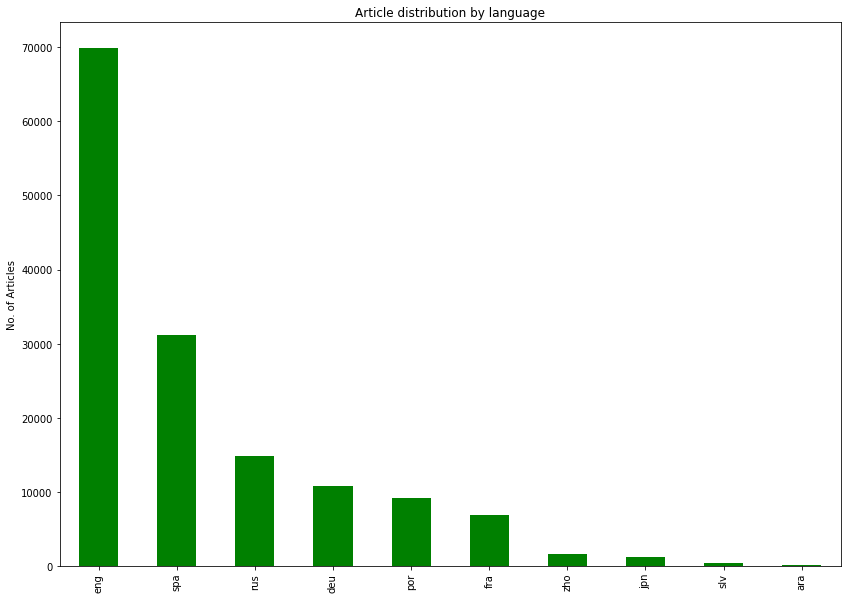

In [ ]:
df_concepts['association_football;UEFA_europa_league']['lang'].value_counts().plot(kind='bar', title='Article distribution by language', ylabel='No. of Articles', figsize=(14,10), color='green')

<AxesSubplot:title={'center':'Article distribution by source'}, ylabel='No. of Articles'>

/home/matevzm/.local/lib/python3.8/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 12501 (\N{KATAKANA LETTER HU}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/matevzm/.local/lib/python3.8/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 12483 (\N{KATAKANA LETTER SMALL TU}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/matevzm/.local/lib/python3.8/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 12488 (\N{KATAKANA LETTER TO}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/matevzm/.local/lib/python3.8/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 12508 (\N{KATAKANA LETTER BO}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/matevzm/.local/lib/python3.8/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 12540 (\N{KATAKANA-HIRAGANA PROLONGED SOUND MARK}) missing from current font.
  fig.canvas.pri

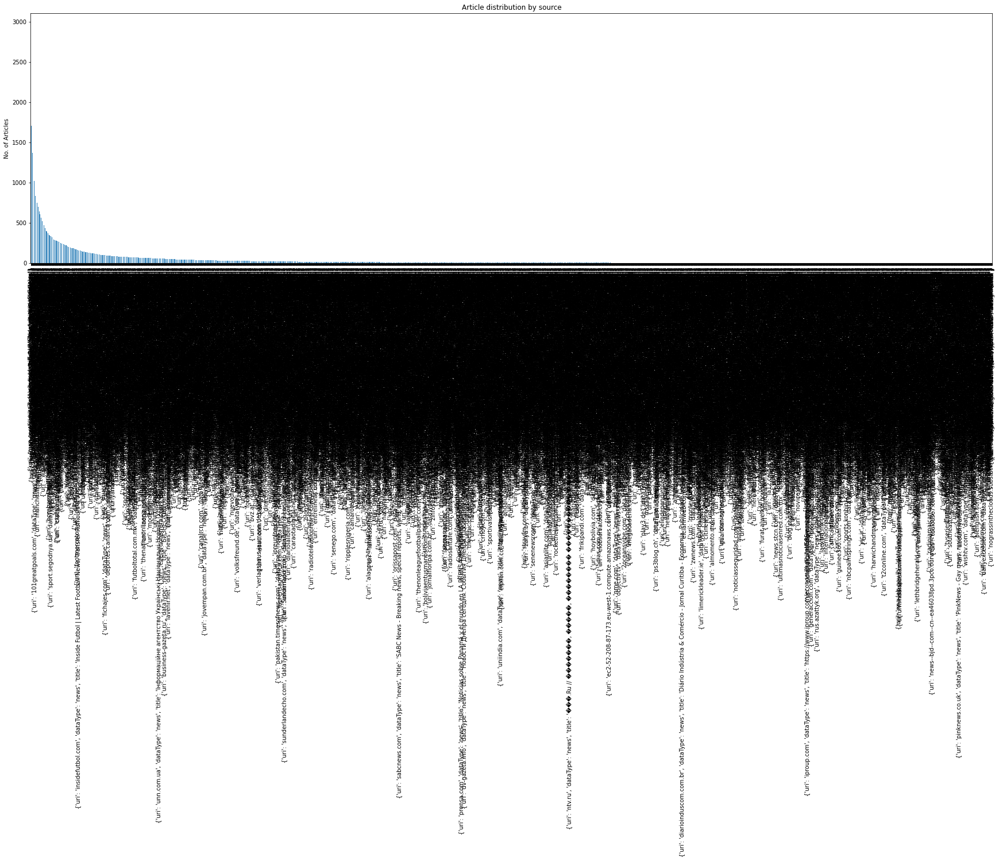

In [ ]:
df_concepts['association_football;UEFA_europa_league'].source.value_counts().plot(kind='bar', title='Article distribution by source', ylabel='No. of Articles', figsize=(30, 8) )

In [ ]:
df_concepts['association_football;UEFA_europa_league']['isDuplicate'].value_counts()

False    109297
True      36763
Name: isDuplicate, dtype: int64

In [ ]:
df_concepts['european_migrant_crisis']

,concepts,source,eventUri,lang,dateTime,isDuplicate
1373,european_migrant_crisis,"{'uri': 'ad-hoc-news.de', 'dataType': 'news', ...",6.577629e+09,deu,2021-05-26 00:42:00,False
1374,european_migrant_crisis,"{'uri': 'ad-hoc-news.de', 'dataType': 'news', ...",6.577630e+09,deu,2021-05-26 00:42:00,False
1375,european_migrant_crisis,"{'uri': 'ad-hoc-news.de', 'dataType': 'news', ...",6.577630e+09,deu,2021-05-26 00:42:00,False
1376,european_migrant_crisis,"{'uri': 'mz.de', 'dataType': 'news', 'title': ...",6.577805e+09,deu,2021-05-26 04:35:00,True
1377,european_migrant_crisis,"{'uri': 'rnd.de', 'dataType': 'news', 'title':...",6.577849e+09,deu,2021-05-26 05:21:00,True
...,...,...,...,...,...,...
2518895,european_migrant_crisis,"{'uri': 'istoe.com.br', 'dataType': 'news', 't...",1.472853e+09,por,2020-03-06 02:36:00,True
2518896,european_migrant_crisis,"{'uri': 'tvi24.iol.pt', 'dataType': 'news', 't...",1.475976e+09,por,2020-03-08 21:55:00,False
2518897,european_migrant_crisis,"{'uri': 'wort.lu', 'dataType': 'news', 'title'...",1.476881e+09,por,2020-03-09 15:08:00,False
2518898,european_migrant_crisis,"{'uri': 'tsf.pt', 'dataType': 'news', 'title':...",1.477794e+09,por,2020-03-10 08:36:00,False


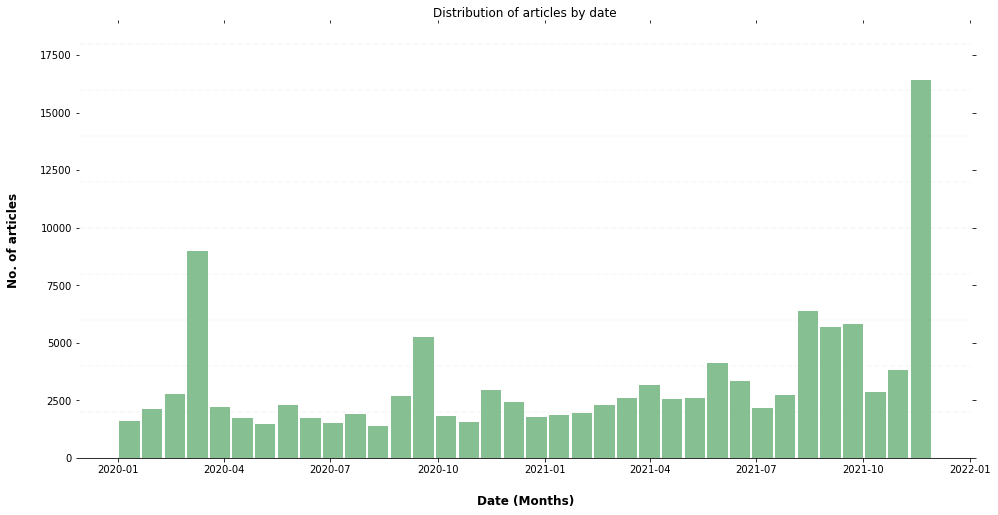

In [ ]:
ax = df_concepts['european_migrant_crisis'].hist(column='dateTime', bins=36, grid=False, figsize=(16,8), color='#86bf91', zorder=2, rwidth=0.9)

ax = ax[0]
for x in ax:

    # Despine
    x.spines['right'].set_visible(False)
    x.spines['top'].set_visible(False)
    x.spines['left'].set_visible(False)

    # Switch off ticks
    x.tick_params(axis="both", which="both", bottom="off", top="off", labelbottom="on", left="off", right="off", labelleft="on")

    # Draw horizontal axis lines
    vals = x.get_yticks()
    for tick in vals:
        x.axhline(y=tick, linestyle='dashed', alpha=0.4, color='#eeeeee', zorder=1)

    # Remove title
    x.set_title("Distribution of articles by date")

    # Set x-axis label
    x.set_xlabel("Date (Months)", labelpad=20, weight='bold', size=12)

    # Set y-axis label
    x.set_ylabel("No. of articles", labelpad=20, weight='bold', size=12)

   

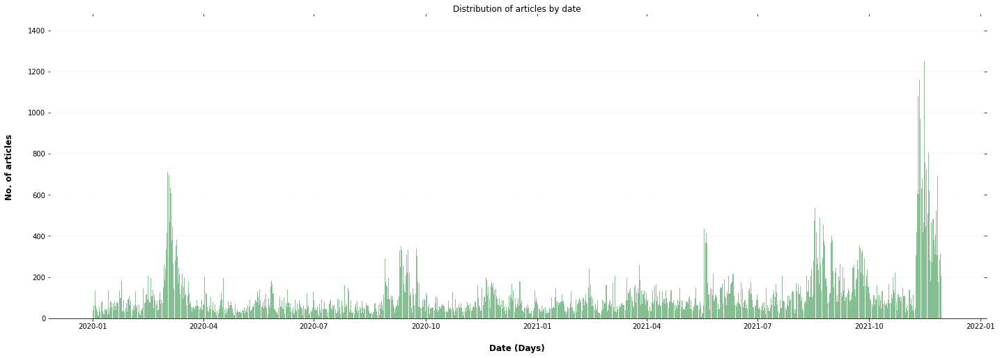

In [ ]:
ax = df_concepts['european_migrant_crisis'].hist(column='dateTime', bins=1080, grid=False, figsize=(24,8), color='#86bf91', zorder=2, rwidth=0.9)

ax = ax[0]
for x in ax:

    # Despine
    x.spines['right'].set_visible(False)
    x.spines['top'].set_visible(False)
    x.spines['left'].set_visible(False)

    # Switch off ticks
    x.tick_params(axis="both", which="both", bottom="off", top="off", labelbottom="on", left="off", right="off", labelleft="on")

    # Draw horizontal axis lines
    vals = x.get_yticks()
    for tick in vals:
        x.axhline(y=tick, linestyle='dashed', alpha=0.4, color='#eeeeee', zorder=1)

    # Remove title
    x.set_title("Distribution of articles by date")

    # Set x-axis label
    x.set_xlabel("Date (Days)", labelpad=20, weight='bold', size=12)

    # Set y-axis label
    x.set_ylabel("No. of articles", labelpad=20, weight='bold', size=12)

  

<AxesSubplot:title={'center':'Article distribution by language'}, ylabel='No. of Articles'>

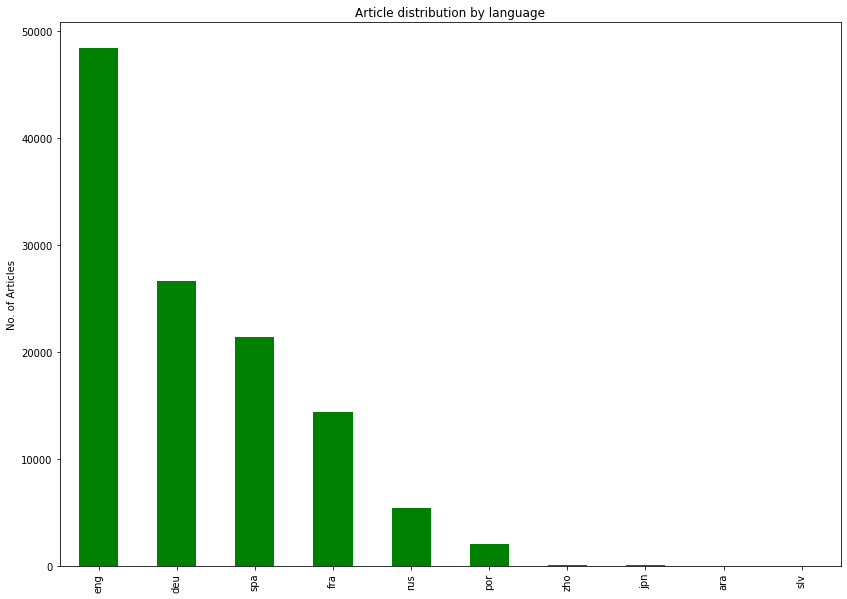

In [ ]:
df_concepts['european_migrant_crisis']['lang'].value_counts().plot(kind='bar', title='Article distribution by language', ylabel='No. of Articles', figsize=(14,10), color='green')

<AxesSubplot:title={'center':'Article distribution by source'}, ylabel='No. of Articles'>

/home/matevzm/.local/lib/python3.8/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 20013 (\N{CJK UNIFIED IDEOGRAPH-4E2D}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/matevzm/.local/lib/python3.8/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 22269 (\N{CJK UNIFIED IDEOGRAPH-56FD}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/matevzm/.local/lib/python3.8/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 32593 (\N{CJK UNIFIED IDEOGRAPH-7F51}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/matevzm/.local/lib/python3.8/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 27598 (\N{CJK UNIFIED IDEOGRAPH-6BCE}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/matevzm/.local/lib/python3.8/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 26085 (\N{CJK UNIFIED IDEOGRAPH-65E5}) missing from current font.
  

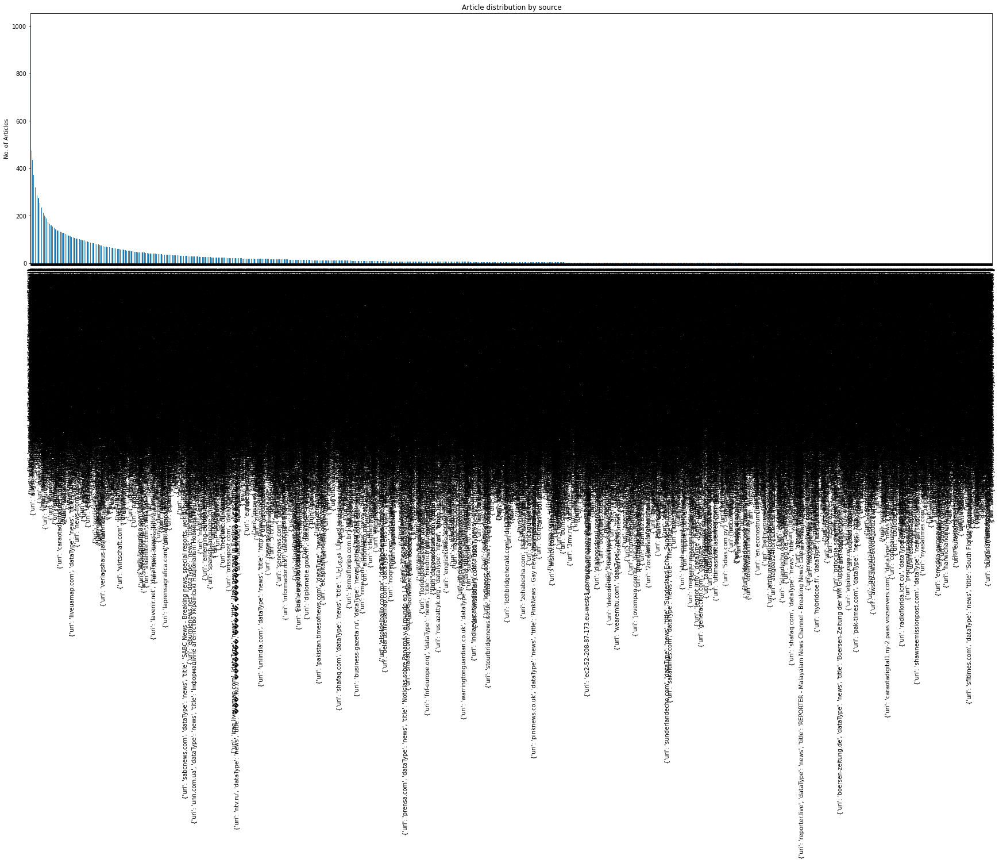

In [ ]:
df_concepts['european_migrant_crisis'].source.value_counts().plot(kind='bar', title='Article distribution by source', ylabel='No. of Articles', figsize=(30, 8) )

In [ ]:
df_concepts['european_migrant_crisis']['isDuplicate'].value_counts()

False    81202
True     37219
Name: isDuplicate, dtype: int64

In [ ]:
df_concepts['me_too_movement']

,concepts,source,eventUri,lang,dateTime,isDuplicate
1648,me_too_movement,"{'uri': 'n-tv.de', 'dataType': 'news', 'title'...",6.655649e+09,deu,2021-07-21 02:19:00,False
1649,me_too_movement,"{'uri': 'faz.net', 'dataType': 'news', 'title'...",6.655651e+09,deu,2021-07-21 02:23:00,False
1650,me_too_movement,"{'uri': 'suedtirolnews.it', 'dataType': 'news'...",6.655691e+09,deu,2021-07-21 03:20:00,False
1651,me_too_movement,"{'uri': 'volksblatt.at', 'dataType': 'news', '...",6.655694e+09,deu,2021-07-21 03:22:00,True
1652,me_too_movement,"{'uri': 'vol.at', 'dataType': 'news', 'title':...",6.655700e+09,deu,2021-07-21 03:31:00,True
...,...,...,...,...,...,...
2514879,me_too_movement,"{'uri': 'correiobraziliense.com.br', 'dataType...",6.740964e+09,por,2021-09-23 19:03:00,False
2514880,me_too_movement,"{'uri': 'mag.sapo.pt', 'dataType': 'news', 'ti...",6.742025e+09,por,2021-09-24 13:32:00,False
2514881,me_too_movement,"{'uri': 'cultura.estadao.com.br', 'dataType': ...",6.746111e+09,por,2021-09-27 22:43:00,True
2515177,me_too_movement,"{'uri': 'noticias.uol.com.br', 'dataType': 'ne...",6.750018e+09,por,2021-09-30 13:27:00,False


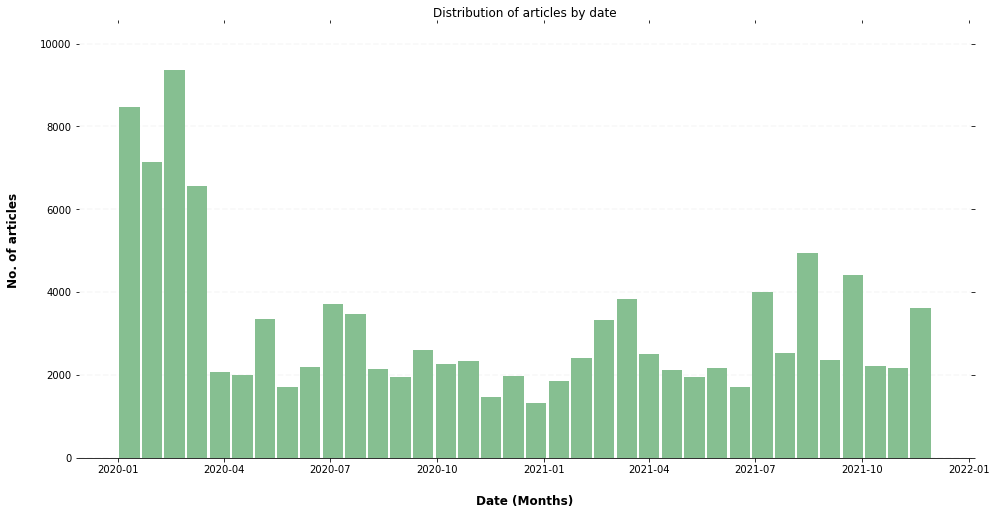

In [ ]:
ax = df_concepts['me_too_movement'].hist(column='dateTime', bins=36, grid=False, figsize=(16,8), color='#86bf91', zorder=2, rwidth=0.9)

ax = ax[0]
for x in ax:

    # Despine
    x.spines['right'].set_visible(False)
    x.spines['top'].set_visible(False)
    x.spines['left'].set_visible(False)

    # Switch off ticks
    x.tick_params(axis="both", which="both", bottom="off", top="off", labelbottom="on", left="off", right="off", labelleft="on")

    # Draw horizontal axis lines
    vals = x.get_yticks()
    for tick in vals:
        x.axhline(y=tick, linestyle='dashed', alpha=0.4, color='#eeeeee', zorder=1)

    # Remove title
    x.set_title("Distribution of articles by date")

    # Set x-axis label
    x.set_xlabel("Date (Months)", labelpad=20, weight='bold', size=12)

    # Set y-axis label
    x.set_ylabel("No. of articles", labelpad=20, weight='bold', size=12)

 

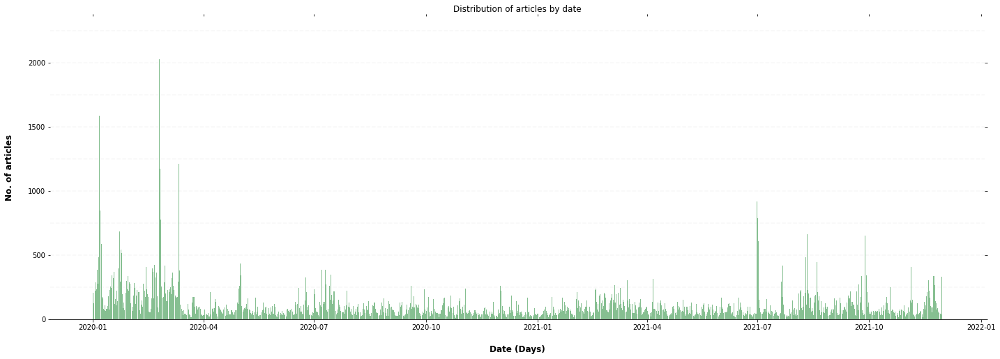

In [ ]:
ax = df_concepts['me_too_movement'].hist(column='dateTime', bins=1080, grid=False, figsize=(24,8), color='#86bf91', zorder=2, rwidth=0.9)

ax = ax[0]
for x in ax:

    # Despine
    x.spines['right'].set_visible(False)
    x.spines['top'].set_visible(False)
    x.spines['left'].set_visible(False)

    # Switch off ticks
    x.tick_params(axis="both", which="both", bottom="off", top="off", labelbottom="on", left="off", right="off", labelleft="on")

    # Draw horizontal axis lines
    vals = x.get_yticks()
    for tick in vals:
        x.axhline(y=tick, linestyle='dashed', alpha=0.4, color='#eeeeee', zorder=1)

    # Remove title
    x.set_title("Distribution of articles by date")

    # Set x-axis label
    x.set_xlabel("Date (Days)", labelpad=20, weight='bold', size=12)

    # Set y-axis label
    x.set_ylabel("No. of articles", labelpad=20, weight='bold', size=12)

 

<AxesSubplot:title={'center':'Article distribution by language'}, ylabel='No. of Articles'>

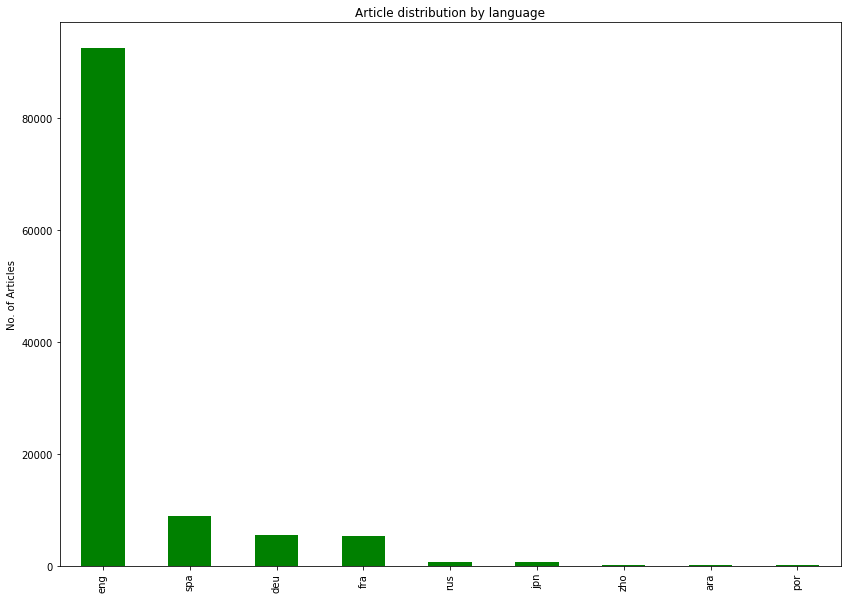

In [ ]:
df_concepts['me_too_movement']['lang'].value_counts().plot(kind='bar', title='Article distribution by language', ylabel='No. of Articles', figsize=(14,10), color='green')

<AxesSubplot:title={'center':'Article distribution by source'}, ylabel='No. of Articles'>

/home/matevzm/.local/lib/python3.8/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 12491 (\N{KATAKANA LETTER NI}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/matevzm/.local/lib/python3.8/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 12517 (\N{KATAKANA LETTER SMALL YU}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/matevzm/.local/lib/python3.8/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 12540 (\N{KATAKANA-HIRAGANA PROLONGED SOUND MARK}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/matevzm/.local/lib/python3.8/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 12473 (\N{KATAKANA LETTER SU}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/matevzm/.local/lib/python3.8/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 27598 (\N{CJK UNIFIED IDEOGRAPH-6BCE}) missing from current font.
  fig.ca

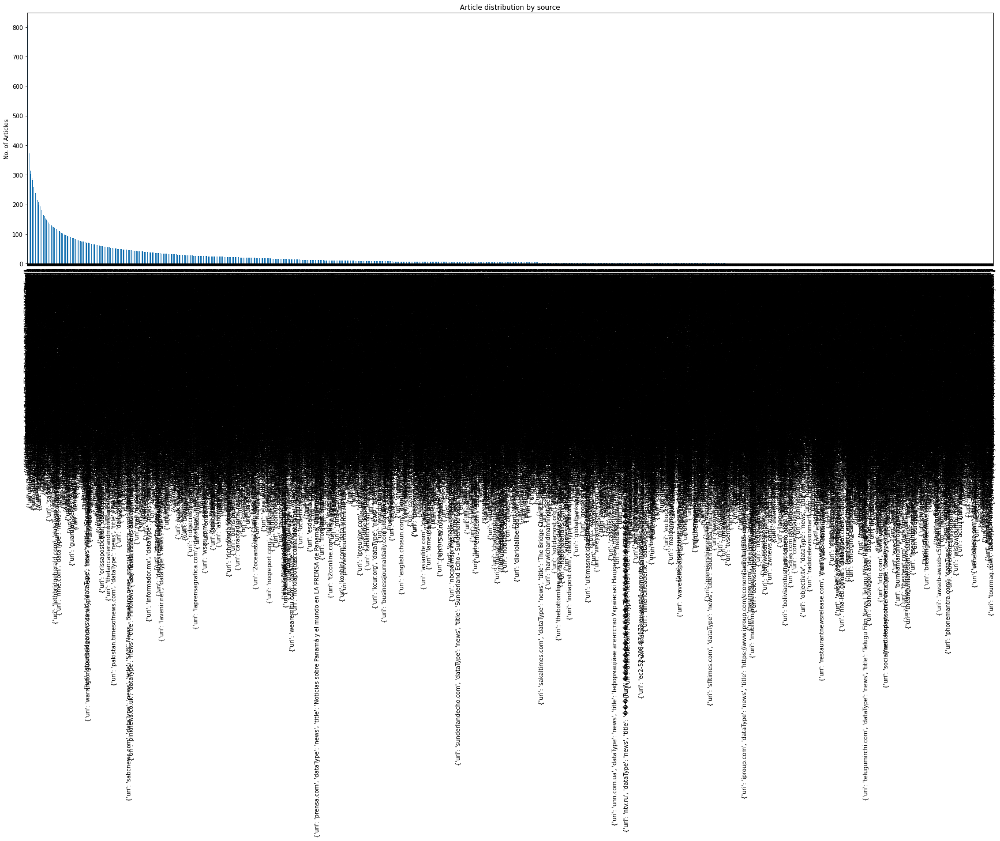

In [ ]:
df_concepts['me_too_movement'].source.value_counts().plot(kind='bar', title='Article distribution by source', ylabel='No. of Articles', figsize=(30, 8) )

In [ ]:
df_concepts['me_too_movement']['isDuplicate'].value_counts()

False    68140
True     46128
Name: isDuplicate, dtype: int64

In [ ]:
df_concepts['volcano;types_of_volcanic_eruptions']

,concepts,source,eventUri,lang,dateTime,isDuplicate
0,volcano;types_of_volcanic_eruptions,"{'uri': 'watson.de', 'dataType': 'news', 'titl...",1.453079e+09,deu,2020-02-19 06:26:00,True
1,volcano;types_of_volcanic_eruptions,"{'uri': 'thueringer-allgemeine.de', 'dataType'...",1.453470e+09,deu,2020-02-19 12:46:00,False
2,volcano;types_of_volcanic_eruptions,"{'uri': 'tlz.de', 'dataType': 'news', 'title':...",1.453494e+09,deu,2020-02-19 13:09:00,True
3,volcano;types_of_volcanic_eruptions,"{'uri': 'br.de', 'dataType': 'news', 'title': ...",1.454035e+09,deu,2020-02-19 21:59:00,False
4,volcano;types_of_volcanic_eruptions,"{'uri': 'arte.tv', 'dataType': 'news', 'title'...",1.454366e+09,deu,2020-02-20 05:37:00,False
...,...,...,...,...,...,...
2519053,volcano;types_of_volcanic_eruptions,"{'uri': 'jtm.com.mo', 'dataType': 'news', 'tit...",6.408992e+09,por,2021-01-28 07:30:00,False
2519054,volcano;types_of_volcanic_eruptions,"{'uri': 'renovamidia.com.br', 'dataType': 'new...",6.409983e+09,por,2021-01-28 19:54:00,False
2519055,volcano;types_of_volcanic_eruptions,"{'uri': 'pt.euronews.com', 'dataType': 'news',...",6.410506e+09,por,2021-01-29 06:21:00,False
2519056,volcano;types_of_volcanic_eruptions,"{'uri': 'inforpress.cv', 'dataType': 'news', '...",6.412184e+09,por,2021-01-30 11:38:00,False


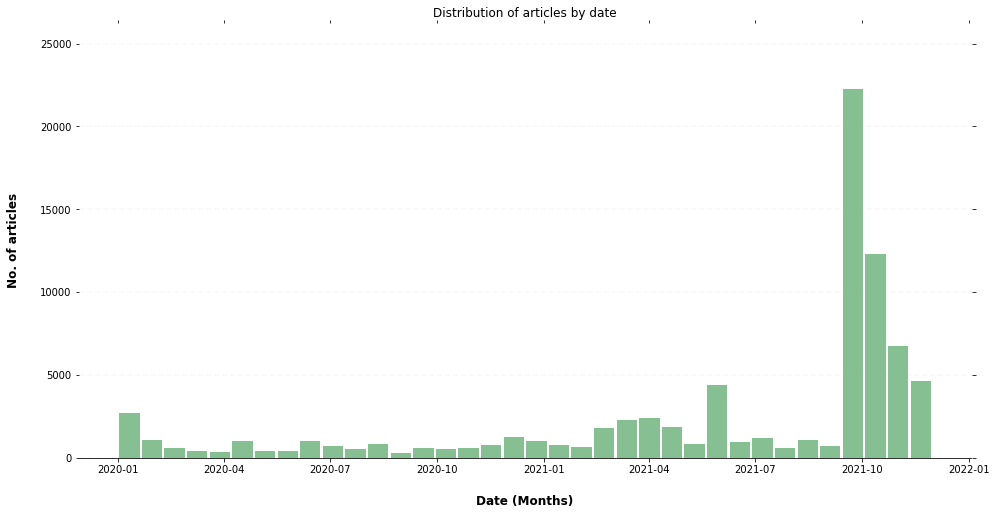

In [ ]:
ax = df_concepts['volcano;types_of_volcanic_eruptions'].hist(column='dateTime', bins=36, grid=False, figsize=(16,8), color='#86bf91', zorder=2, rwidth=0.9)

ax = ax[0]
for x in ax:

    # Despine
    x.spines['right'].set_visible(False)
    x.spines['top'].set_visible(False)
    x.spines['left'].set_visible(False)

    # Switch off ticks
    x.tick_params(axis="both", which="both", bottom="off", top="off", labelbottom="on", left="off", right="off", labelleft="on")

    # Draw horizontal axis lines
    vals = x.get_yticks()
    for tick in vals:
        x.axhline(y=tick, linestyle='dashed', alpha=0.4, color='#eeeeee', zorder=1)

    # Remove title
    x.set_title("Distribution of articles by date")

    # Set x-axis label
    x.set_xlabel("Date (Months)", labelpad=20, weight='bold', size=12)

    # Set y-axis label
    x.set_ylabel("No. of articles", labelpad=20, weight='bold', size=12)

   

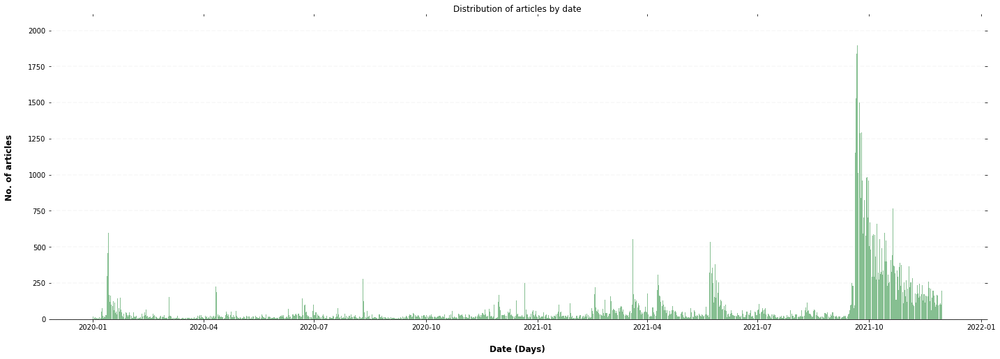

In [ ]:
ax = df_concepts['volcano;types_of_volcanic_eruptions'].hist(column='dateTime', bins=1080, grid=False, figsize=(24,8), color='#86bf91', zorder=2, rwidth=0.9)

ax = ax[0]
for x in ax:

    # Despine
    x.spines['right'].set_visible(False)
    x.spines['top'].set_visible(False)
    x.spines['left'].set_visible(False)

    # Switch off ticks
    x.tick_params(axis="both", which="both", bottom="off", top="off", labelbottom="on", left="off", right="off", labelleft="on")

    # Draw horizontal axis lines
    vals = x.get_yticks()
    for tick in vals:
        x.axhline(y=tick, linestyle='dashed', alpha=0.4, color='#eeeeee', zorder=1)

    # Remove title
    x.set_title("Distribution of articles by date")

    # Set x-axis label
    x.set_xlabel("Date (Days)", labelpad=20, weight='bold', size=12)

    # Set y-axis label
    x.set_ylabel("No. of articles", labelpad=20, weight='bold', size=12)

 

<AxesSubplot:title={'center':'Article distribution by language'}, ylabel='No. of Articles'>

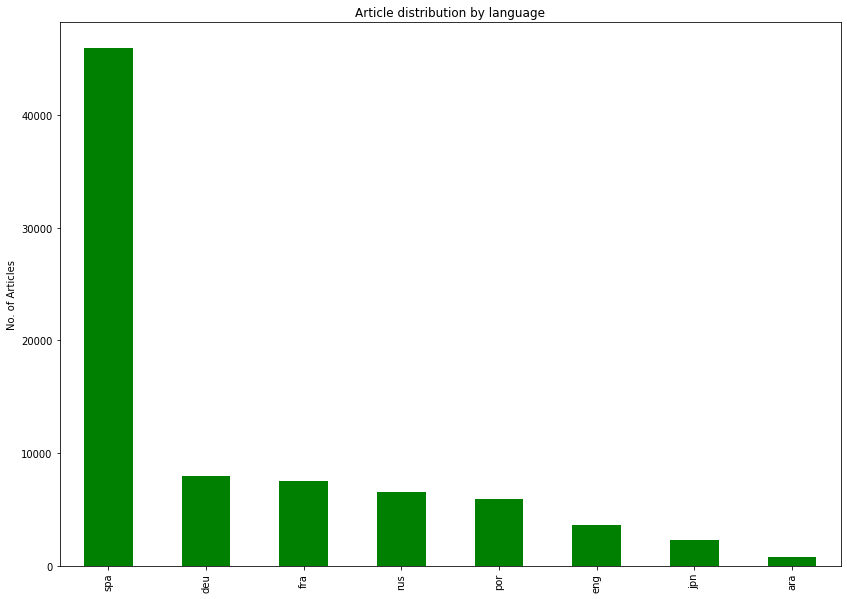

In [ ]:
df_concepts['volcano;types_of_volcanic_eruptions']['lang'].value_counts().plot(kind='bar', title='Article distribution by language', ylabel='No. of Articles', figsize=(14,10), color='green')

<AxesSubplot:title={'center':'Article distribution by source'}, ylabel='No. of Articles'>

/home/matevzm/.local/lib/python3.8/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 12491 (\N{KATAKANA LETTER NI}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/matevzm/.local/lib/python3.8/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 12517 (\N{KATAKANA LETTER SMALL YU}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/matevzm/.local/lib/python3.8/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 12540 (\N{KATAKANA-HIRAGANA PROLONGED SOUND MARK}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/matevzm/.local/lib/python3.8/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 12473 (\N{KATAKANA LETTER SU}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/matevzm/.local/lib/python3.8/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 12503 (\N{KATAKANA LETTER PU}) missing from current font.
  fig.canvas.pri

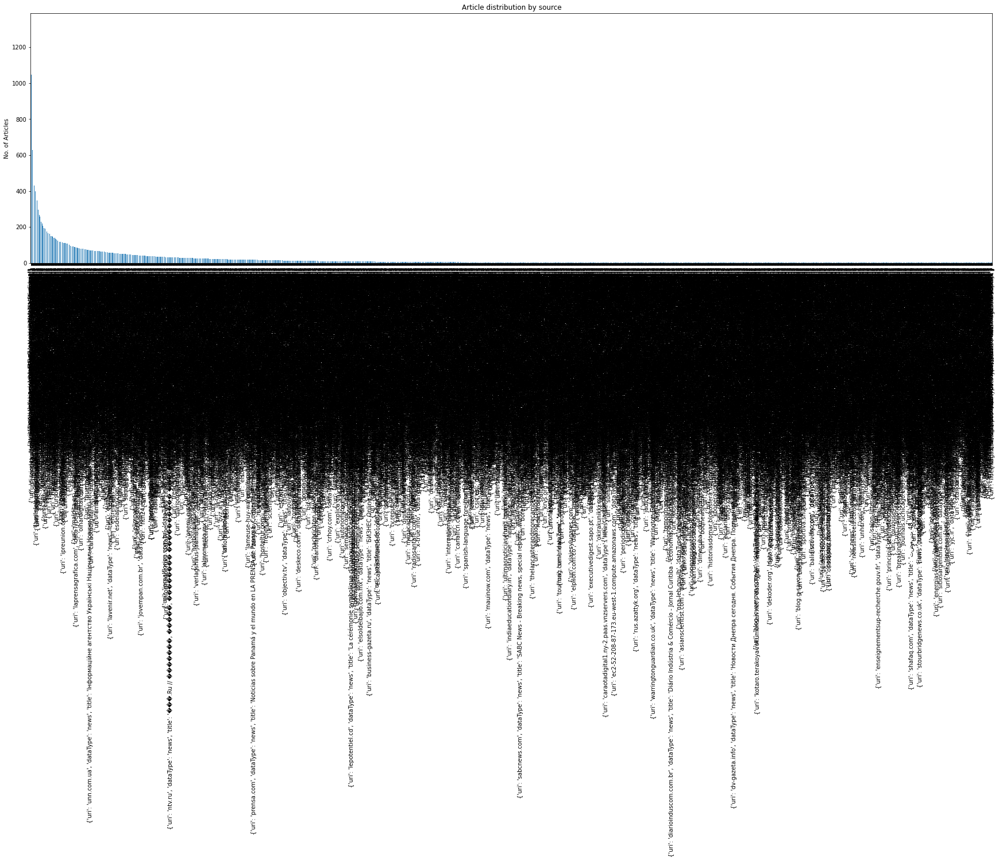

In [ ]:
df_concepts['volcano;types_of_volcanic_eruptions'].source.value_counts().plot(kind='bar', title='Article distribution by source', ylabel='No. of Articles', figsize=(30, 8) )

In [ ]:
df_concepts['volcano;types_of_volcanic_eruptions']['isDuplicate'].value_counts()

False    55935
True     24794
Name: isDuplicate, dtype: int64

In [ ]:
df_concepts['presidency_of_the_council_of_the_european_union']

,concepts,source,eventUri,lang,dateTime,isDuplicate
523,presidency_of_the_council_of_the_european_union,"{'uri': 't-online.de', 'dataType': 'news', 'ti...",6.099138e+09,deu,2020-06-10 00:17:00,False
524,presidency_of_the_council_of_the_european_union,"{'uri': 'dw.com', 'dataType': 'news', 'title':...",6.099186e+09,deu,2020-06-10 01:25:00,False
525,presidency_of_the_council_of_the_european_union,"{'uri': 'tt.com', 'dataType': 'news', 'title':...",6.099186e+09,deu,2020-06-10 01:26:00,True
526,presidency_of_the_council_of_the_european_union,"{'uri': 'freiepresse.de', 'dataType': 'news', ...",6.099194e+09,deu,2020-06-10 01:38:00,False
527,presidency_of_the_council_of_the_european_union,"{'uri': 'tagesspiegel.de', 'dataType': 'news',...",6.099293e+09,deu,2020-06-10 03:57:00,False
...,...,...,...,...,...,...
2508835,presidency_of_the_council_of_the_european_union,"{'uri': 'observador.pt', 'dataType': 'news', '...",6.561884e+09,por,2021-05-14 14:45:00,False
2508836,presidency_of_the_council_of_the_european_union,"{'uri': 'publico.pt', 'dataType': 'news', 'tit...",6.564571e+09,por,2021-05-17 00:03:00,False
2511419,presidency_of_the_council_of_the_european_union,"{'uri': 'jornaleconomico.sapo.pt', 'dataType':...",6.643030e+09,por,2021-07-11 23:12:00,False
2511703,presidency_of_the_council_of_the_european_union,"{'uri': '24.sapo.pt', 'dataType': 'news', 'tit...",6.253707e+09,por,2020-10-13 00:55:00,False


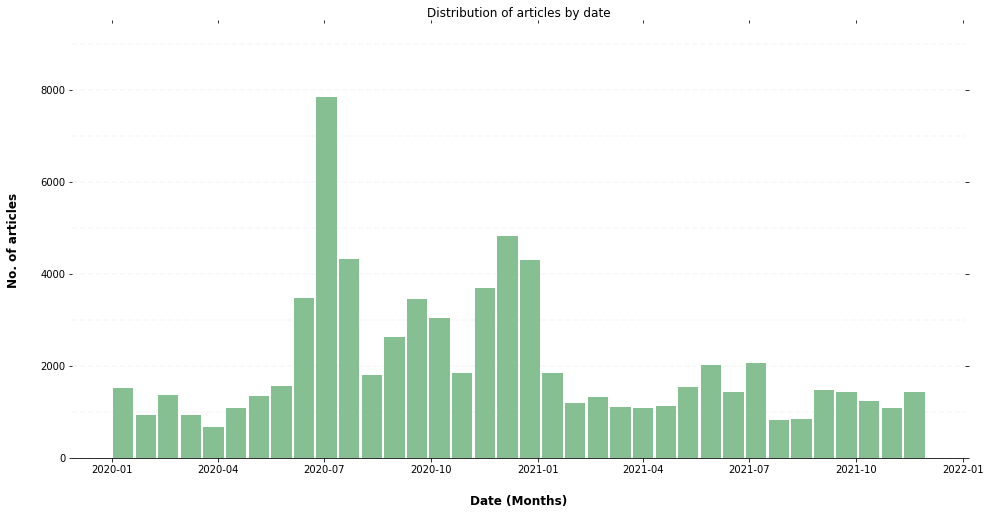

In [ ]:
ax = df_concepts['presidency_of_the_council_of_the_european_union'].hist(column='dateTime', bins=36, grid=False, figsize=(16,8), color='#86bf91', zorder=2, rwidth=0.9)

ax = ax[0]
for x in ax:

    # Despine
    x.spines['right'].set_visible(False)
    x.spines['top'].set_visible(False)
    x.spines['left'].set_visible(False)

    # Switch off ticks
    x.tick_params(axis="both", which="both", bottom="off", top="off", labelbottom="on", left="off", right="off", labelleft="on")

    # Draw horizontal axis lines
    vals = x.get_yticks()
    for tick in vals:
        x.axhline(y=tick, linestyle='dashed', alpha=0.4, color='#eeeeee', zorder=1)

    # Remove title
    x.set_title("Distribution of articles by date")

    # Set x-axis label
    x.set_xlabel("Date (Months)", labelpad=20, weight='bold', size=12)

    # Set y-axis label
    x.set_ylabel("No. of articles", labelpad=20, weight='bold', size=12)

  

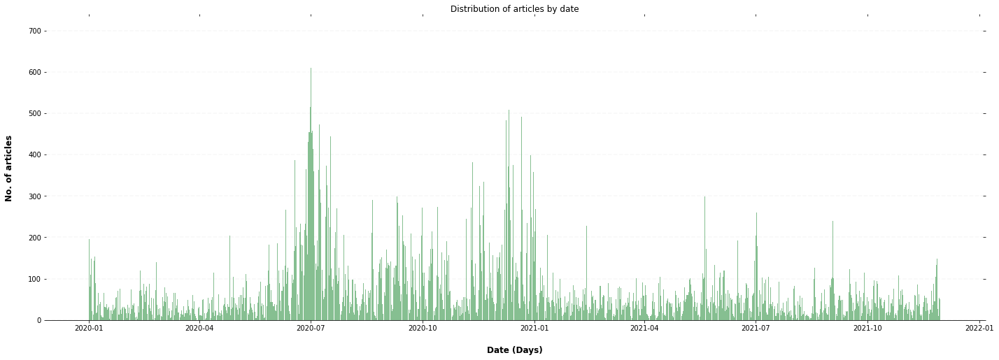

In [ ]:
ax = df_concepts['presidency_of_the_council_of_the_european_union'].hist(column='dateTime', bins=1080, grid=False, figsize=(24,8), color='#86bf91', zorder=2, rwidth=0.9)

ax = ax[0]
for x in ax:

    # Despine
    x.spines['right'].set_visible(False)
    x.spines['top'].set_visible(False)
    x.spines['left'].set_visible(False)

    # Switch off ticks
    x.tick_params(axis="both", which="both", bottom="off", top="off", labelbottom="on", left="off", right="off", labelleft="on")

    # Draw horizontal axis lines
    vals = x.get_yticks()
    for tick in vals:
        x.axhline(y=tick, linestyle='dashed', alpha=0.4, color='#eeeeee', zorder=1)

    # Remove title
    x.set_title("Distribution of articles by date")

    # Set x-axis label
    x.set_xlabel("Date (Days)", labelpad=20, weight='bold', size=12)

    # Set y-axis label
    x.set_ylabel("No. of articles", labelpad=20, weight='bold', size=12)

  

<AxesSubplot:title={'center':'Article distribution by language'}, ylabel='No. of Articles'>

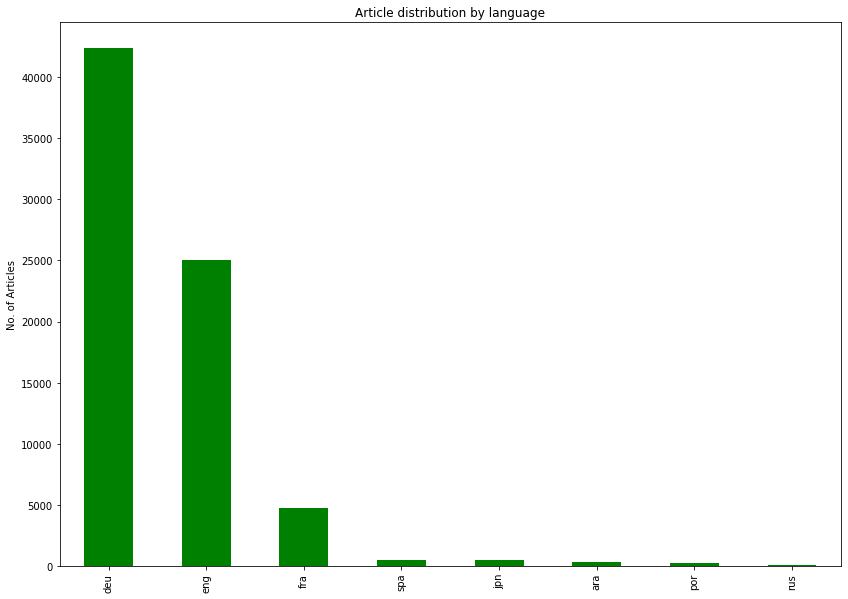

In [ ]:
df_concepts['presidency_of_the_council_of_the_european_union']['lang'].value_counts().plot(kind='bar', title='Article distribution by language', ylabel='No. of Articles', figsize=(14,10), color='green')

<AxesSubplot:title={'center':'Article distribution by source'}, ylabel='No. of Articles'>

/home/matevzm/.local/lib/python3.8/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 20013 (\N{CJK UNIFIED IDEOGRAPH-4E2D}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/matevzm/.local/lib/python3.8/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 22269 (\N{CJK UNIFIED IDEOGRAPH-56FD}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/matevzm/.local/lib/python3.8/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 32593 (\N{CJK UNIFIED IDEOGRAPH-7F51}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/matevzm/.local/lib/python3.8/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 27598 (\N{CJK UNIFIED IDEOGRAPH-6BCE}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/matevzm/.local/lib/python3.8/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 26085 (\N{CJK UNIFIED IDEOGRAPH-65E5}) missing from current font.
  

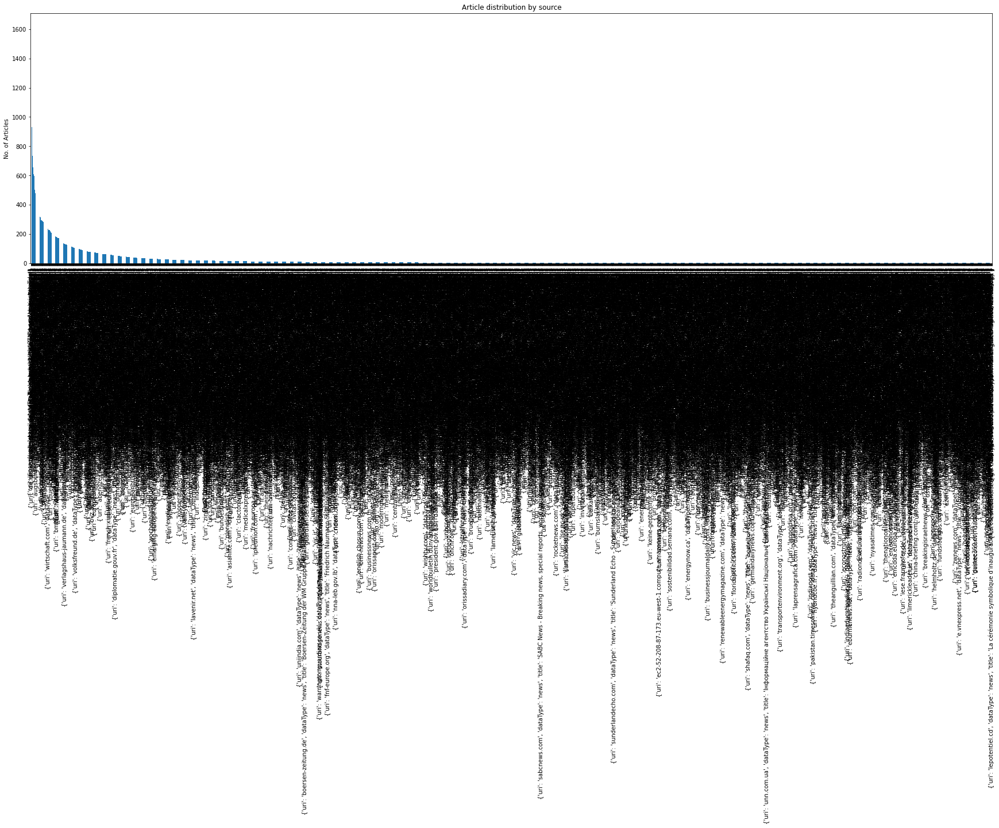

In [ ]:
df_concepts['presidency_of_the_council_of_the_european_union'].source.value_counts().plot(kind='bar', title='Article distribution by source', ylabel='No. of Articles', figsize=(30, 8) )

In [ ]:
df_concepts['presidency_of_the_council_of_the_european_union']['isDuplicate'].value_counts()

False    44581
True     29040
Name: isDuplicate, dtype: int64

In [ ]:
df_concepts['black_lives_matter']

,concepts,source,eventUri,lang,dateTime,isDuplicate
510,black_lives_matter,"{'uri': 'goettinger-tageblatt.de', 'dataType':...",1.402474e+09,deu,2020-01-08 09:59:00,False
511,black_lives_matter,"{'uri': 'goettinger-tageblatt.de', 'dataType':...",1.402557e+09,deu,2020-01-08 11:17:00,False
512,black_lives_matter,"{'uri': 'nrz.de', 'dataType': 'news', 'title':...",1.403665e+09,deu,2020-01-09 08:21:00,False
513,black_lives_matter,"{'uri': 'waz.de', 'dataType': 'news', 'title':...",1.403674e+09,deu,2020-01-09 08:24:00,True
514,black_lives_matter,"{'uri': 'ikz-online.de', 'dataType': 'news', '...",1.403675e+09,deu,2020-01-09 08:27:00,True
...,...,...,...,...,...,...
2518168,black_lives_matter,"{'uri': 'rollingstone.uol.com.br', 'dataType':...",6.446581e+09,por,2021-02-23 17:49:00,False
2518169,black_lives_matter,"{'uri': 'g1.globo.com', 'dataType': 'news', 't...",6.446779e+09,por,2021-02-23 20:40:00,False
2518170,black_lives_matter,"{'uri': 'revistamarieclaire.globo.com', 'dataT...",6.446797e+09,por,2021-02-23 20:57:00,False
2518171,black_lives_matter,"{'uri': 'em.com.br', 'dataType': 'news', 'titl...",6.446927e+09,por,2021-02-23 23:11:00,False


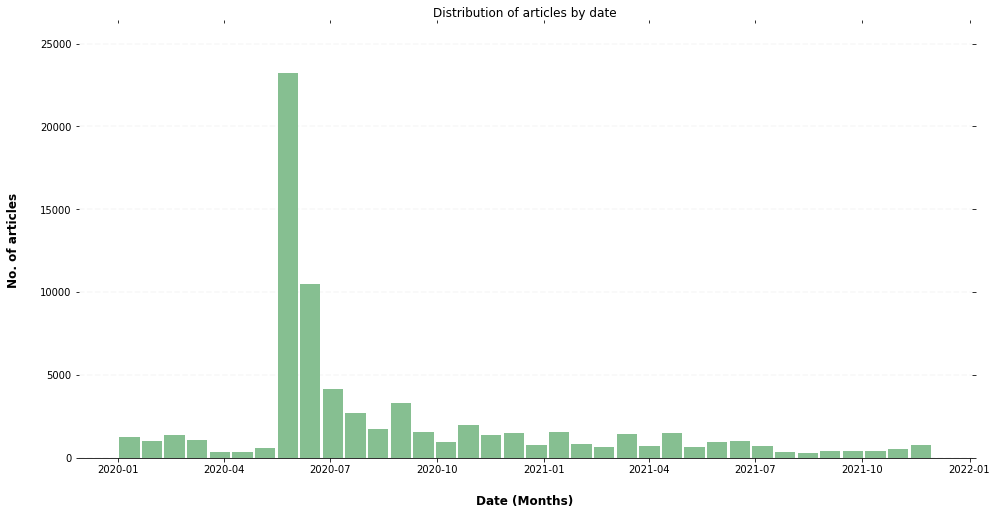

In [ ]:
ax = df_concepts['black_lives_matter'].hist(column='dateTime', bins=36, grid=False, figsize=(16,8), color='#86bf91', zorder=2, rwidth=0.9)

ax = ax[0]
for x in ax:

    # Despine
    x.spines['right'].set_visible(False)
    x.spines['top'].set_visible(False)
    x.spines['left'].set_visible(False)

    # Switch off ticks
    x.tick_params(axis="both", which="both", bottom="off", top="off", labelbottom="on", left="off", right="off", labelleft="on")

    # Draw horizontal axis lines
    vals = x.get_yticks()
    for tick in vals:
        x.axhline(y=tick, linestyle='dashed', alpha=0.4, color='#eeeeee', zorder=1)

    # Remove title
    x.set_title("Distribution of articles by date")

    # Set x-axis label
    x.set_xlabel("Date (Months)", labelpad=20, weight='bold', size=12)

    # Set y-axis label
    x.set_ylabel("No. of articles", labelpad=20, weight='bold', size=12)

  

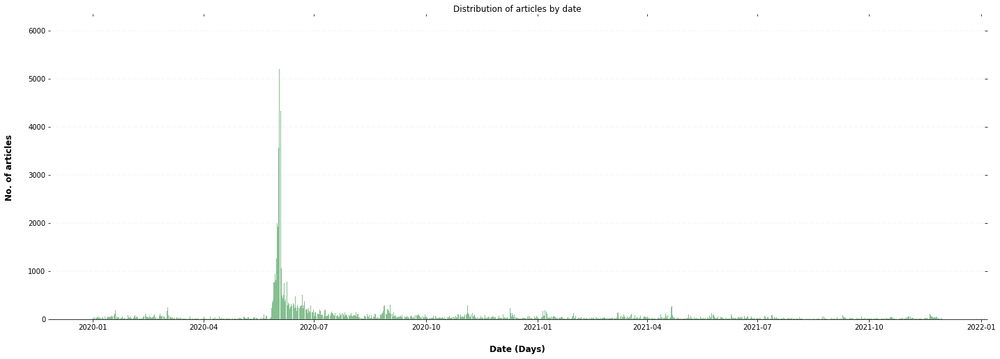

In [ ]:
ax = df_concepts['black_lives_matter'].hist(column='dateTime', bins=1080, grid=False, figsize=(24,8), color='#86bf91', zorder=2, rwidth=0.9)

ax = ax[0]
for x in ax:

    # Despine
    x.spines['right'].set_visible(False)
    x.spines['top'].set_visible(False)
    x.spines['left'].set_visible(False)

    # Switch off ticks
    x.tick_params(axis="both", which="both", bottom="off", top="off", labelbottom="on", left="off", right="off", labelleft="on")

    # Draw horizontal axis lines
    vals = x.get_yticks()
    for tick in vals:
        x.axhline(y=tick, linestyle='dashed', alpha=0.4, color='#eeeeee', zorder=1)

    # Remove title
    x.set_title("Distribution of articles by date")

    # Set x-axis label
    x.set_xlabel("Date (Days)", labelpad=20, weight='bold', size=12)

    # Set y-axis label
    x.set_ylabel("No. of articles", labelpad=20, weight='bold', size=12)

  

<AxesSubplot:title={'center':'Article distribution by language'}, ylabel='No. of Articles'>

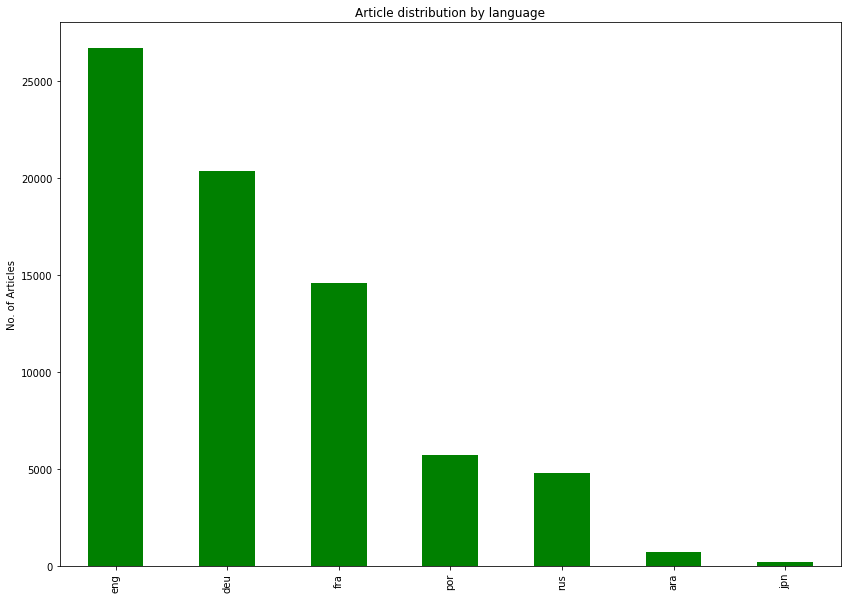

In [ ]:
df_concepts['black_lives_matter']['lang'].value_counts().plot(kind='bar', title='Article distribution by language', ylabel='No. of Articles', figsize=(14,10), color='green')

<AxesSubplot:title={'center':'Article distribution by source'}, ylabel='No. of Articles'>

/home/matevzm/.local/lib/python3.8/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 12491 (\N{KATAKANA LETTER NI}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/matevzm/.local/lib/python3.8/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 12517 (\N{KATAKANA LETTER SMALL YU}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/matevzm/.local/lib/python3.8/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 12540 (\N{KATAKANA-HIRAGANA PROLONGED SOUND MARK}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/matevzm/.local/lib/python3.8/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 12473 (\N{KATAKANA LETTER SU}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/matevzm/.local/lib/python3.8/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 20013 (\N{CJK UNIFIED IDEOGRAPH-4E2D}) missing from current font.
  fig.ca

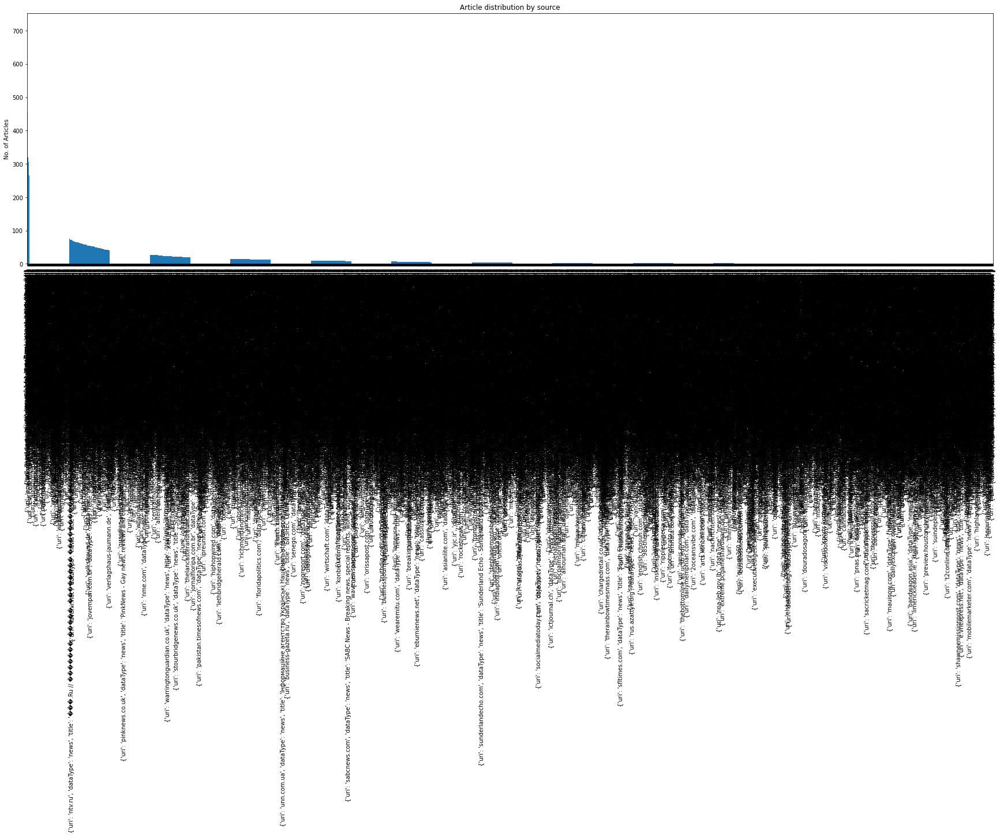

In [ ]:
df_concepts['black_lives_matter'].source.value_counts().plot(kind='bar', title='Article distribution by source', ylabel='No. of Articles', figsize=(30, 8) )

In [ ]:
df_concepts['black_lives_matter']['isDuplicate'].value_counts()

False    50299
True     22754
Name: isDuplicate, dtype: int64

In [ ]:
df_concepts['hong_kong;demonstration']

,concepts,source,eventUri,lang,dateTime,isDuplicate
386,hong_kong;demonstration,"{'uri': 'deutschlandfunkkultur.de', 'dataType'...",6.793996e+09,deu,2021-11-03 05:58:00,False
387,hong_kong;demonstration,"{'uri': 'merkur.de', 'dataType': 'news', 'titl...",6.797173e+09,deu,2021-11-05 10:01:00,False
388,hong_kong;demonstration,"{'uri': 'firmenpresse.de', 'dataType': 'news',...",6.800515e+09,deu,2021-11-08 09:35:00,False
389,hong_kong;demonstration,"{'uri': 'mittelstandcafe.de', 'dataType': 'new...",6.800600e+09,deu,2021-11-08 10:41:00,True
390,hong_kong;demonstration,"{'uri': 'bernerzeitung.ch', 'dataType': 'news'...",6.801728e+09,deu,2021-11-09 06:02:00,True
...,...,...,...,...,...,...
2517649,hong_kong;demonstration,"{'uri': 'operamundi.uol.com.br', 'dataType': '...",6.177754e+09,por,2020-08-10 21:01:00,False
2517650,hong_kong;demonstration,"{'uri': 'em.com.br', 'dataType': 'news', 'titl...",6.178210e+09,por,2020-08-11 07:04:00,False
2518914,hong_kong;demonstration,"{'uri': 'uol.com.br', 'dataType': 'news', 'tit...",6.601205e+09,por,2021-06-11 15:45:00,False
2518915,hong_kong;demonstration,"{'uri': 'em.com.br', 'dataType': 'news', 'titl...",6.602232e+09,por,2021-06-12 12:21:00,True


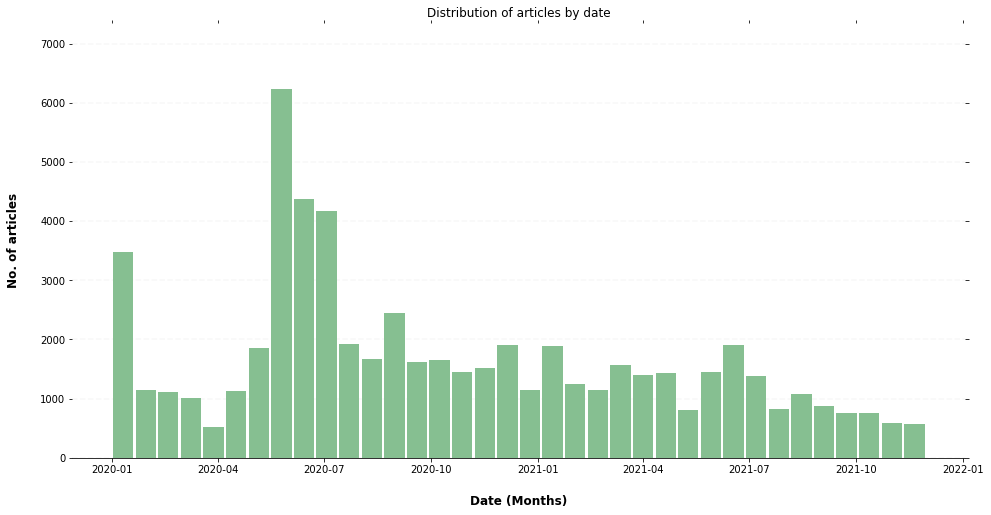

In [ ]:
ax = df_concepts['hong_kong;demonstration'].hist(column='dateTime', bins=36, grid=False, figsize=(16,8), color='#86bf91', zorder=2, rwidth=0.9)

ax = ax[0]
for x in ax:

    # Despine
    x.spines['right'].set_visible(False)
    x.spines['top'].set_visible(False)
    x.spines['left'].set_visible(False)

    # Switch off ticks
    x.tick_params(axis="both", which="both", bottom="off", top="off", labelbottom="on", left="off", right="off", labelleft="on")

    # Draw horizontal axis lines
    vals = x.get_yticks()
    for tick in vals:
        x.axhline(y=tick, linestyle='dashed', alpha=0.4, color='#eeeeee', zorder=1)

    # Remove title
    x.set_title("Distribution of articles by date")

    # Set x-axis label
    x.set_xlabel("Date (Months)", labelpad=20, weight='bold', size=12)

    # Set y-axis label
    x.set_ylabel("No. of articles", labelpad=20, weight='bold', size=12)

   

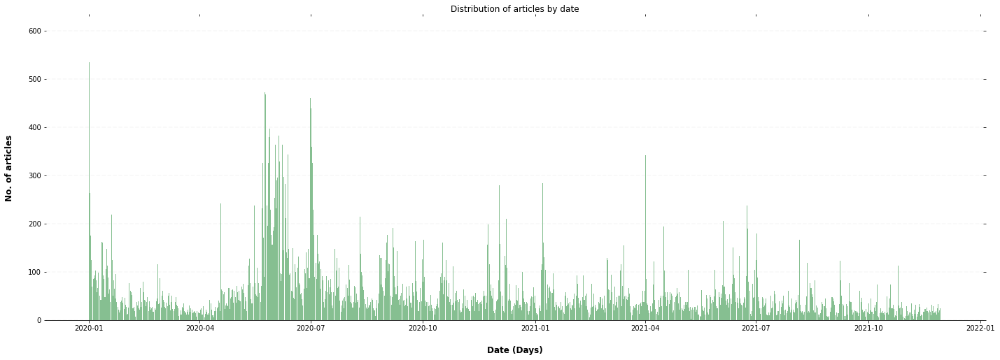

In [ ]:
ax = df_concepts['hong_kong;demonstration'].hist(column='dateTime', bins=1080, grid=False, figsize=(24,8), color='#86bf91', zorder=2, rwidth=0.9)

ax = ax[0]
for x in ax:

    # Despine
    x.spines['right'].set_visible(False)
    x.spines['top'].set_visible(False)
    x.spines['left'].set_visible(False)

    # Switch off ticks
    x.tick_params(axis="both", which="both", bottom="off", top="off", labelbottom="on", left="off", right="off", labelleft="on")

    # Draw horizontal axis lines
    vals = x.get_yticks()
    for tick in vals:
        x.axhline(y=tick, linestyle='dashed', alpha=0.4, color='#eeeeee', zorder=1)

    # Remove title
    x.set_title("Distribution of articles by date")

    # Set x-axis label
    x.set_xlabel("Date (Days)", labelpad=20, weight='bold', size=12)

    # Set y-axis label
    x.set_ylabel("No. of articles", labelpad=20, weight='bold', size=12)

  

<AxesSubplot:title={'center':'Article distribution by language'}, ylabel='No. of Articles'>

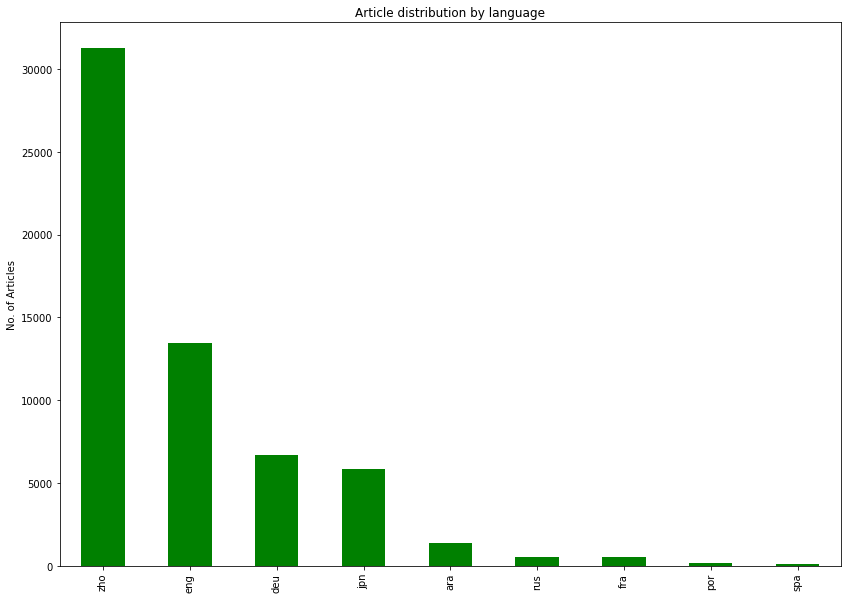

In [ ]:
df_concepts['hong_kong;demonstration']['lang'].value_counts().plot(kind='bar', title='Article distribution by language', ylabel='No. of Articles', figsize=(14,10), color='green')

<AxesSubplot:title={'center':'Article distribution by source'}, ylabel='No. of Articles'>

/home/matevzm/.local/lib/python3.8/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 30475 (\N{CJK UNIFIED IDEOGRAPH-770B}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/matevzm/.local/lib/python3.8/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 20013 (\N{CJK UNIFIED IDEOGRAPH-4E2D}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/matevzm/.local/lib/python3.8/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 22269 (\N{CJK UNIFIED IDEOGRAPH-56FD}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/matevzm/.local/lib/python3.8/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 26143 (\N{CJK UNIFIED IDEOGRAPH-661F}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/matevzm/.local/lib/python3.8/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 23707 (\N{CJK UNIFIED IDEOGRAPH-5C9B}) missing from current font.
  

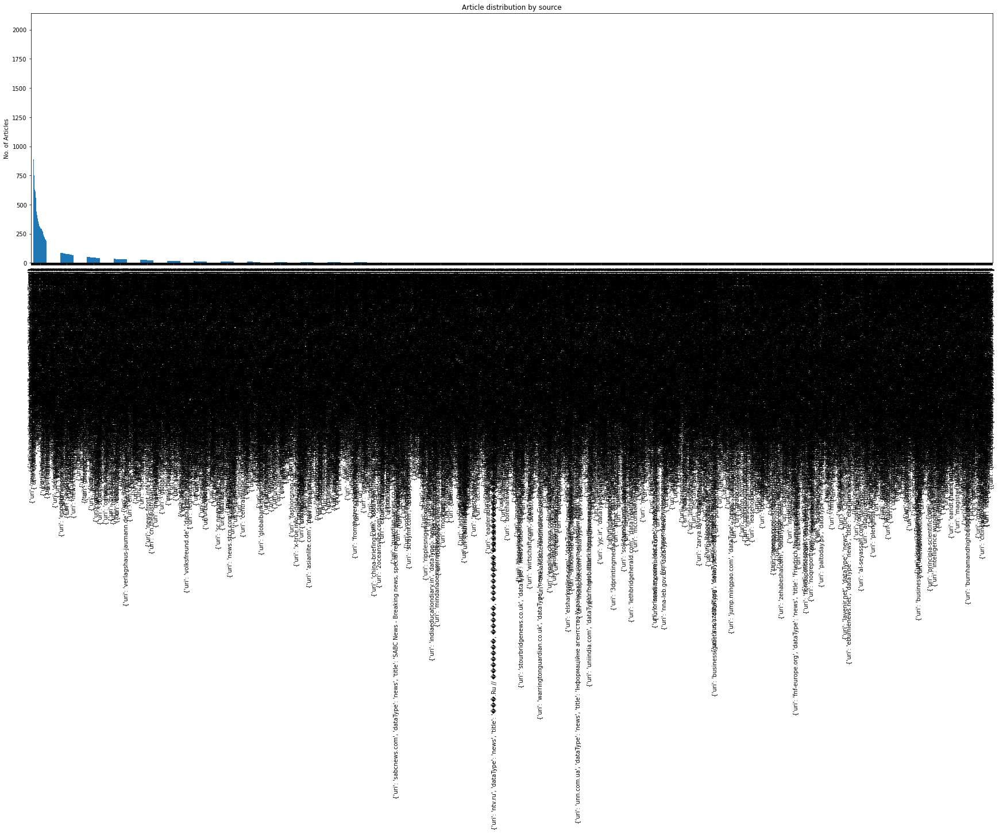

In [ ]:
df_concepts['hong_kong;demonstration'].source.value_counts().plot(kind='bar', title='Article distribution by source', ylabel='No. of Articles', figsize=(30, 8) )

In [ ]:
df_concepts['hong_kong;demonstration']['isDuplicate'].value_counts()

False    46591
True     13440
Name: isDuplicate, dtype: int64

In [ ]:
df_concepts['kobe_bryant;helicopter']

,concepts,source,eventUri,lang,dateTime,isDuplicate
9,kobe_bryant;helicopter,"{'uri': 'hna.de', 'dataType': 'news', 'title':...",1.437337e+09,deu,2020-02-06 08:38:00,False
10,kobe_bryant;helicopter,"{'uri': 'merkur.de', 'dataType': 'news', 'titl...",1.437338e+09,deu,2020-02-06 08:39:00,True
11,kobe_bryant;helicopter,"{'uri': 'op-online.de', 'dataType': 'news', 't...",1.437340e+09,deu,2020-02-06 08:41:00,True
12,kobe_bryant;helicopter,"{'uri': 'tz.de', 'dataType': 'news', 'title': ...",1.437346e+09,deu,2020-02-06 08:47:00,True
13,kobe_bryant;helicopter,"{'uri': 'ovb-online.de', 'dataType': 'news', '...",1.437349e+09,deu,2020-02-06 08:51:00,True
...,...,...,...,...,...,...
2512529,kobe_bryant;helicopter,"{'uri': 'revistamonet.globo.com', 'dataType': ...",1.477931e+09,por,2020-03-10 10:42:00,False
2517205,kobe_bryant;helicopter,"{'uri': 'rollingstone.uol.com.br', 'dataType':...",6.018176e+09,por,2020-04-03 00:09:00,False
2517206,kobe_bryant;helicopter,"{'uri': 'ojogo.pt', 'dataType': 'news', 'title...",6.020477e+09,por,2020-04-04 23:19:00,False
2517207,kobe_bryant;helicopter,"{'uri': 'espn.com.br', 'dataType': 'news', 'ti...",6.021249e+09,por,2020-04-05 18:21:00,False


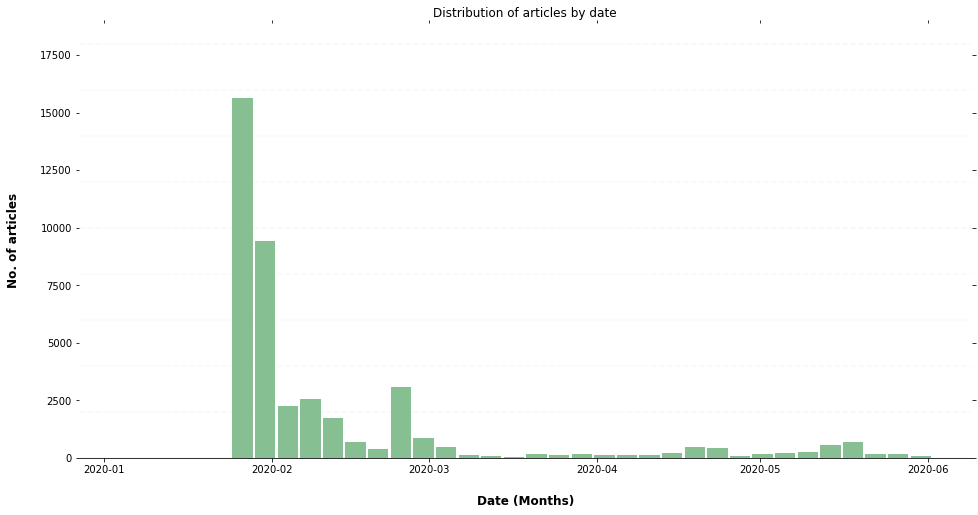

In [ ]:
ax = df_concepts['kobe_bryant;helicopter'].hist(column='dateTime', bins=36, grid=False, figsize=(16,8), color='#86bf91', zorder=2, rwidth=0.9)

ax = ax[0]
for x in ax:

    # Despine
    x.spines['right'].set_visible(False)
    x.spines['top'].set_visible(False)
    x.spines['left'].set_visible(False)

    # Switch off ticks
    x.tick_params(axis="both", which="both", bottom="off", top="off", labelbottom="on", left="off", right="off", labelleft="on")

    # Draw horizontal axis lines
    vals = x.get_yticks()
    for tick in vals:
        x.axhline(y=tick, linestyle='dashed', alpha=0.4, color='#eeeeee', zorder=1)

    # Remove title
    x.set_title("Distribution of articles by date")

    # Set x-axis label
    x.set_xlabel("Date (Months)", labelpad=20, weight='bold', size=12)

    # Set y-axis label
    x.set_ylabel("No. of articles", labelpad=20, weight='bold', size=12)

   

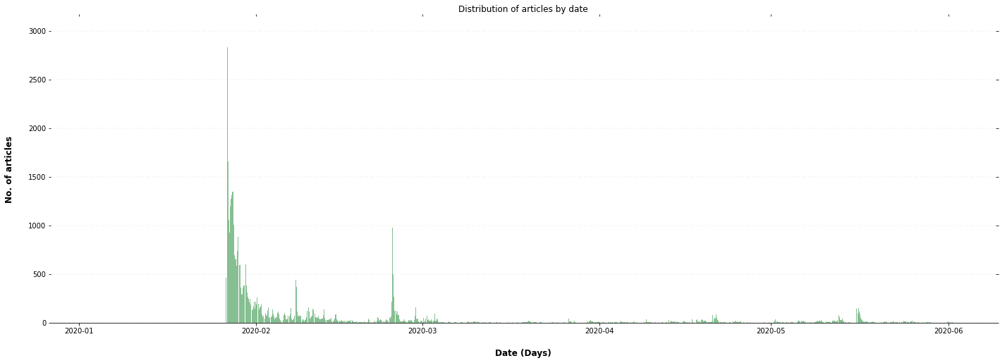

In [ ]:
ax = df_concepts['kobe_bryant;helicopter'].hist(column='dateTime', bins=1080, grid=False, figsize=(24,8), color='#86bf91', zorder=2, rwidth=0.9)

ax = ax[0]
for x in ax:

    # Despine
    x.spines['right'].set_visible(False)
    x.spines['top'].set_visible(False)
    x.spines['left'].set_visible(False)

    # Switch off ticks
    x.tick_params(axis="both", which="both", bottom="off", top="off", labelbottom="on", left="off", right="off", labelleft="on")

    # Draw horizontal axis lines
    vals = x.get_yticks()
    for tick in vals:
        x.axhline(y=tick, linestyle='dashed', alpha=0.4, color='#eeeeee', zorder=1)

    # Remove title
    x.set_title("Distribution of articles by date")

    # Set x-axis label
    x.set_xlabel("Date (Days)", labelpad=20, weight='bold', size=12)

    # Set y-axis label
    x.set_ylabel("No. of articles", labelpad=20, weight='bold', size=12)

   

<AxesSubplot:title={'center':'Article distribution by language'}, ylabel='No. of Articles'>

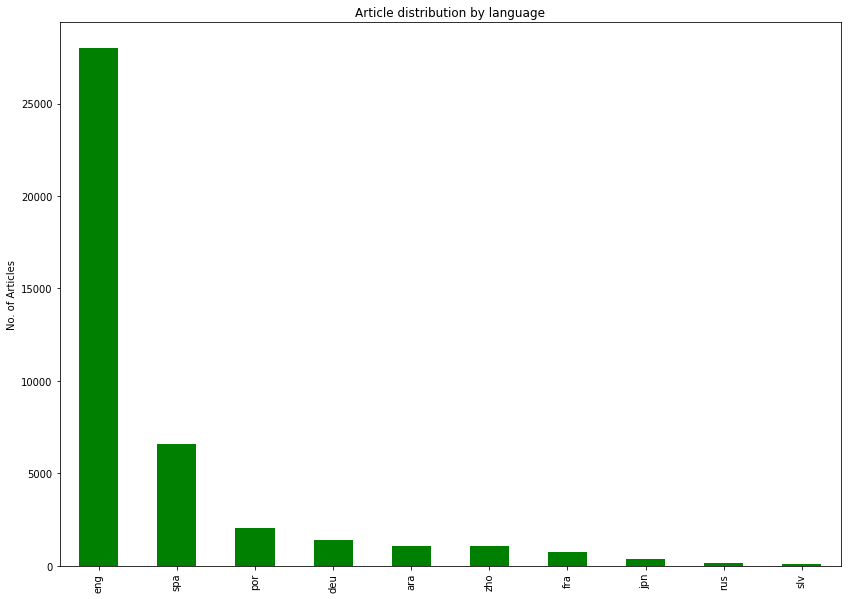

In [ ]:
df_concepts['kobe_bryant;helicopter']['lang'].value_counts().plot(kind='bar', title='Article distribution by language', ylabel='No. of Articles', figsize=(14,10), color='green')

<AxesSubplot:title={'center':'Article distribution by source'}, ylabel='No. of Articles'>

/home/matevzm/.local/lib/python3.8/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 19977 (\N{CJK UNIFIED IDEOGRAPH-4E09}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/matevzm/.local/lib/python3.8/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 31435 (\N{CJK UNIFIED IDEOGRAPH-7ACB}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/matevzm/.local/lib/python3.8/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 26032 (\N{CJK UNIFIED IDEOGRAPH-65B0}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/matevzm/.local/lib/python3.8/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 32862 (\N{CJK UNIFIED IDEOGRAPH-805E}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/matevzm/.local/lib/python3.8/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 39321 (\N{CJK UNIFIED IDEOGRAPH-9999}) missing from current font.
  

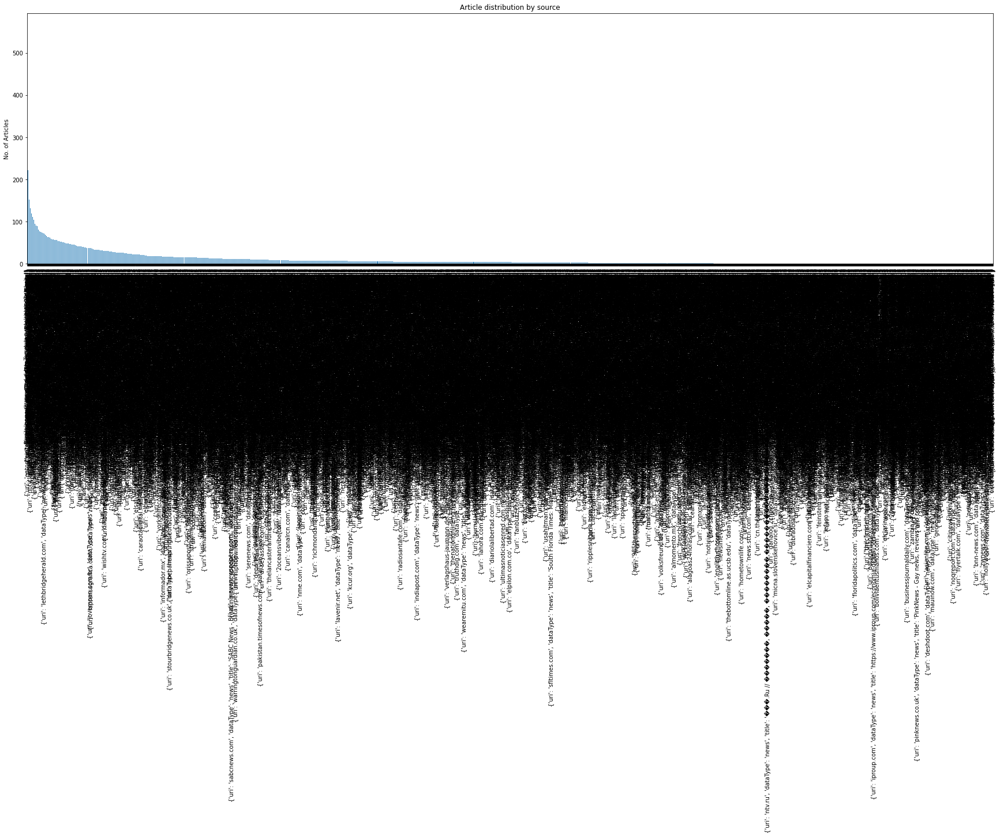

In [ ]:
df_concepts['kobe_bryant;helicopter'].source.value_counts().plot(kind='bar', title='Article distribution by source', ylabel='No. of Articles', figsize=(30, 8) )

In [ ]:
df_concepts['kobe_bryant;helicopter']['isDuplicate'].value_counts()

False    26499
True     15088
Name: isDuplicate, dtype: int64

In [ ]:
df_concepts['panama_papers']

,concepts,source,eventUri,lang,dateTime,isDuplicate
55,panama_papers,"{'uri': 'orf.at', 'dataType': 'news', 'title':...",6.067376e+09,deu,2020-05-14 13:18:00,False
56,panama_papers,"{'uri': 'watson.ch', 'dataType': 'news', 'titl...",6.067378e+09,deu,2020-05-14 13:20:00,False
57,panama_papers,"{'uri': 'derstandard.de', 'dataType': 'news', ...",6.069605e+09,deu,2020-05-16 10:16:00,False
58,panama_papers,"{'uri': 'sueddeutsche.de', 'dataType': 'news',...",6.072419e+09,deu,2020-05-19 02:56:00,False
59,panama_papers,"{'uri': 'n-tv.de', 'dataType': 'news', 'title'...",6.072479e+09,deu,2020-05-19 04:24:00,False
...,...,...,...,...,...,...
2518136,panama_papers,"{'uri': 'visao.sapo.pt', 'dataType': 'news', '...",6.781225e+09,por,2021-10-24 14:06:00,False
2518137,panama_papers,"{'uri': 'wort.lu', 'dataType': 'news', 'title'...",6.783718e+09,por,2021-10-26 11:20:00,False
2518901,panama_papers,"{'uri': 'mag.sapo.pt', 'dataType': 'news', 'ti...",6.824619e+09,por,2021-11-25 16:48:00,False
2518902,panama_papers,"{'uri': 'estadodaarte.estadao.com.br', 'dataTy...",6.826668e+09,por,2021-11-27 08:59:00,False


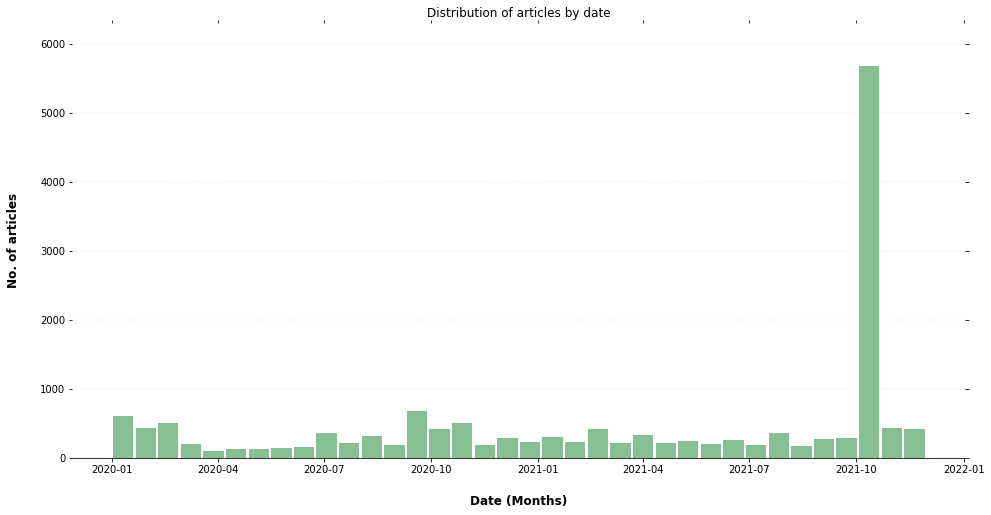

In [ ]:
ax = df_concepts['panama_papers'].hist(column='dateTime', bins=36, grid=False, figsize=(16,8), color='#86bf91', zorder=2, rwidth=0.9)

ax = ax[0]
for x in ax:

    # Despine
    x.spines['right'].set_visible(False)
    x.spines['top'].set_visible(False)
    x.spines['left'].set_visible(False)

    # Switch off ticks
    x.tick_params(axis="both", which="both", bottom="off", top="off", labelbottom="on", left="off", right="off", labelleft="on")

    # Draw horizontal axis lines
    vals = x.get_yticks()
    for tick in vals:
        x.axhline(y=tick, linestyle='dashed', alpha=0.4, color='#eeeeee', zorder=1)

    # Remove title
    x.set_title("Distribution of articles by date")

    # Set x-axis label
    x.set_xlabel("Date (Months)", labelpad=20, weight='bold', size=12)

    # Set y-axis label
    x.set_ylabel("No. of articles", labelpad=20, weight='bold', size=12)

   

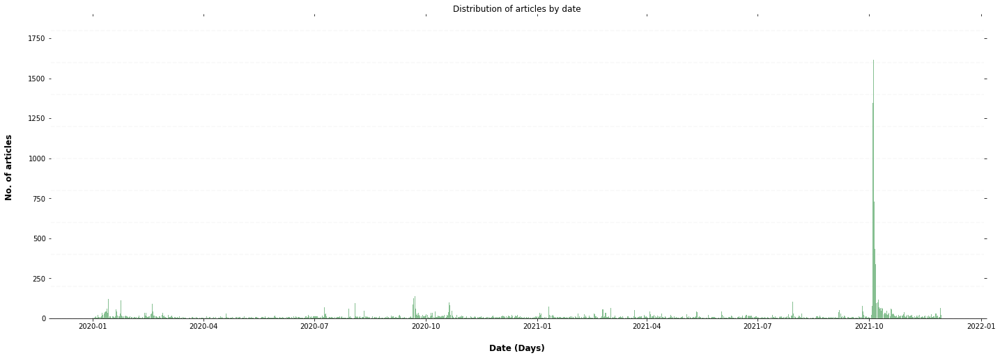

In [ ]:
ax = df_concepts['panama_papers'].hist(column='dateTime', bins=1080, grid=False, figsize=(24,8), color='#86bf91', zorder=2, rwidth=0.9)

ax = ax[0]
for x in ax:

    # Despine
    x.spines['right'].set_visible(False)
    x.spines['top'].set_visible(False)
    x.spines['left'].set_visible(False)

    # Switch off ticks
    x.tick_params(axis="both", which="both", bottom="off", top="off", labelbottom="on", left="off", right="off", labelleft="on")

    # Draw horizontal axis lines
    vals = x.get_yticks()
    for tick in vals:
        x.axhline(y=tick, linestyle='dashed', alpha=0.4, color='#eeeeee', zorder=1)

    # Remove title
    x.set_title("Distribution of articles by date")

    # Set x-axis label
    x.set_xlabel("Date (Days)", labelpad=20, weight='bold', size=12)

    # Set y-axis label
    x.set_ylabel("No. of articles", labelpad=20, weight='bold', size=12)

  

<AxesSubplot:title={'center':'Article distribution by language'}, ylabel='No. of Articles'>

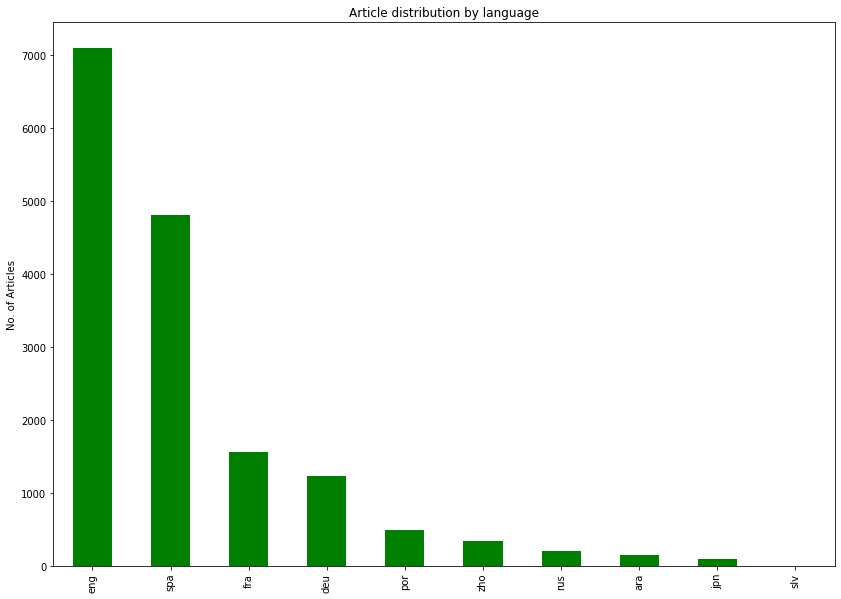

In [ ]:
df_concepts['panama_papers']['lang'].value_counts().plot(kind='bar', title='Article distribution by language', ylabel='No. of Articles', figsize=(14,10), color='green')

<AxesSubplot:title={'center':'Article distribution by source'}, ylabel='No. of Articles'>

/home/matevzm/.local/lib/python3.8/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 30475 (\N{CJK UNIFIED IDEOGRAPH-770B}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/matevzm/.local/lib/python3.8/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 20013 (\N{CJK UNIFIED IDEOGRAPH-4E2D}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/matevzm/.local/lib/python3.8/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 22269 (\N{CJK UNIFIED IDEOGRAPH-56FD}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/matevzm/.local/lib/python3.8/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 32879 (\N{CJK UNIFIED IDEOGRAPH-806F}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/matevzm/.local/lib/python3.8/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 21512 (\N{CJK UNIFIED IDEOGRAPH-5408}) missing from current font.
  

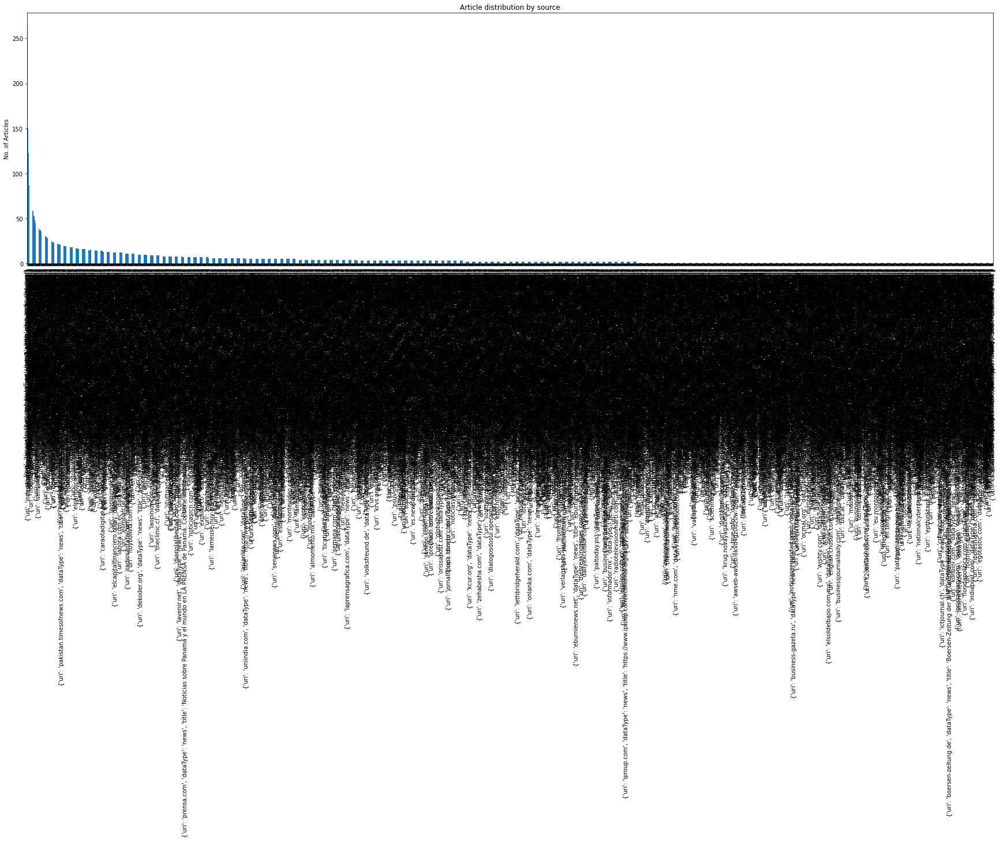

In [ ]:
df_concepts['panama_papers'].source.value_counts().plot(kind='bar', title='Article distribution by source', ylabel='No. of Articles', figsize=(30, 8) )

In [ ]:
df_concepts['panama_papers']['isDuplicate'].value_counts()

False    11982
True      3999
Name: isDuplicate, dtype: int64

In [ ]:
df_concepts['olympic_games;japan;judo']

,concepts,source,eventUri,lang,dateTime,isDuplicate
85613,olympic_games;japan;judo,"{'uri': 'mopo.de', 'dataType': 'news', 'title'...",6.694229e+09,deu,2021-08-19 10:09:00,False
100060,olympic_games;japan;judo,"{'uri': 'hz.de', 'dataType': 'news', 'title': ...",6.684814e+09,deu,2021-08-12 01:05:00,False
100061,olympic_games;japan;judo,"{'uri': 'nd-aktuell.de', 'dataType': 'news', '...",6.687138e+09,deu,2021-08-13 15:27:00,False
100062,olympic_games;japan;judo,"{'uri': 'lvz.de', 'dataType': 'news', 'title':...",6.687385e+09,deu,2021-08-13 19:33:00,False
100063,olympic_games;japan;judo,"{'uri': 'bild.de', 'dataType': 'news', 'title'...",6.688480e+09,deu,2021-08-14 21:05:00,False
...,...,...,...,...,...,...
2505452,olympic_games;japan;judo,"{'uri': 'publico.pt', 'dataType': 'news', 'tit...",6.656958e+09,por,2021-07-21 22:46:00,False
2505453,olympic_games;japan;judo,"{'uri': 'uol.com.br', 'dataType': 'news', 'tit...",6.656959e+09,por,2021-07-21 22:47:00,False
2505454,olympic_games;japan;judo,"{'uri': 'diariodonordeste.verdesmares.com.br',...",6.656966e+09,por,2021-07-21 22:58:00,False
2505455,olympic_games;japan;judo,"{'uri': 'atribunanews.com.br', 'dataType': 'ne...",6.656975e+09,por,2021-07-21 23:10:00,False


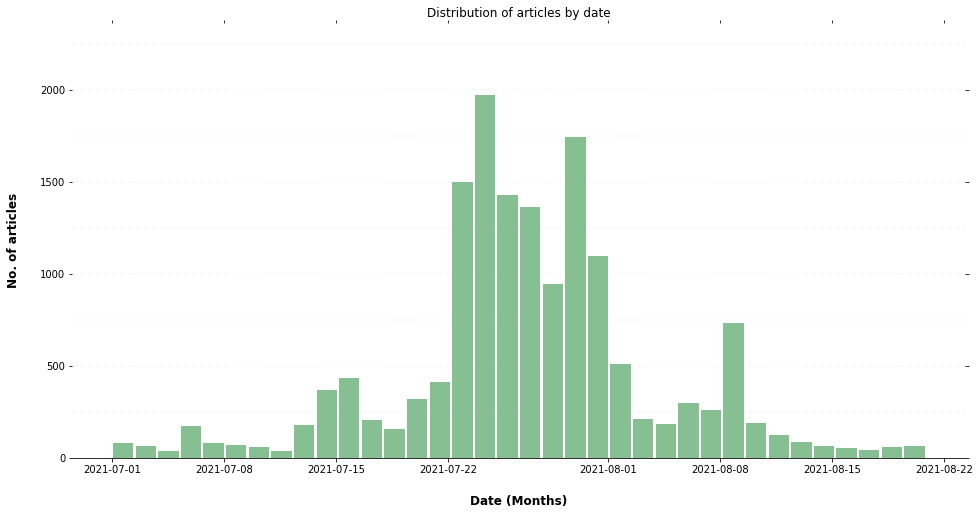

In [ ]:
ax = df_concepts['olympic_games;japan;judo'].hist(column='dateTime', bins=36, grid=False, figsize=(16,8), color='#86bf91', zorder=2, rwidth=0.9)

ax = ax[0]
for x in ax:

    # Despine
    x.spines['right'].set_visible(False)
    x.spines['top'].set_visible(False)
    x.spines['left'].set_visible(False)

    # Switch off ticks
    x.tick_params(axis="both", which="both", bottom="off", top="off", labelbottom="on", left="off", right="off", labelleft="on")

    # Draw horizontal axis lines
    vals = x.get_yticks()
    for tick in vals:
        x.axhline(y=tick, linestyle='dashed', alpha=0.4, color='#eeeeee', zorder=1)

    # Remove title
    x.set_title("Distribution of articles by date")

    # Set x-axis label
    x.set_xlabel("Date (Months)", labelpad=20, weight='bold', size=12)

    # Set y-axis label
    x.set_ylabel("No. of articles", labelpad=20, weight='bold', size=12)

  

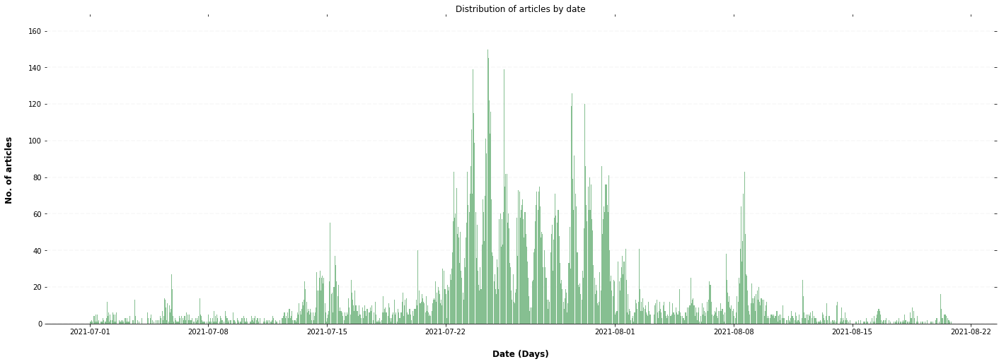

In [ ]:
ax = df_concepts['olympic_games;japan;judo'].hist(column='dateTime', bins=1080, grid=False, figsize=(24,8), color='#86bf91', zorder=2, rwidth=0.9)

ax = ax[0]
for x in ax:

    # Despine
    x.spines['right'].set_visible(False)
    x.spines['top'].set_visible(False)
    x.spines['left'].set_visible(False)

    # Switch off ticks
    x.tick_params(axis="both", which="both", bottom="off", top="off", labelbottom="on", left="off", right="off", labelleft="on")

    # Draw horizontal axis lines
    vals = x.get_yticks()
    for tick in vals:
        x.axhline(y=tick, linestyle='dashed', alpha=0.4, color='#eeeeee', zorder=1)

    # Remove title
    x.set_title("Distribution of articles by date")

    # Set x-axis label
    x.set_xlabel("Date (Days)", labelpad=20, weight='bold', size=12)

    # Set y-axis label
    x.set_ylabel("No. of articles", labelpad=20, weight='bold', size=12)

  

<AxesSubplot:title={'center':'Article distribution by language'}, ylabel='No. of Articles'>

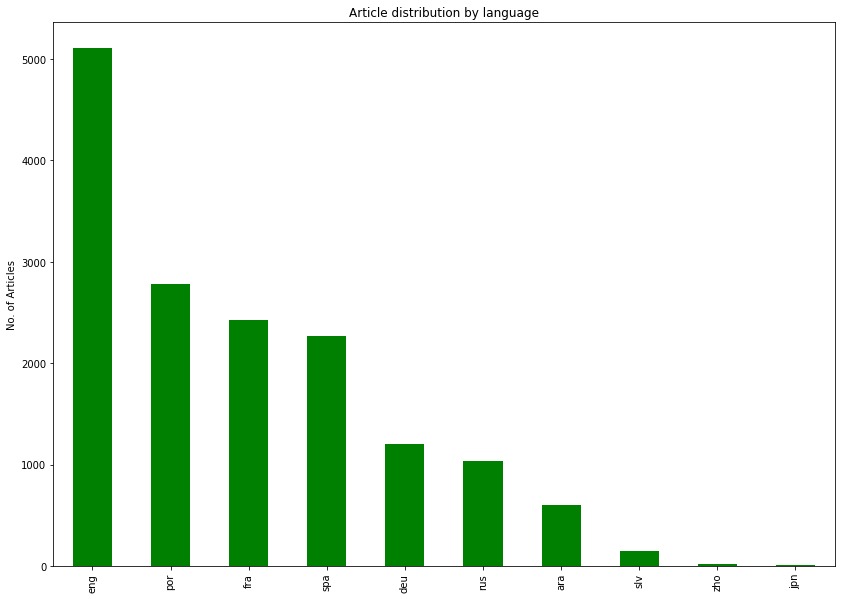

In [ ]:
df_concepts['olympic_games;japan;judo']['lang'].value_counts().plot(kind='bar', title='Article distribution by language', ylabel='No. of Articles', figsize=(14,10), color='green')

<AxesSubplot:title={'center':'Article distribution by source'}, ylabel='No. of Articles'>

/home/matevzm/.local/lib/python3.8/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 27598 (\N{CJK UNIFIED IDEOGRAPH-6BCE}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/matevzm/.local/lib/python3.8/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 26085 (\N{CJK UNIFIED IDEOGRAPH-65E5}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/matevzm/.local/lib/python3.8/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 26032 (\N{CJK UNIFIED IDEOGRAPH-65B0}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/matevzm/.local/lib/python3.8/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 32862 (\N{CJK UNIFIED IDEOGRAPH-805E}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/matevzm/.local/lib/python3.8/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 26397 (\N{CJK UNIFIED IDEOGRAPH-671D}) missing from current font.
  

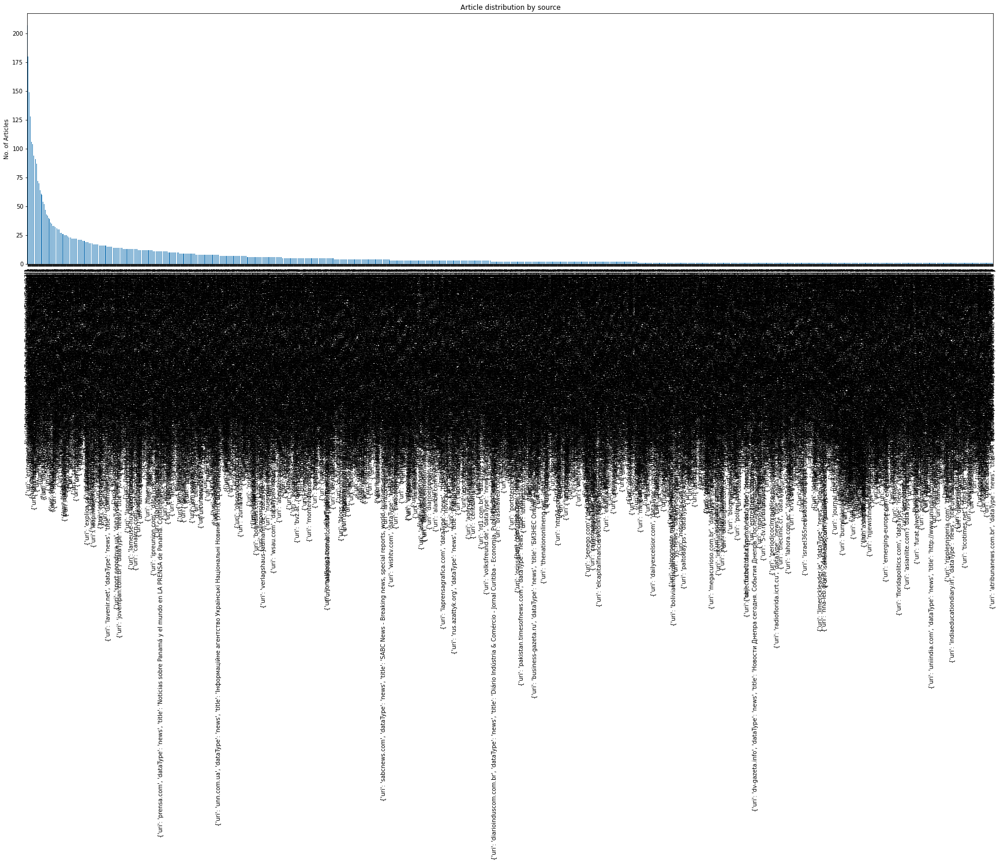

In [ ]:
df_concepts['olympic_games;japan;judo'].source.value_counts().plot(kind='bar', title='Article distribution by source', ylabel='No. of Articles', figsize=(30, 8) )

In [ ]:
df_concepts['olympic_games;japan;judo']['isDuplicate'].value_counts()

False    10190
True      5389
Name: isDuplicate, dtype: int64

In [ ]:
df_concepts['olympic_games;japan;skateboarding']

,concepts,source,eventUri,lang,dateTime,isDuplicate
332740,olympic_games;japan;skateboarding,"{'uri': 'as.com', 'dataType': 'news', 'title':...",6.695388e+09,spa,2021-08-20 06:37:00,False
376055,olympic_games;japan;skateboarding,"{'uri': 'entornointeligente.com', 'dataType': ...",6.657079e+09,spa,2021-07-22 01:48:00,False
376056,olympic_games;japan;skateboarding,"{'uri': 'us.marca.com', 'dataType': 'news', 't...",6.657101e+09,spa,2021-07-22 02:22:00,False
376057,olympic_games;japan;skateboarding,"{'uri': 'el-mexicano.com.mx', 'dataType': 'new...",6.657141e+09,spa,2021-07-22 03:21:00,False
376058,olympic_games;japan;skateboarding,"{'uri': 'eleconomista.com.mx', 'dataType': 'ne...",6.657230e+09,spa,2021-07-22 05:14:00,False
...,...,...,...,...,...,...
2507094,olympic_games;japan;skateboarding,"{'uri': 'uol.com.br', 'dataType': 'news', 'tit...",6.656884e+09,por,2021-07-21 21:13:00,True
2507095,olympic_games;japan;skateboarding,"{'uri': 'desporto.sapo.pt', 'dataType': 'news'...",6.656901e+09,por,2021-07-21 21:32:00,False
2507096,olympic_games;japan;skateboarding,"{'uri': 'folhadelondrina.com.br', 'dataType': ...",6.656939e+09,por,2021-07-21 22:20:00,False
2507097,olympic_games;japan;skateboarding,"{'uri': 'noticiasaominuto.com.br', 'dataType':...",6.656942e+09,por,2021-07-21 22:25:00,True


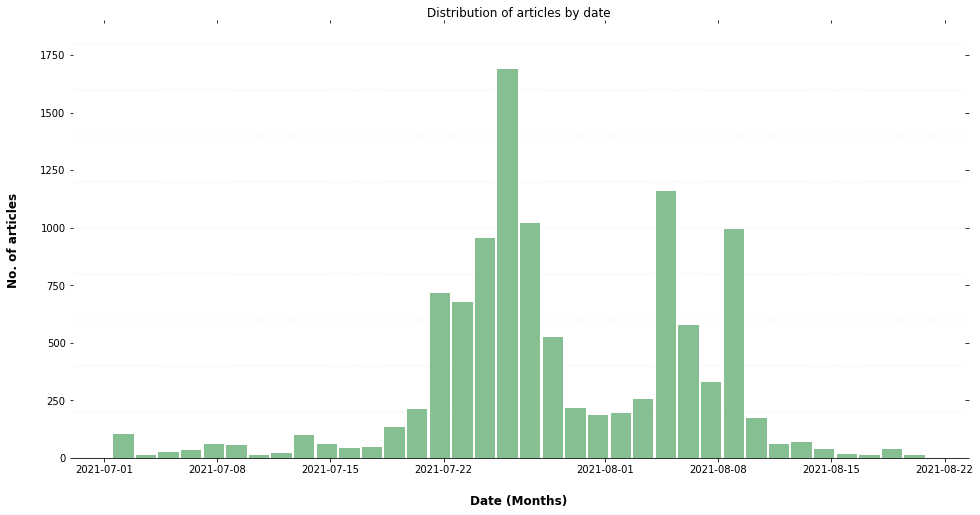

In [ ]:
ax = df_concepts['olympic_games;japan;skateboarding'].hist(column='dateTime', bins=36, grid=False, figsize=(16,8), color='#86bf91', zorder=2, rwidth=0.9)

ax = ax[0]
for x in ax:

    # Despine
    x.spines['right'].set_visible(False)
    x.spines['top'].set_visible(False)
    x.spines['left'].set_visible(False)

    # Switch off ticks
    x.tick_params(axis="both", which="both", bottom="off", top="off", labelbottom="on", left="off", right="off", labelleft="on")

    # Draw horizontal axis lines
    vals = x.get_yticks()
    for tick in vals:
        x.axhline(y=tick, linestyle='dashed', alpha=0.4, color='#eeeeee', zorder=1)

    # Remove title
    x.set_title("Distribution of articles by date")

    # Set x-axis label
    x.set_xlabel("Date (Months)", labelpad=20, weight='bold', size=12)

    # Set y-axis label
    x.set_ylabel("No. of articles", labelpad=20, weight='bold', size=12)

  

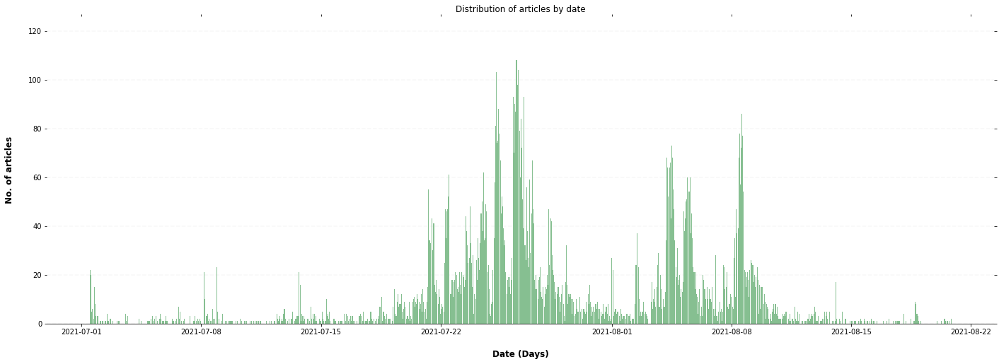

In [ ]:
ax = df_concepts['olympic_games;japan;skateboarding'].hist(column='dateTime', bins=1080, grid=False, figsize=(24,8), color='#86bf91', zorder=2, rwidth=0.9)

ax = ax[0]
for x in ax:

    # Despine
    x.spines['right'].set_visible(False)
    x.spines['top'].set_visible(False)
    x.spines['left'].set_visible(False)

    # Switch off ticks
    x.tick_params(axis="both", which="both", bottom="off", top="off", labelbottom="on", left="off", right="off", labelleft="on")

    # Draw horizontal axis lines
    vals = x.get_yticks()
    for tick in vals:
        x.axhline(y=tick, linestyle='dashed', alpha=0.4, color='#eeeeee', zorder=1)

    # Remove title
    x.set_title("Distribution of articles by date")

    # Set x-axis label
    x.set_xlabel("Date (Days)", labelpad=20, weight='bold', size=12)

    # Set y-axis label
    x.set_ylabel("No. of articles", labelpad=20, weight='bold', size=12)

  
    

<AxesSubplot:title={'center':'Article distribution by language'}, ylabel='No. of Articles'>

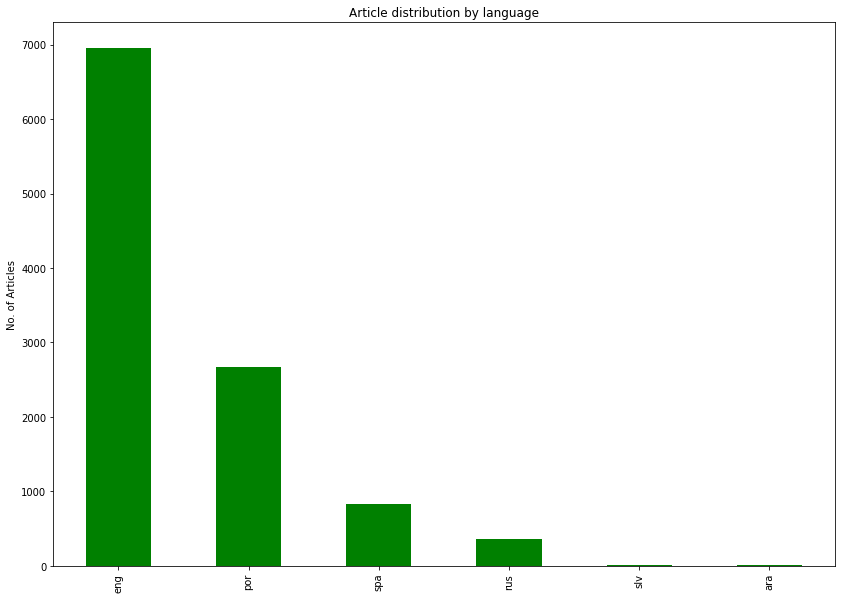

In [ ]:
df_concepts['olympic_games;japan;skateboarding']['lang'].value_counts().plot(kind='bar', title='Article distribution by language', ylabel='No. of Articles', figsize=(14,10), color='green')

<AxesSubplot:title={'center':'Article distribution by source'}, ylabel='No. of Articles'>

/home/matevzm/.local/lib/python3.8/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 27598 (\N{CJK UNIFIED IDEOGRAPH-6BCE}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/matevzm/.local/lib/python3.8/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 26085 (\N{CJK UNIFIED IDEOGRAPH-65E5}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/matevzm/.local/lib/python3.8/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 26032 (\N{CJK UNIFIED IDEOGRAPH-65B0}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/matevzm/.local/lib/python3.8/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 32862 (\N{CJK UNIFIED IDEOGRAPH-805E}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/matevzm/.local/lib/python3.8/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 26397 (\N{CJK UNIFIED IDEOGRAPH-671D}) missing from current font.
  

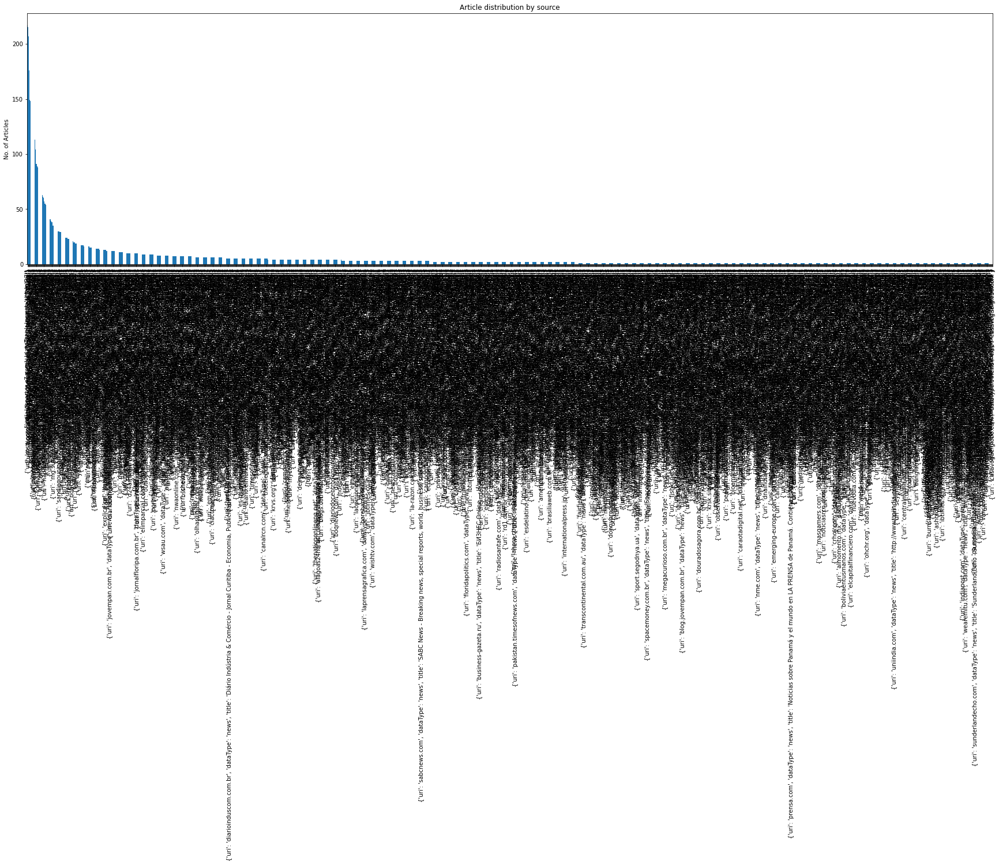

In [ ]:
df_concepts['olympic_games;japan;skateboarding'].source.value_counts().plot(kind='bar', title='Article distribution by source', ylabel='No. of Articles', figsize=(30, 8) )

In [ ]:
df_concepts['olympic_games;japan;skateboarding']['isDuplicate'].value_counts()

False    6526
True     4307
Name: isDuplicate, dtype: int64

In [ ]:
df_concepts['olympic_games;japan;rowing']

,concepts,source,eventUri,lang,dateTime,isDuplicate
4267,olympic_games;japan;rowing,"{'uri': 'swr.de', 'dataType': 'news', 'title':...",6.638899e+09,deu,2021-07-08 15:13:00,False
4268,olympic_games;japan;rowing,"{'uri': 'sportbuzzer.de', 'dataType': 'news', ...",6.640181e+09,deu,2021-07-09 12:23:00,False
4269,olympic_games;japan;rowing,"{'uri': 'sportbuzzer.de', 'dataType': 'news', ...",6.640417e+09,deu,2021-07-09 15:25:00,False
4270,olympic_games;japan;rowing,"{'uri': 'merkur.de', 'dataType': 'news', 'titl...",6.641458e+09,deu,2021-07-10 12:28:00,False
4271,olympic_games;japan;rowing,"{'uri': 'tz.de', 'dataType': 'news', 'title': ...",6.641466e+09,deu,2021-07-10 12:39:00,False
...,...,...,...,...,...,...
2478806,olympic_games;japan;rowing,"{'uri': 'paraibaonline.com.br', 'dataType': 'n...",6.635887e+09,por,2021-07-06 16:17:00,False
2478807,olympic_games;japan;rowing,"{'uri': 'noticiasaominuto.com.br', 'dataType':...",6.635925e+09,por,2021-07-06 16:46:00,True
2478808,olympic_games;japan;rowing,"{'uri': 'paranaportal.uol.com.br', 'dataType':...",6.635994e+09,por,2021-07-06 17:43:00,True
2478809,olympic_games;japan;rowing,"{'uri': 'esportes.r7.com', 'dataType': 'news',...",6.636019e+09,por,2021-07-06 18:06:00,False


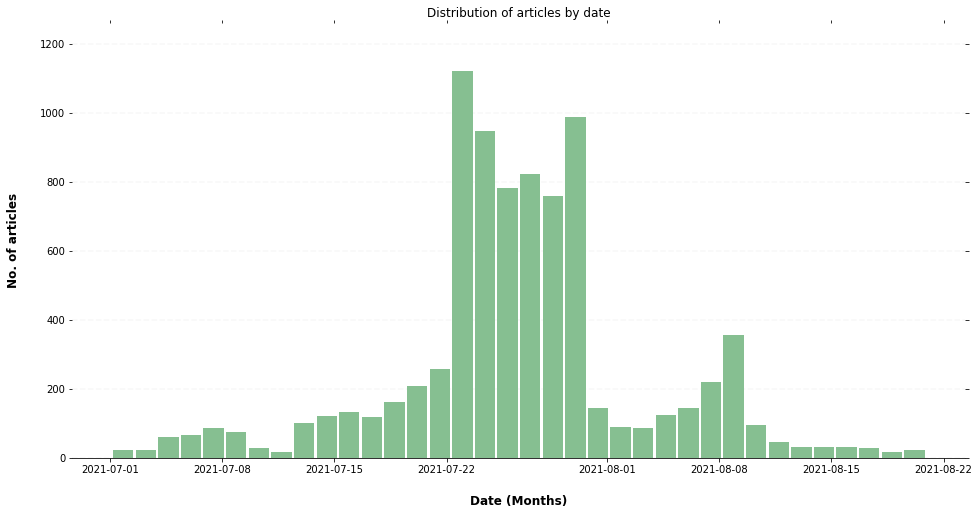

In [ ]:
ax = df_concepts['olympic_games;japan;rowing'].hist(column='dateTime', bins=36, grid=False, figsize=(16,8), color='#86bf91', zorder=2, rwidth=0.9)

ax = ax[0]
for x in ax:

    # Despine
    x.spines['right'].set_visible(False)
    x.spines['top'].set_visible(False)
    x.spines['left'].set_visible(False)

    # Switch off ticks
    x.tick_params(axis="both", which="both", bottom="off", top="off", labelbottom="on", left="off", right="off", labelleft="on")

    # Draw horizontal axis lines
    vals = x.get_yticks()
    for tick in vals:
        x.axhline(y=tick, linestyle='dashed', alpha=0.4, color='#eeeeee', zorder=1)

    # Remove title
    x.set_title("Distribution of articles by date")

    # Set x-axis label
    x.set_xlabel("Date (Months)", labelpad=20, weight='bold', size=12)

    # Set y-axis label
    x.set_ylabel("No. of articles", labelpad=20, weight='bold', size=12)

  

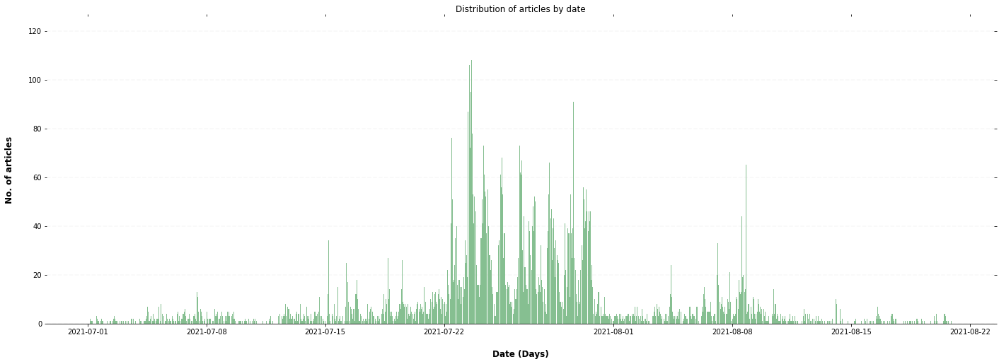

In [ ]:
ax = df_concepts['olympic_games;japan;rowing'].hist(column='dateTime', bins=1080, grid=False, figsize=(24,8), color='#86bf91', zorder=2, rwidth=0.9)

ax = ax[0]
for x in ax:

    # Despine
    x.spines['right'].set_visible(False)
    x.spines['top'].set_visible(False)
    x.spines['left'].set_visible(False)

    # Switch off ticks
    x.tick_params(axis="both", which="both", bottom="off", top="off", labelbottom="on", left="off", right="off", labelleft="on")

    # Draw horizontal axis lines
    vals = x.get_yticks()
    for tick in vals:
        x.axhline(y=tick, linestyle='dashed', alpha=0.4, color='#eeeeee', zorder=1)

    # Remove title
    x.set_title("Distribution of articles by date")

    # Set x-axis label
    x.set_xlabel("Date (Days)", labelpad=20, weight='bold', size=12)

    # Set y-axis label
    x.set_ylabel("No. of articles", labelpad=20, weight='bold', size=12)

   

<AxesSubplot:title={'center':'Article distribution by language'}, ylabel='No. of Articles'>

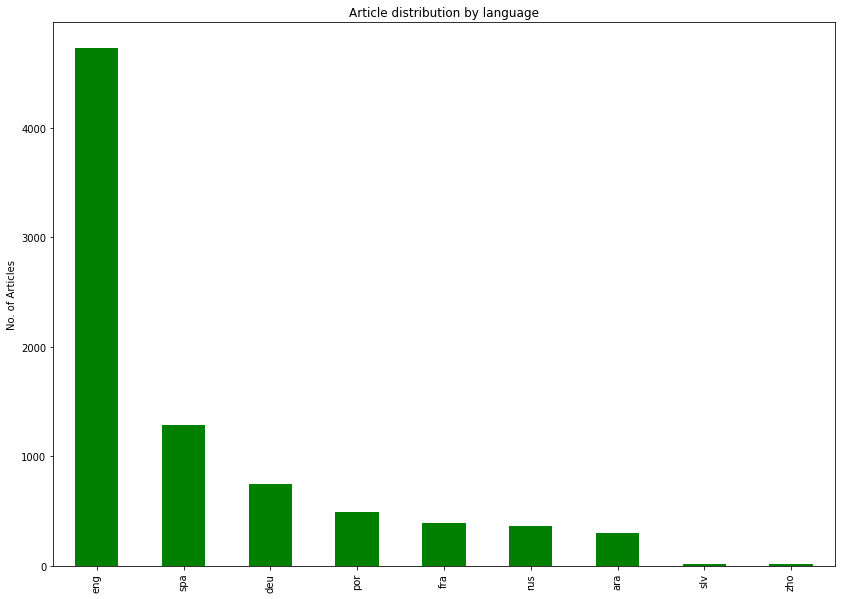

In [ ]:
df_concepts['olympic_games;japan;rowing']['lang'].value_counts().plot(kind='bar', title='Article distribution by language', ylabel='No. of Articles', figsize=(14,10), color='green')

<AxesSubplot:title={'center':'Article distribution by source'}, ylabel='No. of Articles'>

/home/matevzm/.local/lib/python3.8/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 27598 (\N{CJK UNIFIED IDEOGRAPH-6BCE}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/matevzm/.local/lib/python3.8/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 26085 (\N{CJK UNIFIED IDEOGRAPH-65E5}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/matevzm/.local/lib/python3.8/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 26032 (\N{CJK UNIFIED IDEOGRAPH-65B0}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/matevzm/.local/lib/python3.8/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 32862 (\N{CJK UNIFIED IDEOGRAPH-805E}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/matevzm/.local/lib/python3.8/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 21326 (\N{CJK UNIFIED IDEOGRAPH-534E}) missing from current font.
  

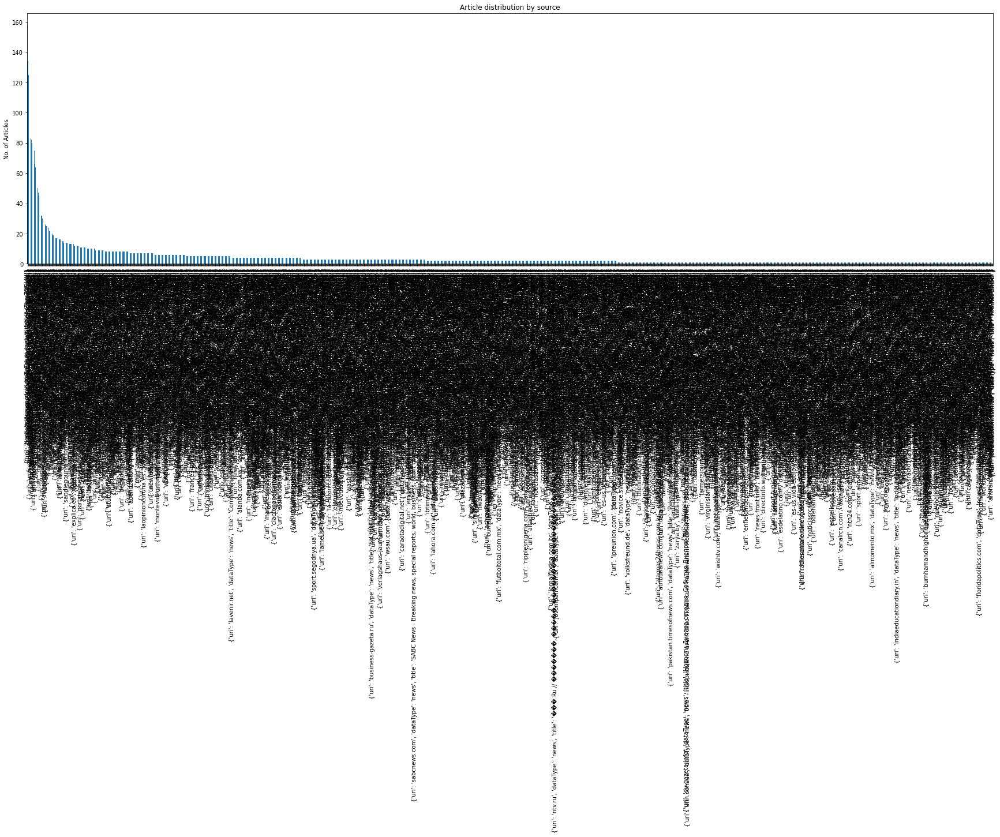

In [ ]:
df_concepts['olympic_games;japan;rowing'].source.value_counts().plot(kind='bar', title='Article distribution by source', ylabel='No. of Articles', figsize=(30, 8) )

In [ ]:
df_concepts['olympic_games;japan;rowing']['isDuplicate'].value_counts()

False    5012
True     3342
Name: isDuplicate, dtype: int64

In [ ]:
df_concepts['association_football;uefa_european_championship']

,concepts,source,eventUri,lang,dateTime,isDuplicate
5448,association_football;uefa_european_championship,"{'uri': 'swr.de', 'dataType': 'news', 'title':...",6.150893e+09,deu,2020-07-20 07:10:00,False
5449,association_football;uefa_european_championship,"{'uri': 'az.com.na', 'dataType': 'news', 'titl...",6.150996e+09,deu,2020-07-20 08:46:00,False
5450,association_football;uefa_european_championship,"{'uri': 'sueddeutsche.de', 'dataType': 'news',...",6.151004e+09,deu,2020-07-20 08:54:00,False
5451,association_football;uefa_european_championship,"{'uri': 'kreiszeitung.de', 'dataType': 'news',...",6.151007e+09,deu,2020-07-20 08:56:00,False
5452,association_football;uefa_european_championship,"{'uri': 'welt.de', 'dataType': 'news', 'title'...",6.151013e+09,deu,2020-07-20 09:01:00,True
...,...,...,...,...,...,...
2514151,association_football;uefa_european_championship,"{'uri': 'uol.com.br', 'dataType': 'news', 'tit...",6.114186e+09,por,2020-06-21 11:47:00,False
2514152,association_football;uefa_european_championship,"{'uri': 'espn.com.br', 'dataType': 'news', 'ti...",6.114235e+09,por,2020-06-21 12:47:00,False
2514153,association_football;uefa_european_championship,"{'uri': 'diariodecuiaba.com.br', 'dataType': '...",6.114316e+09,por,2020-06-21 14:28:00,False
2514154,association_football;uefa_european_championship,"{'uri': 'chuteirafc.cartacapital.com.br', 'dat...",6.114335e+09,por,2020-06-21 14:47:00,False


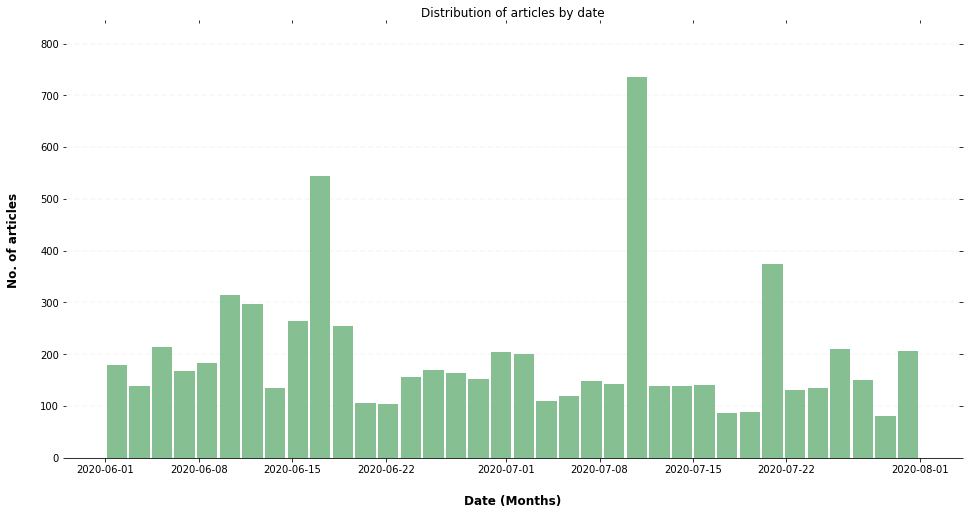

In [ ]:
ax = df_concepts['association_football;uefa_european_championship'].hist(column='dateTime', bins=36, grid=False, figsize=(16,8), color='#86bf91', zorder=2, rwidth=0.9)

ax = ax[0]
for x in ax:

    # Despine
    x.spines['right'].set_visible(False)
    x.spines['top'].set_visible(False)
    x.spines['left'].set_visible(False)

    # Switch off ticks
    x.tick_params(axis="both", which="both", bottom="off", top="off", labelbottom="on", left="off", right="off", labelleft="on")

    # Draw horizontal axis lines
    vals = x.get_yticks()
    for tick in vals:
        x.axhline(y=tick, linestyle='dashed', alpha=0.4, color='#eeeeee', zorder=1)

    # Remove title
    x.set_title("Distribution of articles by date")

    # Set x-axis label
    x.set_xlabel("Date (Months)", labelpad=20, weight='bold', size=12)

    # Set y-axis label
    x.set_ylabel("No. of articles", labelpad=20, weight='bold', size=12)

  

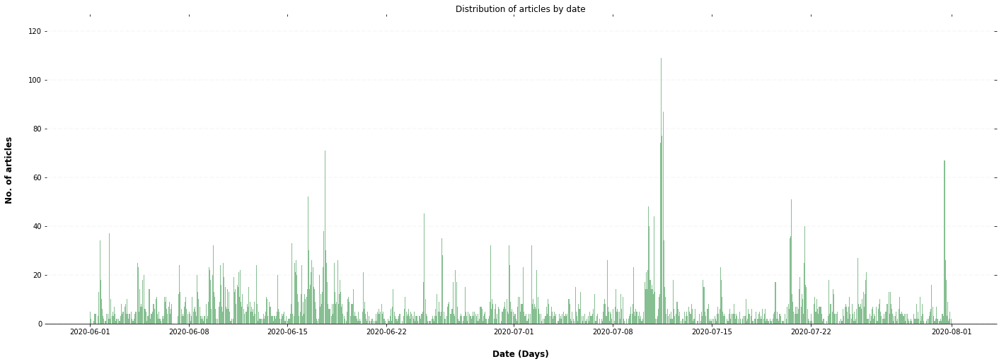

In [ ]:
ax = df_concepts['association_football;uefa_european_championship'].hist(column='dateTime', bins=1080, grid=False, figsize=(24,8), color='#86bf91', zorder=2, rwidth=0.9)

ax = ax[0]
for x in ax:

    # Despine
    x.spines['right'].set_visible(False)
    x.spines['top'].set_visible(False)
    x.spines['left'].set_visible(False)

    # Switch off ticks
    x.tick_params(axis="both", which="both", bottom="off", top="off", labelbottom="on", left="off", right="off", labelleft="on")

    # Draw horizontal axis lines
    vals = x.get_yticks()
    for tick in vals:
        x.axhline(y=tick, linestyle='dashed', alpha=0.4, color='#eeeeee', zorder=1)

    # Remove title
    x.set_title("Distribution of articles by date")

    # Set x-axis label
    x.set_xlabel("Date (Days)", labelpad=20, weight='bold', size=12)

    # Set y-axis label
    x.set_ylabel("No. of articles", labelpad=20, weight='bold', size=12)

  

<AxesSubplot:title={'center':'Article distribution by language'}, ylabel='No. of Articles'>

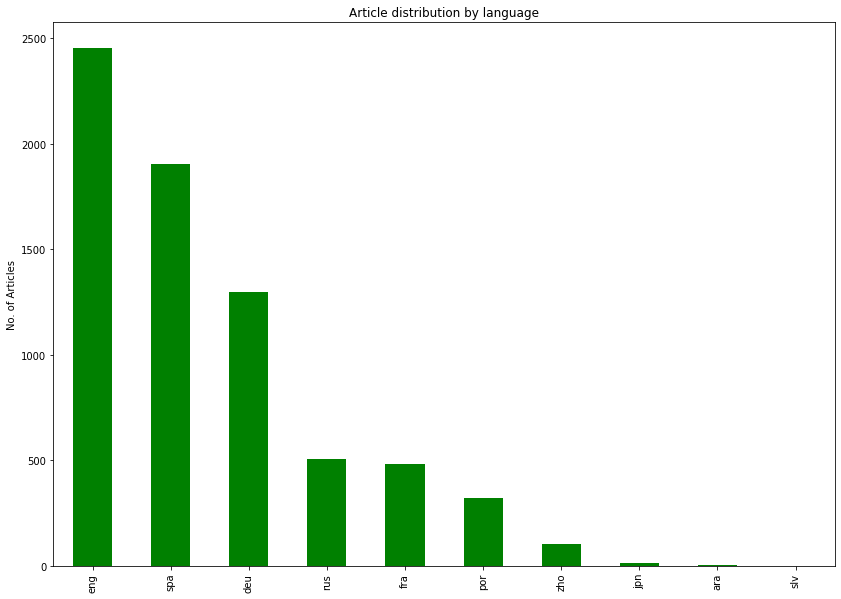

In [ ]:
df_concepts['association_football;uefa_european_championship']['lang'].value_counts().plot(kind='bar', title='Article distribution by language', ylabel='No. of Articles', figsize=(14,10), color='green')

<AxesSubplot:title={'center':'Article distribution by source'}, ylabel='No. of Articles'>

/home/matevzm/.local/lib/python3.8/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 32593 (\N{CJK UNIFIED IDEOGRAPH-7F51}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/matevzm/.local/lib/python3.8/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 26131 (\N{CJK UNIFIED IDEOGRAPH-6613}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/matevzm/.local/lib/python3.8/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 25196 (\N{CJK UNIFIED IDEOGRAPH-626C}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/matevzm/.local/lib/python3.8/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 23376 (\N{CJK UNIFIED IDEOGRAPH-5B50}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/matevzm/.local/lib/python3.8/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 65288 (\N{FULLWIDTH LEFT PARENTHESIS}) missing from current font.
  

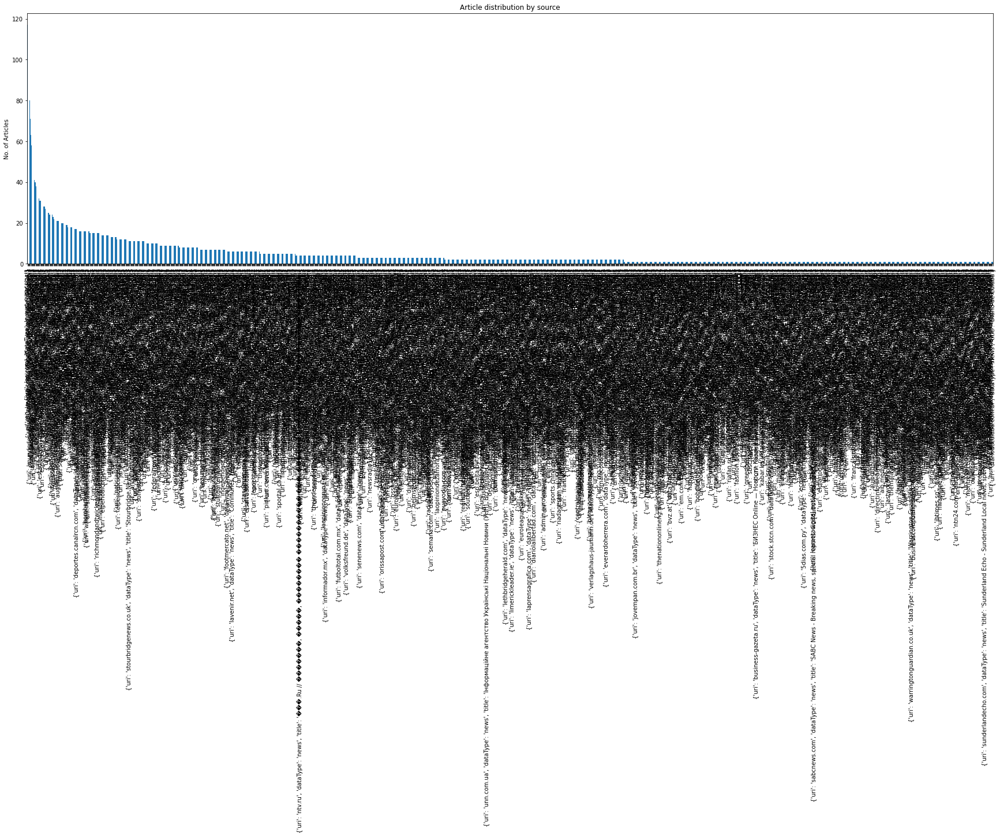

In [ ]:
df_concepts['association_football;uefa_european_championship'].source.value_counts().plot(kind='bar', title='Article distribution by source', ylabel='No. of Articles', figsize=(30, 8) )

In [ ]:
df_concepts['association_football;uefa_european_championship']['isDuplicate'].value_counts()

False    4595
True     2488
Name: isDuplicate, dtype: int64

In [ ]:
df_concepts['olympic_games;japan;table_tennis']

,concepts,source,eventUri,lang,dateTime,isDuplicate
11879,olympic_games;japan;table_tennis,"{'uri': 'schwaebische.de', 'dataType': 'news',...",6.647776e+09,deu,2021-07-15 04:17:00,True
11880,olympic_games;japan;table_tennis,"{'uri': 'donaukurier.de', 'dataType': 'news', ...",6.647777e+09,deu,2021-07-15 04:18:00,True
11881,olympic_games;japan;table_tennis,"{'uri': 'sueddeutsche.de', 'dataType': 'news',...",6.647779e+09,deu,2021-07-15 04:21:00,True
11882,olympic_games;japan;table_tennis,"{'uri': 'wn.de', 'dataType': 'news', 'title': ...",6.647781e+09,deu,2021-07-15 04:24:00,True
11883,olympic_games;japan;table_tennis,"{'uri': 'bnn.de', 'dataType': 'news', 'title':...",6.647782e+09,deu,2021-07-15 04:24:00,True
...,...,...,...,...,...,...
2503161,olympic_games;japan;table_tennis,"{'uri': 'folhadelondrina.com.br', 'dataType': ...",6.691793e+09,por,2021-08-17 15:14:00,True
2503162,olympic_games;japan;table_tennis,"{'uri': 'folha.uol.com.br', 'dataType': 'news'...",6.691846e+09,por,2021-08-17 16:00:00,False
2503163,olympic_games;japan;table_tennis,"{'uri': 'infomoney.com.br', 'dataType': 'news'...",6.691993e+09,por,2021-08-17 18:15:00,False
2503164,olympic_games;japan;table_tennis,"{'uri': 'ge.globo.com', 'dataType': 'news', 't...",6.693152e+09,por,2021-08-18 14:37:00,False


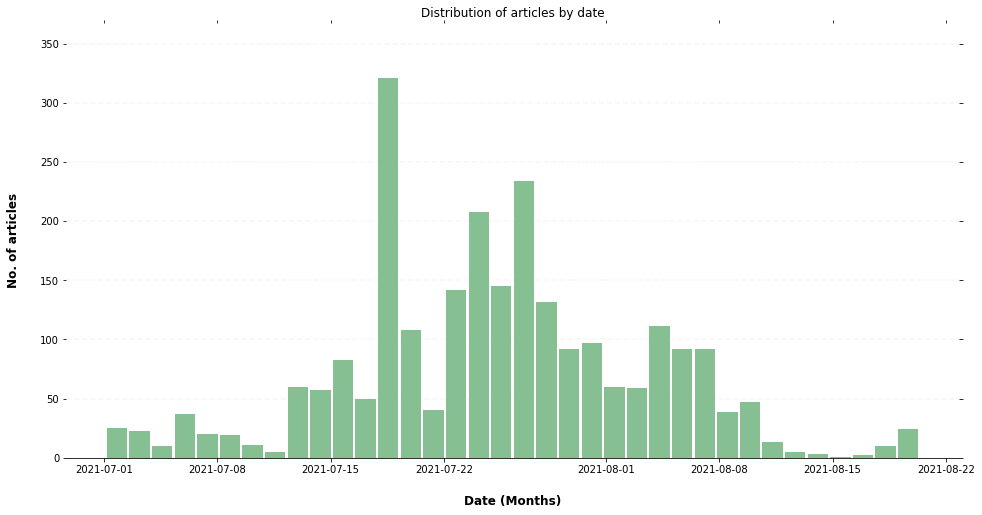

In [ ]:
ax = df_concepts['olympic_games;japan;table_tennis'].hist(column='dateTime', bins=36, grid=False, figsize=(16,8), color='#86bf91', zorder=2, rwidth=0.9)

ax = ax[0]
for x in ax:

    # Despine
    x.spines['right'].set_visible(False)
    x.spines['top'].set_visible(False)
    x.spines['left'].set_visible(False)

    # Switch off ticks
    x.tick_params(axis="both", which="both", bottom="off", top="off", labelbottom="on", left="off", right="off", labelleft="on")

    # Draw horizontal axis lines
    vals = x.get_yticks()
    for tick in vals:
        x.axhline(y=tick, linestyle='dashed', alpha=0.4, color='#eeeeee', zorder=1)

    # Remove title
    x.set_title("Distribution of articles by date")

    # Set x-axis label
    x.set_xlabel("Date (Months)", labelpad=20, weight='bold', size=12)

    # Set y-axis label
    x.set_ylabel("No. of articles", labelpad=20, weight='bold', size=12)

   

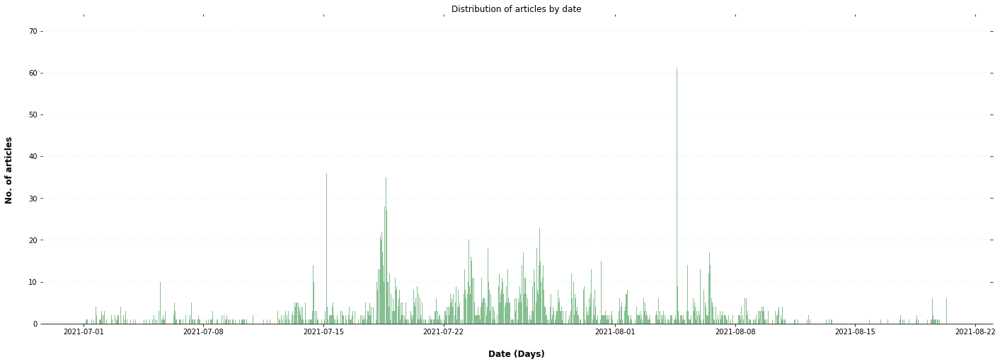

In [ ]:
ax = df_concepts['olympic_games;japan;table_tennis'].hist(column='dateTime', bins=1080, grid=False, figsize=(24,8), color='#86bf91', zorder=2, rwidth=0.9)

ax = ax[0]
for x in ax:

    # Despine
    x.spines['right'].set_visible(False)
    x.spines['top'].set_visible(False)
    x.spines['left'].set_visible(False)

    # Switch off ticks
    x.tick_params(axis="both", which="both", bottom="off", top="off", labelbottom="on", left="off", right="off", labelleft="on")

    # Draw horizontal axis lines
    vals = x.get_yticks()
    for tick in vals:
        x.axhline(y=tick, linestyle='dashed', alpha=0.4, color='#eeeeee', zorder=1)

    # Remove title
    x.set_title("Distribution of articles by date")

    # Set x-axis label
    x.set_xlabel("Date (Days)", labelpad=20, weight='bold', size=12)

    # Set y-axis label
    x.set_ylabel("No. of articles", labelpad=20, weight='bold', size=12)

   

<AxesSubplot:title={'center':'Article distribution by language'}, ylabel='No. of Articles'>

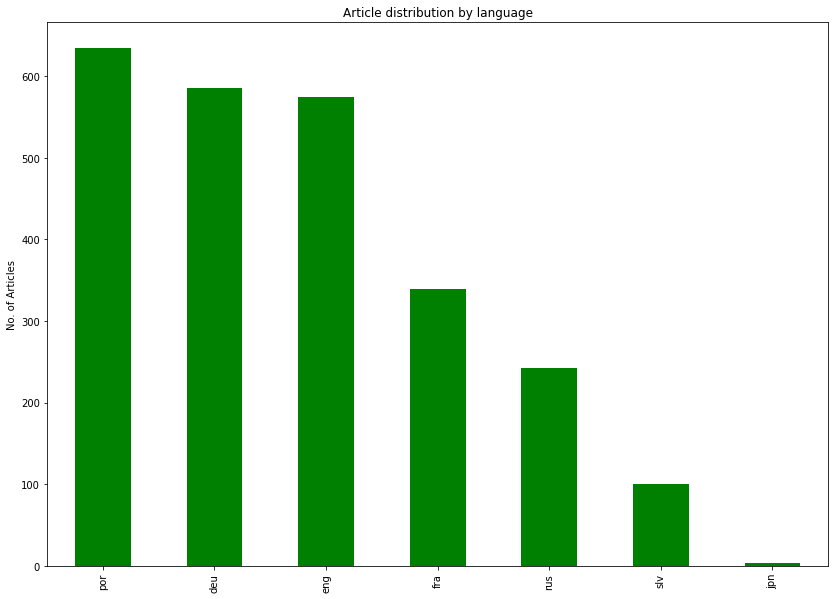

In [ ]:
df_concepts['olympic_games;japan;table_tennis']['lang'].value_counts().plot(kind='bar', title='Article distribution by language', ylabel='No. of Articles', figsize=(14,10), color='green')

<AxesSubplot:title={'center':'Article distribution by source'}, ylabel='No. of Articles'>

/home/matevzm/.local/lib/python3.8/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 26032 (\N{CJK UNIFIED IDEOGRAPH-65B0}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/matevzm/.local/lib/python3.8/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 21326 (\N{CJK UNIFIED IDEOGRAPH-534E}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/matevzm/.local/lib/python3.8/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 32593 (\N{CJK UNIFIED IDEOGRAPH-7F51}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/matevzm/.local/lib/python3.8/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 20013 (\N{CJK UNIFIED IDEOGRAPH-4E2D}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/matevzm/.local/lib/python3.8/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 22269 (\N{CJK UNIFIED IDEOGRAPH-56FD}) missing from current font.
  

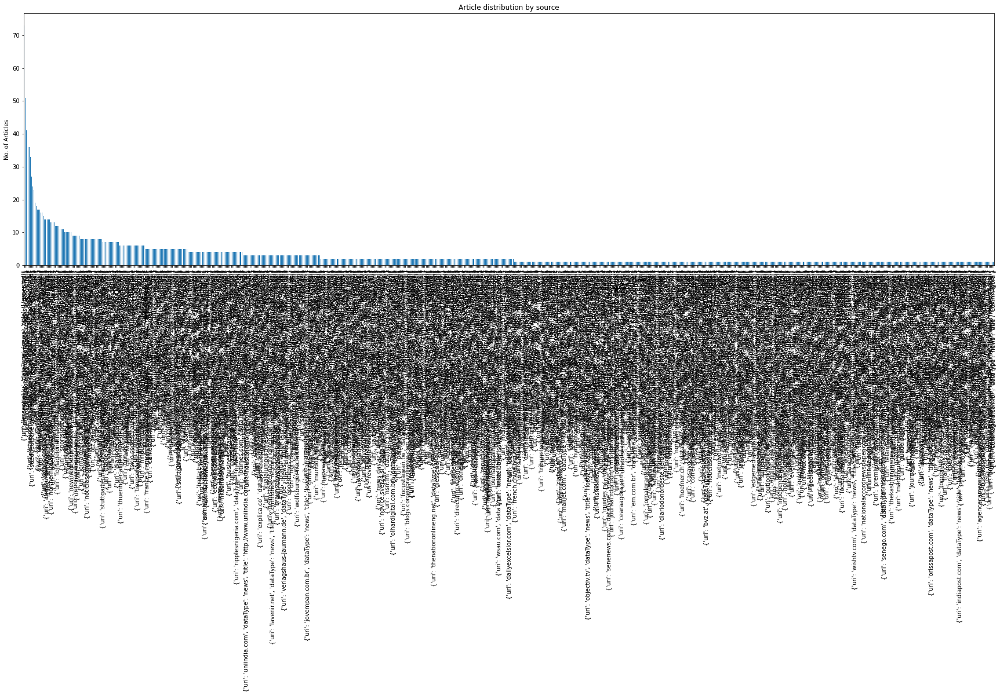

In [ ]:
df_concepts['olympic_games;japan;table_tennis'].source.value_counts().plot(kind='bar', title='Article distribution by source', ylabel='No. of Articles', figsize=(30, 8) )

In [ ]:
df_concepts['olympic_games;japan;table_tennis']['isDuplicate'].value_counts()

False    1781
True      696
Name: isDuplicate, dtype: int64

In [ ]:
df_concepts['paralympic_games;japan;table_tennis']

,concepts,source,eventUri,lang,dateTime,isDuplicate
11680,paralympic_games;japan;table_tennis,"{'uri': 'srf.ch', 'dataType': 'news', 'title':...",6.697806e+09,deu,2021-08-22 09:53:00,False
11681,paralympic_games;japan;table_tennis,"{'uri': 'dw.com', 'dataType': 'news', 'title':...",6.698245e+09,deu,2021-08-22 19:10:00,False
11682,paralympic_games;japan;table_tennis,"{'uri': 'nachrichten.at', 'dataType': 'news', ...",6.698367e+09,deu,2021-08-22 22:28:00,False
11683,paralympic_games;japan;table_tennis,"{'uri': 'tageblatt.lu', 'dataType': 'news', 't...",6.698711e+09,deu,2021-08-23 07:05:00,False
11684,paralympic_games;japan;table_tennis,"{'uri': 'derstandard.at', 'dataType': 'news', ...",6.698744e+09,deu,2021-08-23 07:37:00,False
...,...,...,...,...,...,...
2465319,paralympic_games;japan;table_tennis,"{'uri': 'dw.com', 'dataType': 'news', 'title':...",6.716495e+09,por,2021-09-05 16:07:00,False
2465320,paralympic_games;japan;table_tennis,"{'uri': 'rfi.fr', 'dataType': 'news', 'title':...",6.716524e+09,por,2021-09-05 16:42:00,False
2465321,paralympic_games;japan;table_tennis,"{'uri': 'noticias.uol.com.br', 'dataType': 'ne...",6.716527e+09,por,2021-09-05 16:47:00,False
2465322,paralympic_games;japan;table_tennis,"{'uri': 'ofuxico.com.br', 'dataType': 'news', ...",6.716551e+09,por,2021-09-05 17:17:00,False


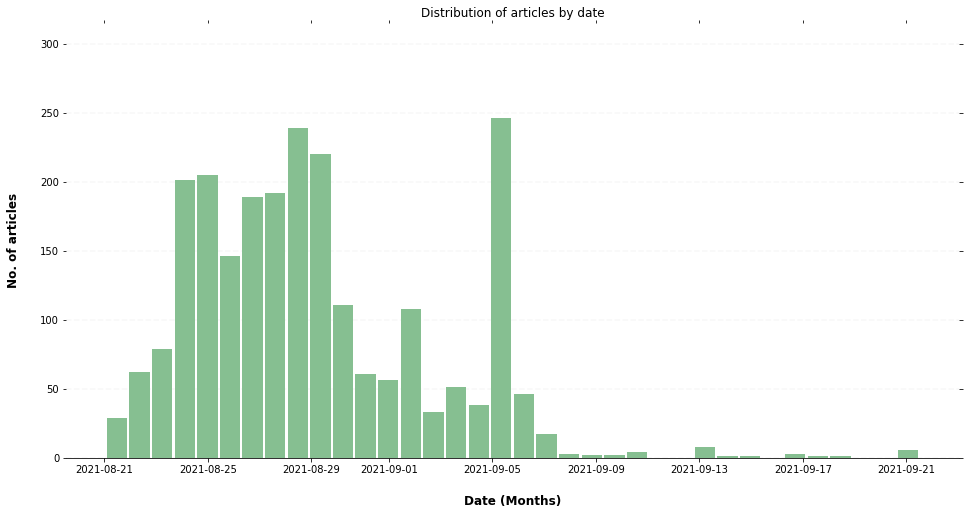

In [ ]:
ax = df_concepts['paralympic_games;japan;table_tennis'].hist(column='dateTime', bins=36, grid=False, figsize=(16,8), color='#86bf91', zorder=2, rwidth=0.9)

ax = ax[0]
for x in ax:

    # Despine
    x.spines['right'].set_visible(False)
    x.spines['top'].set_visible(False)
    x.spines['left'].set_visible(False)

    # Switch off ticks
    x.tick_params(axis="both", which="both", bottom="off", top="off", labelbottom="on", left="off", right="off", labelleft="on")

    # Draw horizontal axis lines
    vals = x.get_yticks()
    for tick in vals:
        x.axhline(y=tick, linestyle='dashed', alpha=0.4, color='#eeeeee', zorder=1)

    # Remove title
    x.set_title("Distribution of articles by date")

    # Set x-axis label
    x.set_xlabel("Date (Months)", labelpad=20, weight='bold', size=12)

    # Set y-axis label
    x.set_ylabel("No. of articles", labelpad=20, weight='bold', size=12)

  

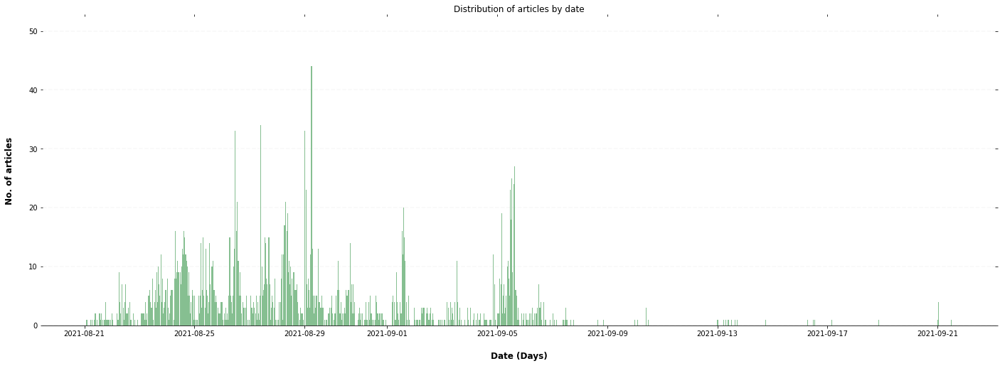

In [ ]:
ax = df_concepts['paralympic_games;japan;table_tennis'].hist(column='dateTime', bins=1080, grid=False, figsize=(24,8), color='#86bf91', zorder=2, rwidth=0.9)

ax = ax[0]
for x in ax:

    # Despine
    x.spines['right'].set_visible(False)
    x.spines['top'].set_visible(False)
    x.spines['left'].set_visible(False)

    # Switch off ticks
    x.tick_params(axis="both", which="both", bottom="off", top="off", labelbottom="on", left="off", right="off", labelleft="on")

    # Draw horizontal axis lines
    vals = x.get_yticks()
    for tick in vals:
        x.axhline(y=tick, linestyle='dashed', alpha=0.4, color='#eeeeee', zorder=1)

    # Remove title
    x.set_title("Distribution of articles by date")

    # Set x-axis label
    x.set_xlabel("Date (Days)", labelpad=20, weight='bold', size=12)

    # Set y-axis label
    x.set_ylabel("No. of articles", labelpad=20, weight='bold', size=12)

  

<AxesSubplot:title={'center':'Article distribution by language'}, ylabel='No. of Articles'>

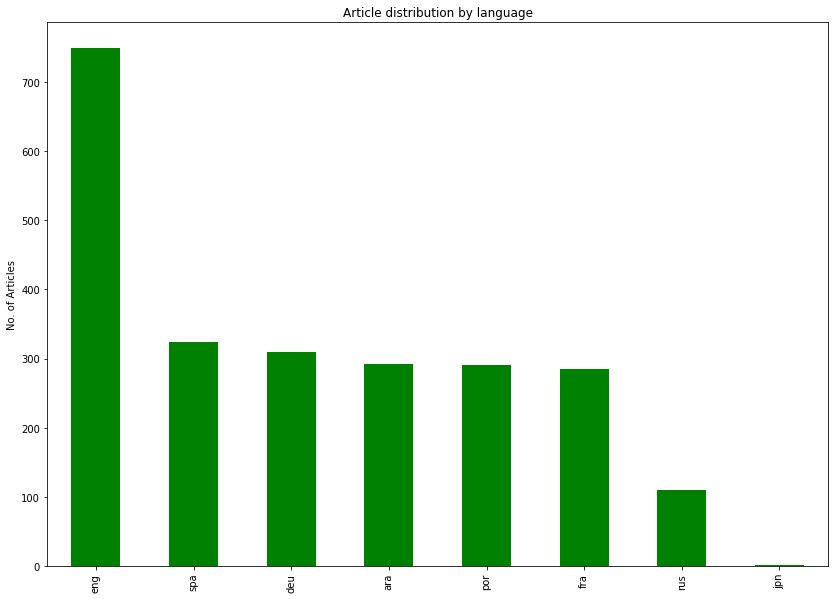

In [ ]:
df_concepts['paralympic_games;japan;table_tennis']['lang'].value_counts().plot(kind='bar', title='Article distribution by language', ylabel='No. of Articles', figsize=(14,10), color='green')

<AxesSubplot:title={'center':'Article distribution by source'}, ylabel='No. of Articles'>

/home/matevzm/.local/lib/python3.8/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 27598 (\N{CJK UNIFIED IDEOGRAPH-6BCE}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/matevzm/.local/lib/python3.8/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 26085 (\N{CJK UNIFIED IDEOGRAPH-65E5}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/matevzm/.local/lib/python3.8/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 26032 (\N{CJK UNIFIED IDEOGRAPH-65B0}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/matevzm/.local/lib/python3.8/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 32862 (\N{CJK UNIFIED IDEOGRAPH-805E}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/matevzm/.local/lib/python3.8/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 51473 (\N{HANGUL SYLLABLE JUNG}) missing from current font.
  fig.ca

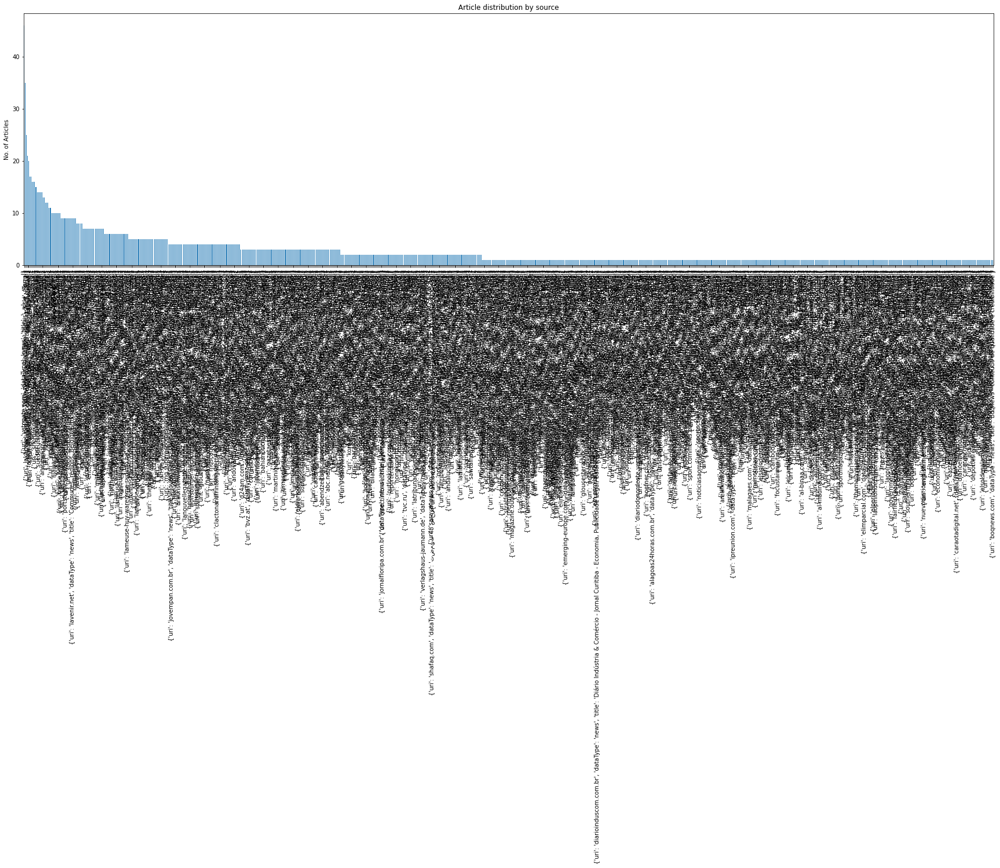

In [ ]:
df_concepts['paralympic_games;japan;table_tennis'].source.value_counts().plot(kind='bar', title='Article distribution by source', ylabel='No. of Articles', figsize=(30, 8) )

In [ ]:
df_concepts['paralympic_games;japan;table_tennis']['isDuplicate'].value_counts()

False    1482
True      879
Name: isDuplicate, dtype: int64

In [ ]:
df_concepts['olympic_games;japan;sport_climbing']

,concepts,source,eventUri,lang,dateTime,isDuplicate
60178,olympic_games;japan;sport_climbing,"{'uri': 't-online.de', 'dataType': 'news', 'ti...",6.666665e+09,deu,2021-07-29 03:45:00,False
60179,olympic_games;japan;sport_climbing,"{'uri': 'augsburger-allgemeine.de', 'dataType'...",6.667623e+09,deu,2021-07-29 17:04:00,False
60180,olympic_games;japan;sport_climbing,"{'uri': 'welt.de', 'dataType': 'news', 'title'...",6.667944e+09,deu,2021-07-29 22:47:00,False
60181,olympic_games;japan;sport_climbing,"{'uri': 'kicker.de', 'dataType': 'news', 'titl...",6.667946e+09,deu,2021-07-29 22:49:00,False
60182,olympic_games;japan;sport_climbing,"{'uri': 'rnd.de', 'dataType': 'news', 'title':...",6.668485e+09,deu,2021-07-30 09:11:00,False
...,...,...,...,...,...,...
2387576,olympic_games;japan;sport_climbing,"{'uri': 'slovenskenovice.si', 'dataType': 'new...",6.660131e+09,slv,2021-07-24 05:37:00,True
2387577,olympic_games;japan;sport_climbing,"{'uri': 'necenzurirano.si', 'dataType': 'news'...",6.660775e+09,slv,2021-07-24 17:50:00,False
2387578,olympic_games;japan;sport_climbing,"{'uri': 'novice.svet24.si', 'dataType': 'news'...",6.660777e+09,slv,2021-07-24 17:53:00,False
2387579,olympic_games;japan;sport_climbing,"{'uri': 'vestnik.si', 'dataType': 'news', 'tit...",6.660806e+09,slv,2021-07-24 18:33:00,False


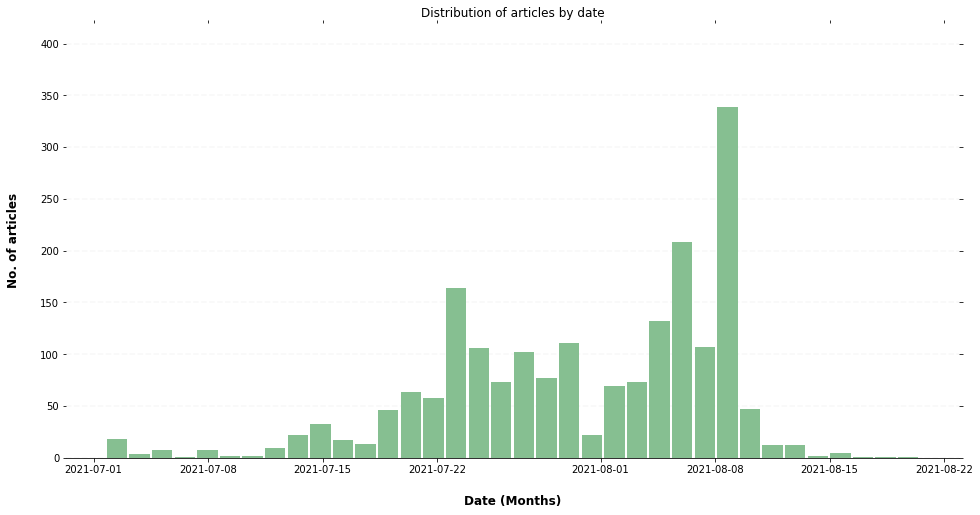

In [ ]:
ax = df_concepts['olympic_games;japan;sport_climbing'].hist(column='dateTime', bins=36, grid=False, figsize=(16,8), color='#86bf91', zorder=2, rwidth=0.9)

ax = ax[0]
for x in ax:

    # Despine
    x.spines['right'].set_visible(False)
    x.spines['top'].set_visible(False)
    x.spines['left'].set_visible(False)

    # Switch off ticks
    x.tick_params(axis="both", which="both", bottom="off", top="off", labelbottom="on", left="off", right="off", labelleft="on")

    # Draw horizontal axis lines
    vals = x.get_yticks()
    for tick in vals:
        x.axhline(y=tick, linestyle='dashed', alpha=0.4, color='#eeeeee', zorder=1)

    # Remove title
    x.set_title("Distribution of articles by date")

    # Set x-axis label
    x.set_xlabel("Date (Months)", labelpad=20, weight='bold', size=12)

    # Set y-axis label
    x.set_ylabel("No. of articles", labelpad=20, weight='bold', size=12)


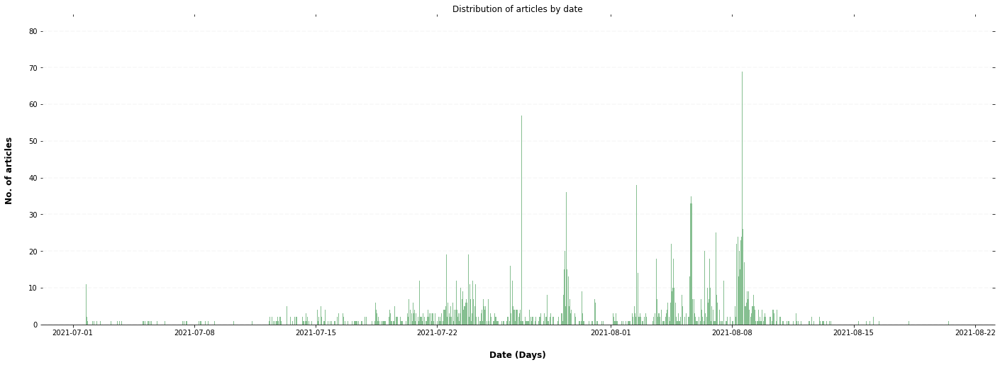

In [ ]:
ax = df_concepts['olympic_games;japan;sport_climbing'].hist(column='dateTime', bins=1080, grid=False, figsize=(24,8), color='#86bf91', zorder=2, rwidth=0.9)

ax = ax[0]
for x in ax:

    # Despine
    x.spines['right'].set_visible(False)
    x.spines['top'].set_visible(False)
    x.spines['left'].set_visible(False)

    # Switch off ticks
    x.tick_params(axis="both", which="both", bottom="off", top="off", labelbottom="on", left="off", right="off", labelleft="on")

    # Draw horizontal axis lines
    vals = x.get_yticks()
    for tick in vals:
        x.axhline(y=tick, linestyle='dashed', alpha=0.4, color='#eeeeee', zorder=1)

    # Remove title
    x.set_title("Distribution of articles by date")

    # Set x-axis label
    x.set_xlabel("Date (Days)", labelpad=20, weight='bold', size=12)

    # Set y-axis label
    x.set_ylabel("No. of articles", labelpad=20, weight='bold', size=12)

   

<AxesSubplot:title={'center':'Article distribution by language'}, ylabel='No. of Articles'>

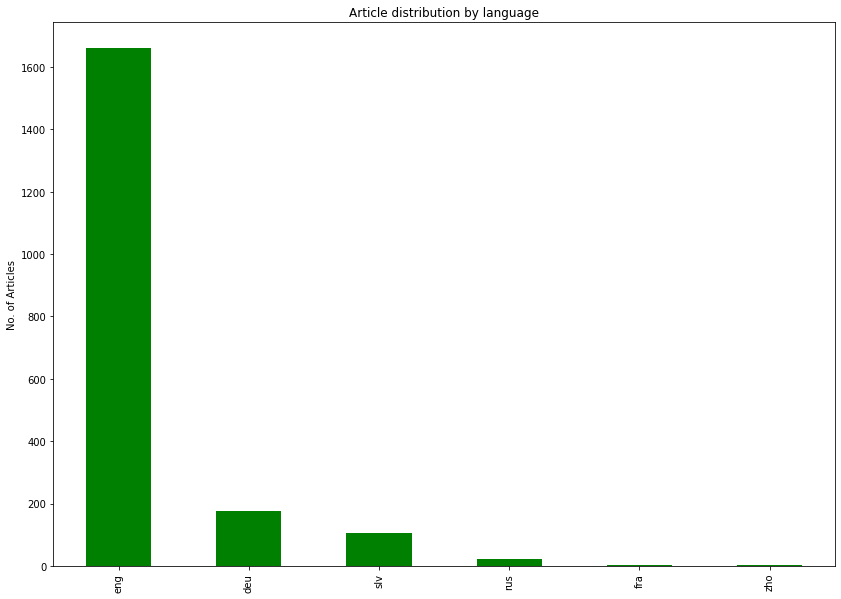

In [ ]:
df_concepts['olympic_games;japan;sport_climbing']['lang'].value_counts().plot(kind='bar', title='Article distribution by language', ylabel='No. of Articles', figsize=(14,10), color='green')

<AxesSubplot:title={'center':'Article distribution by source'}, ylabel='No. of Articles'>

/home/matevzm/.local/lib/python3.8/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 27598 (\N{CJK UNIFIED IDEOGRAPH-6BCE}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/matevzm/.local/lib/python3.8/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 26085 (\N{CJK UNIFIED IDEOGRAPH-65E5}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/matevzm/.local/lib/python3.8/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 26032 (\N{CJK UNIFIED IDEOGRAPH-65B0}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/matevzm/.local/lib/python3.8/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 32862 (\N{CJK UNIFIED IDEOGRAPH-805E}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/matevzm/.local/lib/python3.8/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 21326 (\N{CJK UNIFIED IDEOGRAPH-534E}) missing from current font.
  

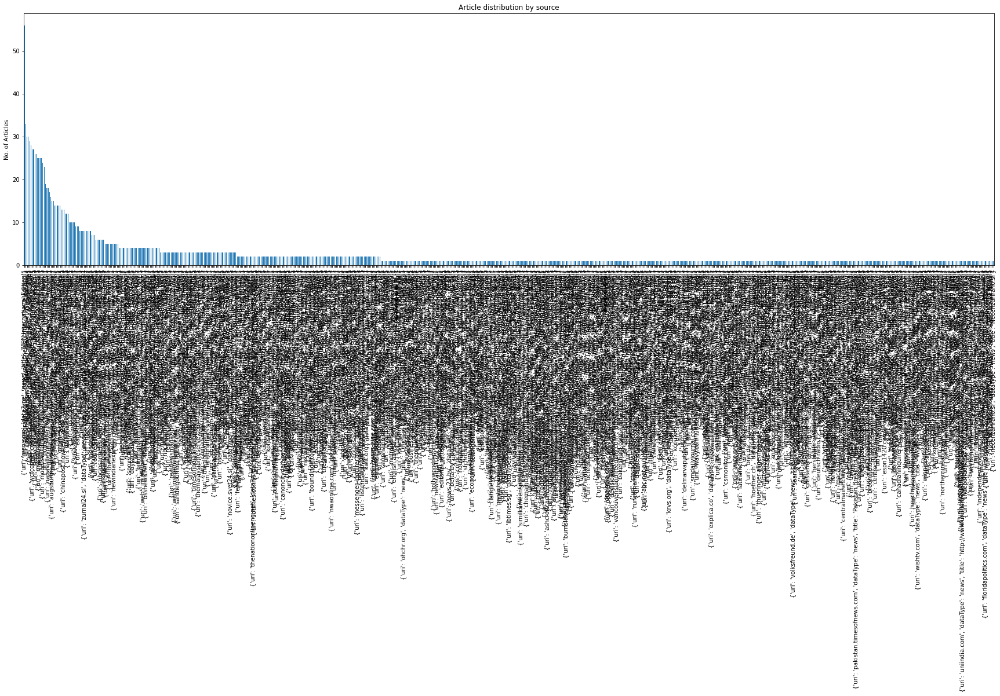

In [ ]:
df_concepts['olympic_games;japan;sport_climbing'].source.value_counts().plot(kind='bar', title='Article distribution by source', ylabel='No. of Articles', figsize=(30, 8) )

In [ ]:
df_concepts['olympic_games;japan;sport_climbing']['isDuplicate'].value_counts()

False    1121
True      848
Name: isDuplicate, dtype: int64

In [ ]:
df_concepts['olympic_games;japan;swimming']

,concepts,source,eventUri,lang,dateTime,isDuplicate
51766,olympic_games;japan;swimming,"{'uri': 'wn.de', 'dataType': 'news', 'title': ...",6.675964e+09,deu,2021-08-05 04:08:00,False
51767,olympic_games;japan;swimming,"{'uri': 'saechsische.de', 'dataType': 'news', ...",6.675967e+09,deu,2021-08-05 04:11:00,False
51768,olympic_games;japan;swimming,"{'uri': 'nwzonline.de', 'dataType': 'news', 't...",6.675974e+09,deu,2021-08-05 04:19:00,False
51769,olympic_games;japan;swimming,"{'uri': 'stuttgarter-nachrichten.de', 'dataTyp...",6.675980e+09,deu,2021-08-05 04:25:00,False
51770,olympic_games;japan;swimming,"{'uri': 'bnn.de', 'dataType': 'news', 'title':...",6.675986e+09,deu,2021-08-05 04:32:00,True
...,...,...,...,...,...,...
2503988,olympic_games;japan;swimming,"{'uri': 'folhadelondrina.com.br', 'dataType': ...",6.675025e+09,por,2021-08-04 11:50:00,False
2503989,olympic_games;japan;swimming,"{'uri': 'cidadeverde.com', 'dataType': 'news',...",6.675243e+09,por,2021-08-04 14:33:00,True
2503990,olympic_games;japan;swimming,"{'uri': 'portaldamineracao.com.br', 'dataType'...",6.675282e+09,por,2021-08-04 15:04:00,False
2503991,olympic_games;japan;swimming,"{'uri': 'sportbuzz.uol.com.br', 'dataType': 'n...",6.675435e+09,por,2021-08-04 17:11:00,False


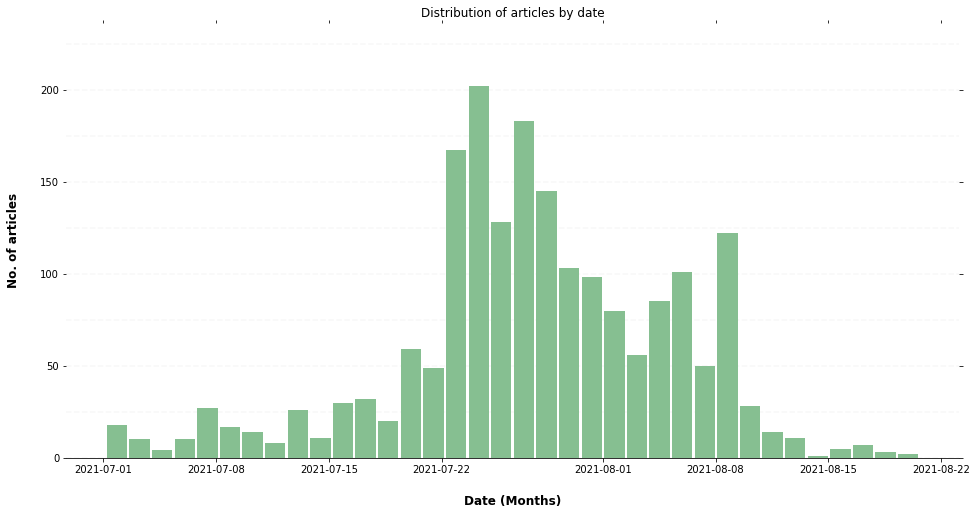

In [ ]:
ax = df_concepts['olympic_games;japan;swimming'].hist(column='dateTime', bins=36, grid=False, figsize=(16,8), color='#86bf91', zorder=2, rwidth=0.9)

ax = ax[0]
for x in ax:

    # Despine
    x.spines['right'].set_visible(False)
    x.spines['top'].set_visible(False)
    x.spines['left'].set_visible(False)

    # Switch off ticks
    x.tick_params(axis="both", which="both", bottom="off", top="off", labelbottom="on", left="off", right="off", labelleft="on")

    # Draw horizontal axis lines
    vals = x.get_yticks()
    for tick in vals:
        x.axhline(y=tick, linestyle='dashed', alpha=0.4, color='#eeeeee', zorder=1)

    # Remove title
    x.set_title("Distribution of articles by date")

    # Set x-axis label
    x.set_xlabel("Date (Months)", labelpad=20, weight='bold', size=12)

    # Set y-axis label
    x.set_ylabel("No. of articles", labelpad=20, weight='bold', size=12)


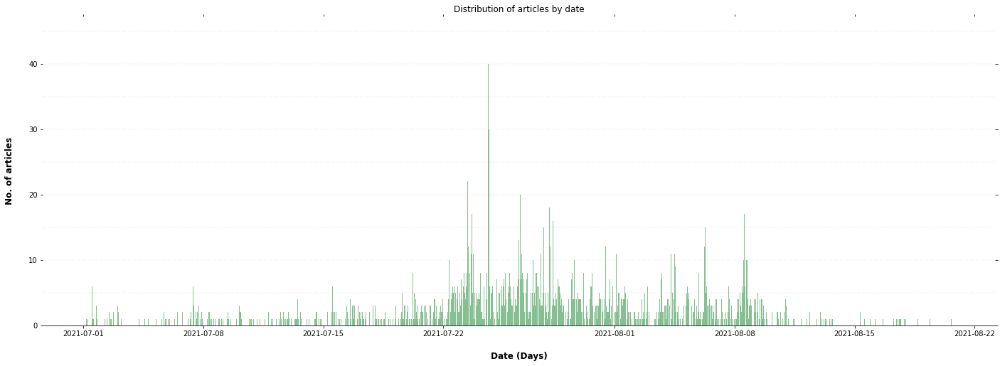

In [ ]:
ax = df_concepts['olympic_games;japan;swimming'].hist(column='dateTime', bins=1080, grid=False, figsize=(24,8), color='#86bf91', zorder=2, rwidth=0.9)

ax = ax[0]
for x in ax:

    # Despine
    x.spines['right'].set_visible(False)
    x.spines['top'].set_visible(False)
    x.spines['left'].set_visible(False)

    # Switch off ticks
    x.tick_params(axis="both", which="both", bottom="off", top="off", labelbottom="on", left="off", right="off", labelleft="on")

    # Draw horizontal axis lines
    vals = x.get_yticks()
    for tick in vals:
        x.axhline(y=tick, linestyle='dashed', alpha=0.4, color='#eeeeee', zorder=1)

    # Remove title
    x.set_title("Distribution of articles by date")

    # Set x-axis label
    x.set_xlabel("Date (Days)", labelpad=20, weight='bold', size=12)

    # Set y-axis label
    x.set_ylabel("No. of articles", labelpad=20, weight='bold', size=12)



<AxesSubplot:title={'center':'Article distribution by language'}, ylabel='No. of Articles'>

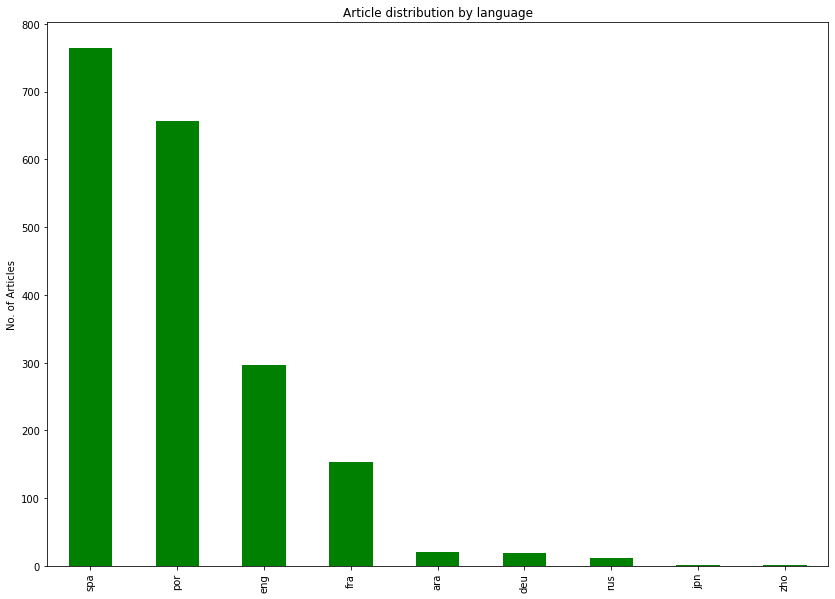

In [ ]:
df_concepts['olympic_games;japan;swimming']['lang'].value_counts().plot(kind='bar', title='Article distribution by language', ylabel='No. of Articles', figsize=(14,10), color='green')

<AxesSubplot:title={'center':'Article distribution by source'}, ylabel='No. of Articles'>

/home/matevzm/.local/lib/python3.8/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 26032 (\N{CJK UNIFIED IDEOGRAPH-65B0}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/matevzm/.local/lib/python3.8/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 21326 (\N{CJK UNIFIED IDEOGRAPH-534E}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/matevzm/.local/lib/python3.8/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 32593 (\N{CJK UNIFIED IDEOGRAPH-7F51}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)


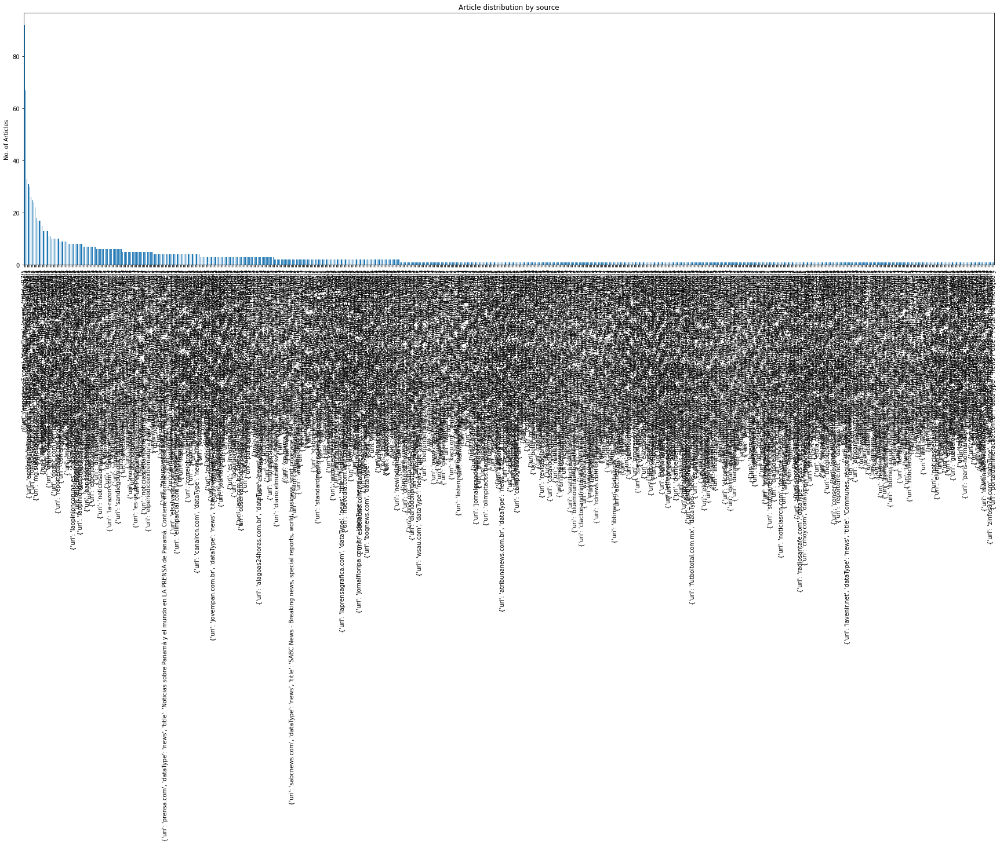

In [ ]:
df_concepts['olympic_games;japan;swimming'].source.value_counts().plot(kind='bar', title='Article distribution by source', ylabel='No. of Articles', figsize=(30, 8) )

In [ ]:
df_concepts['olympic_games;japan;swimming']['isDuplicate'].value_counts()

False    1417
True      509
Name: isDuplicate, dtype: int64

In [ ]:
df_concepts['olympic_games;japan;judo']

,concepts,source,eventUri,lang,dateTime,isDuplicate
85613,olympic_games;japan;judo,"{'uri': 'mopo.de', 'dataType': 'news', 'title'...",6.694229e+09,deu,2021-08-19 10:09:00,False
100060,olympic_games;japan;judo,"{'uri': 'hz.de', 'dataType': 'news', 'title': ...",6.684814e+09,deu,2021-08-12 01:05:00,False
100061,olympic_games;japan;judo,"{'uri': 'nd-aktuell.de', 'dataType': 'news', '...",6.687138e+09,deu,2021-08-13 15:27:00,False
100062,olympic_games;japan;judo,"{'uri': 'lvz.de', 'dataType': 'news', 'title':...",6.687385e+09,deu,2021-08-13 19:33:00,False
100063,olympic_games;japan;judo,"{'uri': 'bild.de', 'dataType': 'news', 'title'...",6.688480e+09,deu,2021-08-14 21:05:00,False
...,...,...,...,...,...,...
2505452,olympic_games;japan;judo,"{'uri': 'publico.pt', 'dataType': 'news', 'tit...",6.656958e+09,por,2021-07-21 22:46:00,False
2505453,olympic_games;japan;judo,"{'uri': 'uol.com.br', 'dataType': 'news', 'tit...",6.656959e+09,por,2021-07-21 22:47:00,False
2505454,olympic_games;japan;judo,"{'uri': 'diariodonordeste.verdesmares.com.br',...",6.656966e+09,por,2021-07-21 22:58:00,False
2505455,olympic_games;japan;judo,"{'uri': 'atribunanews.com.br', 'dataType': 'ne...",6.656975e+09,por,2021-07-21 23:10:00,False


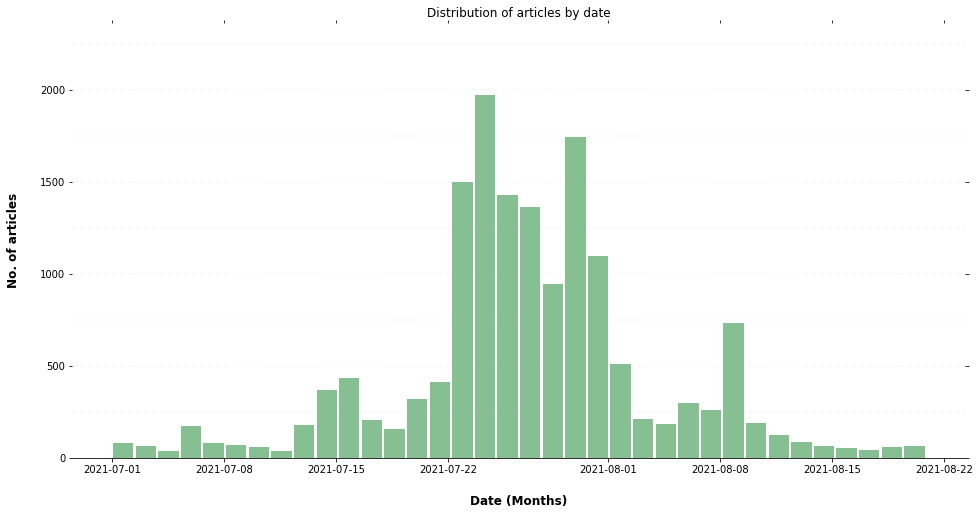

In [ ]:
ax = df_concepts['olympic_games;japan;judo'].hist(column='dateTime', bins=36, grid=False, figsize=(16,8), color='#86bf91', zorder=2, rwidth=0.9)

ax = ax[0]
for x in ax:

    # Despine
    x.spines['right'].set_visible(False)
    x.spines['top'].set_visible(False)
    x.spines['left'].set_visible(False)

    # Switch off ticks
    x.tick_params(axis="both", which="both", bottom="off", top="off", labelbottom="on", left="off", right="off", labelleft="on")

    # Draw horizontal axis lines
    vals = x.get_yticks()
    for tick in vals:
        x.axhline(y=tick, linestyle='dashed', alpha=0.4, color='#eeeeee', zorder=1)

    # Remove title
    x.set_title("Distribution of articles by date")

    # Set x-axis label
    x.set_xlabel("Date (Months)", labelpad=20, weight='bold', size=12)

    # Set y-axis label
    x.set_ylabel("No. of articles", labelpad=20, weight='bold', size=12)

 

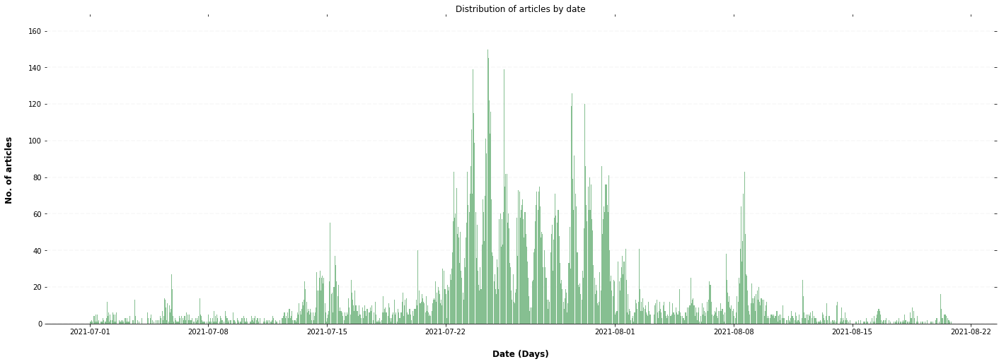

In [ ]:
ax = df_concepts['olympic_games;japan;judo'].hist(column='dateTime', bins=1080, grid=False, figsize=(24,8), color='#86bf91', zorder=2, rwidth=0.9)

ax = ax[0]
for x in ax:

    # Despine
    x.spines['right'].set_visible(False)
    x.spines['top'].set_visible(False)
    x.spines['left'].set_visible(False)

    # Switch off ticks
    x.tick_params(axis="both", which="both", bottom="off", top="off", labelbottom="on", left="off", right="off", labelleft="on")

    # Draw horizontal axis lines
    vals = x.get_yticks()
    for tick in vals:
        x.axhline(y=tick, linestyle='dashed', alpha=0.4, color='#eeeeee', zorder=1)

    # Remove title
    x.set_title("Distribution of articles by date")

    # Set x-axis label
    x.set_xlabel("Date (Days)", labelpad=20, weight='bold', size=12)

    # Set y-axis label
    x.set_ylabel("No. of articles", labelpad=20, weight='bold', size=12)

 

<AxesSubplot:title={'center':'Article distribution by language'}, ylabel='No. of Articles'>

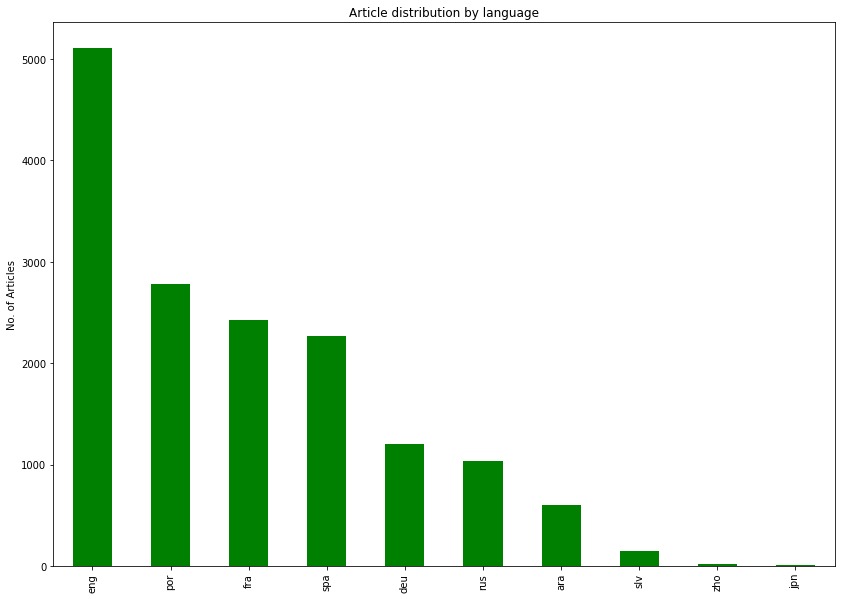

In [ ]:
df_concepts['olympic_games;japan;judo']['lang'].value_counts().plot(kind='bar', title='Article distribution by language', ylabel='No. of Articles', figsize=(14,10), color='green')

<AxesSubplot:title={'center':'Article distribution by source'}, ylabel='No. of Articles'>

/home/matevzm/.local/lib/python3.8/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 27598 (\N{CJK UNIFIED IDEOGRAPH-6BCE}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/matevzm/.local/lib/python3.8/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 26085 (\N{CJK UNIFIED IDEOGRAPH-65E5}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/matevzm/.local/lib/python3.8/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 26032 (\N{CJK UNIFIED IDEOGRAPH-65B0}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/matevzm/.local/lib/python3.8/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 32862 (\N{CJK UNIFIED IDEOGRAPH-805E}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/matevzm/.local/lib/python3.8/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 26397 (\N{CJK UNIFIED IDEOGRAPH-671D}) missing from current font.
  

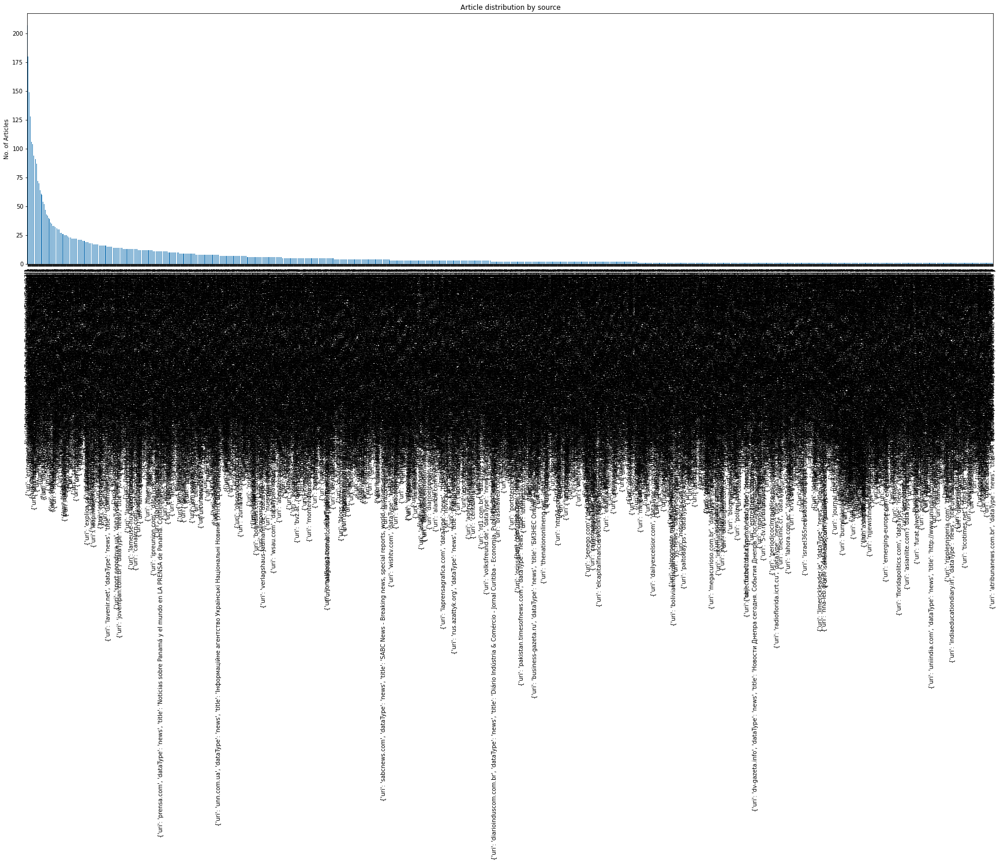

In [ ]:
df_concepts['olympic_games;japan;judo'].source.value_counts().plot(kind='bar', title='Article distribution by source', ylabel='No. of Articles', figsize=(30, 8) )

In [ ]:
df_concepts['olympic_games;japan;judo']['isDuplicate'].value_counts()

False    10190
True      5389
Name: isDuplicate, dtype: int64

In [ ]:
df_concepts['pandora_papers']

,concepts,source,eventUri,lang,dateTime,isDuplicate
1568519,pandora_papers,"{'uri': 'intellasia.net', 'dataType': 'news', ...",6.796698e+09,eng,2021-11-05 00:39:00,True
1568520,pandora_papers,"{'uri': 'cryptonews.com', 'dataType': 'news', ...",6.796724e+09,eng,2021-11-05 01:19:00,False
1568521,pandora_papers,"{'uri': 'onlanka.com', 'dataType': 'news', 'ti...",6.796759e+09,eng,2021-11-05 02:13:00,False
1568522,pandora_papers,"{'uri': 'naijanews.com', 'dataType': 'news', '...",6.796792e+09,eng,2021-11-05 03:07:00,False
1568523,pandora_papers,"{'uri': 'ceylontoday.lk', 'dataType': 'news', ...",6.796803e+09,eng,2021-11-05 03:25:00,False
...,...,...,...,...,...,...
2054935,pandora_papers,"{'uri': 'emerging-europe.com', 'dataType': 'ne...",6.815192e+09,eng,2021-11-18 14:04:00,False
2054936,pandora_papers,"{'uri': 'guardian.ng', 'dataType': 'news', 'ti...",6.815230e+09,eng,2021-11-18 14:33:00,True
2054937,pandora_papers,"{'uri': 'news.kuwaittimes.net', 'dataType': 'n...",6.815369e+09,eng,2021-11-18 16:20:00,True
2054938,pandora_papers,"{'uri': 'dailymaverick.co.za', 'dataType': 'ne...",6.815547e+09,eng,2021-11-18 18:51:00,False


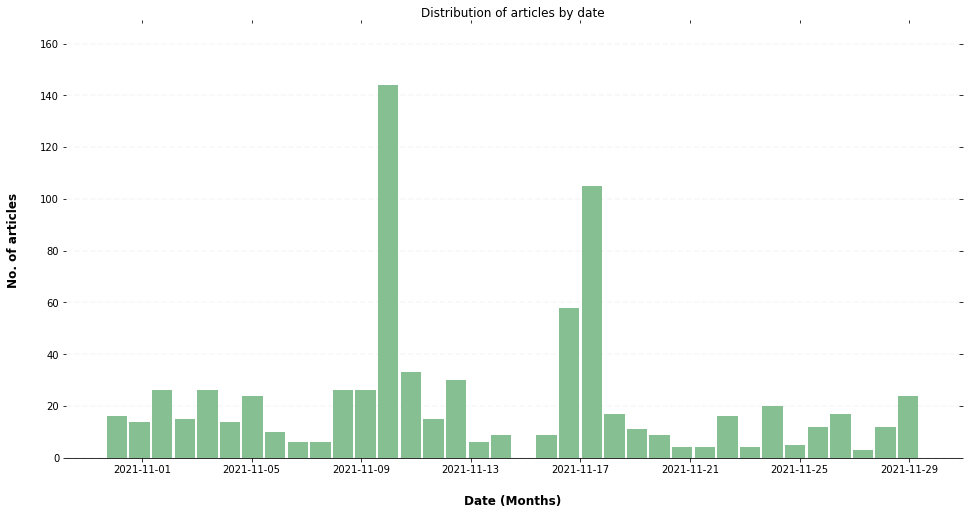

In [ ]:
ax = df_concepts['pandora_papers'].hist(column='dateTime', bins=36, grid=False, figsize=(16,8), color='#86bf91', zorder=2, rwidth=0.9)

ax = ax[0]
for x in ax:

    # Despine
    x.spines['right'].set_visible(False)
    x.spines['top'].set_visible(False)
    x.spines['left'].set_visible(False)

    # Switch off ticks
    x.tick_params(axis="both", which="both", bottom="off", top="off", labelbottom="on", left="off", right="off", labelleft="on")

    # Draw horizontal axis lines
    vals = x.get_yticks()
    for tick in vals:
        x.axhline(y=tick, linestyle='dashed', alpha=0.4, color='#eeeeee', zorder=1)

    # Remove title
    x.set_title("Distribution of articles by date")

    # Set x-axis label
    x.set_xlabel("Date (Months)", labelpad=20, weight='bold', size=12)

    # Set y-axis label
    x.set_ylabel("No. of articles", labelpad=20, weight='bold', size=12)

  

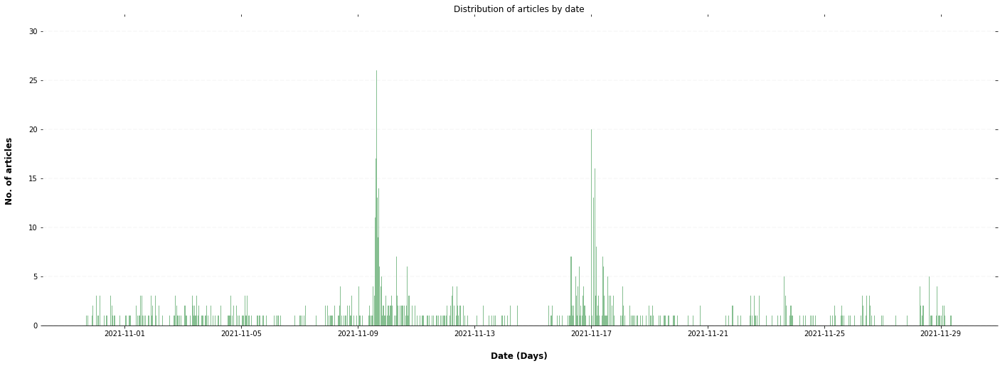

In [ ]:
ax = df_concepts['pandora_papers'].hist(column='dateTime', bins=1080, grid=False, figsize=(24,8), color='#86bf91', zorder=2, rwidth=0.9)

ax = ax[0]
for x in ax:

    # Despine
    x.spines['right'].set_visible(False)
    x.spines['top'].set_visible(False)
    x.spines['left'].set_visible(False)

    # Switch off ticks
    x.tick_params(axis="both", which="both", bottom="off", top="off", labelbottom="on", left="off", right="off", labelleft="on")

    # Draw horizontal axis lines
    vals = x.get_yticks()
    for tick in vals:
        x.axhline(y=tick, linestyle='dashed', alpha=0.4, color='#eeeeee', zorder=1)

    # Remove title
    x.set_title("Distribution of articles by date")

    # Set x-axis label
    x.set_xlabel("Date (Days)", labelpad=20, weight='bold', size=12)

    # Set y-axis label
    x.set_ylabel("No. of articles", labelpad=20, weight='bold', size=12)

  

<AxesSubplot:title={'center':'Article distribution by language'}, ylabel='No. of Articles'>

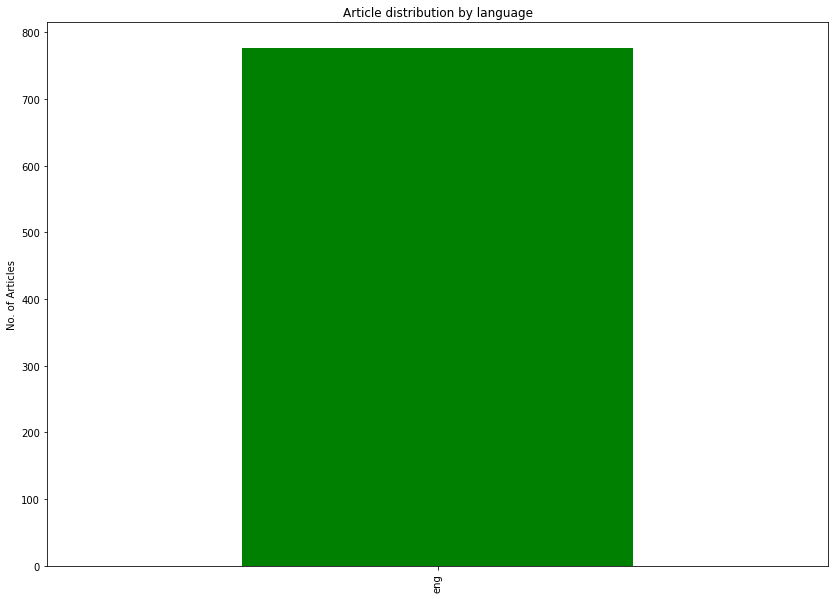

In [ ]:
df_concepts['pandora_papers']['lang'].value_counts().plot(kind='bar', title='Article distribution by language', ylabel='No. of Articles', figsize=(14,10), color='green')

<AxesSubplot:title={'center':'Article distribution by source'}, ylabel='No. of Articles'>

/home/matevzm/.local/lib/python3.8/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 26481 (\N{CJK UNIFIED IDEOGRAPH-6771}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/matevzm/.local/lib/python3.8/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 26041 (\N{CJK UNIFIED IDEOGRAPH-65B9}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/matevzm/.local/lib/python3.8/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 32178 (\N{CJK UNIFIED IDEOGRAPH-7DB2}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/matevzm/.local/lib/python3.8/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 39340 (\N{CJK UNIFIED IDEOGRAPH-99AC}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/matevzm/.local/lib/python3.8/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 20358 (\N{CJK UNIFIED IDEOGRAPH-4F86}) missing from current font.
  

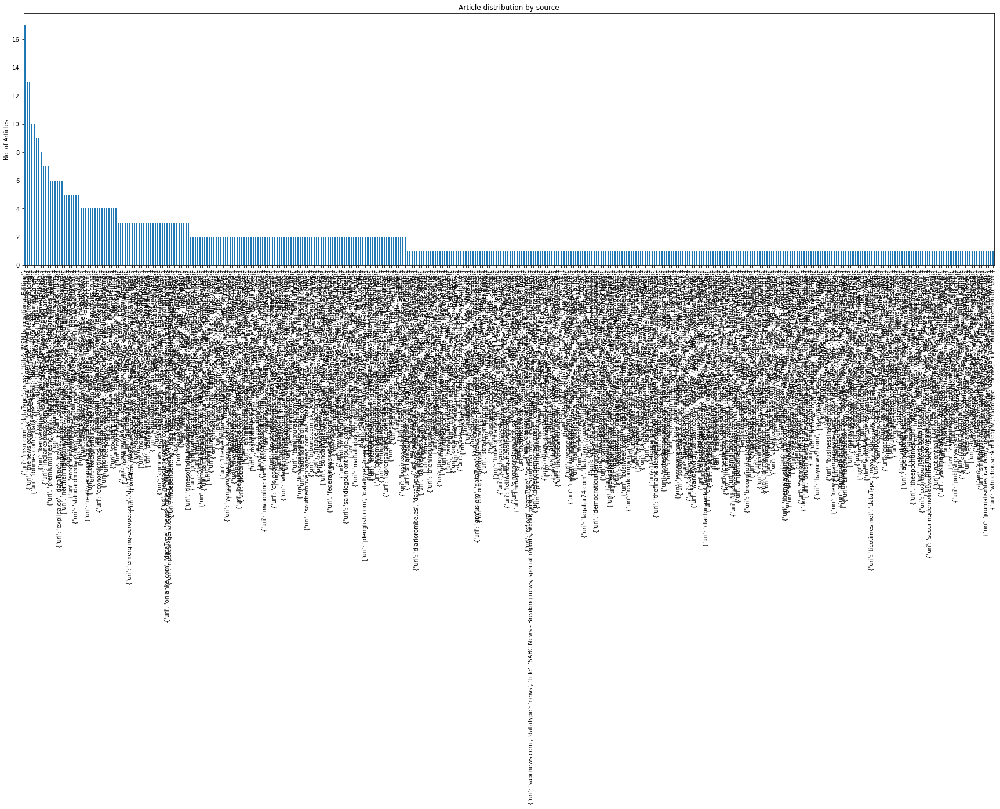

In [ ]:
df_concepts['pandora_papers'].source.value_counts().plot(kind='bar', title='Article distribution by source', ylabel='No. of Articles', figsize=(30, 8) )

In [ ]:
df_concepts['pandora_papers']['isDuplicate'].value_counts()

False    568
True     208
Name: isDuplicate, dtype: int64

In [ ]:
df_concepts['paralympic_games;japan;basketball']

,concepts,source,eventUri,lang,dateTime,isDuplicate
134139,paralympic_games;japan;basketball,"{'uri': 'tz.de', 'dataType': 'news', 'title': ...",6.696857e+09,deu,2021-08-21 10:03:00,False
134140,paralympic_games;japan;basketball,"{'uri': 'deutschlandfunk.de', 'dataType': 'new...",6.698059e+09,deu,2021-08-22 15:02:00,False
134141,paralympic_games;japan;basketball,"{'uri': 'tokio.sportschau.de', 'dataType': 'ne...",6.699026e+09,deu,2021-08-23 11:29:00,False
134142,paralympic_games;japan;basketball,"{'uri': 'kinder.wdr.de', 'dataType': 'news', '...",6.699238e+09,deu,2021-08-23 14:19:00,False
134143,paralympic_games;japan;basketball,"{'uri': 'n-tv.de', 'dataType': 'news', 'title'...",6.699279e+09,deu,2021-08-23 14:52:00,False
...,...,...,...,...,...,...
2518803,paralympic_games;japan;basketball,"{'uri': 'tvi24.iol.pt', 'dataType': 'news', 't...",6.716108e+09,por,2021-09-05 08:24:00,True
2518804,paralympic_games;japan;basketball,"{'uri': 'ge.globo.com', 'dataType': 'news', 't...",6.716360e+09,por,2021-09-05 13:23:00,False
2518805,paralympic_games;japan;basketball,"{'uri': 'horadopovo.com.br', 'dataType': 'news...",6.716716e+09,por,2021-09-05 21:13:00,False
2518806,paralympic_games;japan;basketball,"{'uri': 'agenciabrasil.ebc.com.br', 'dataType'...",6.717951e+09,por,2021-09-06 19:23:00,True


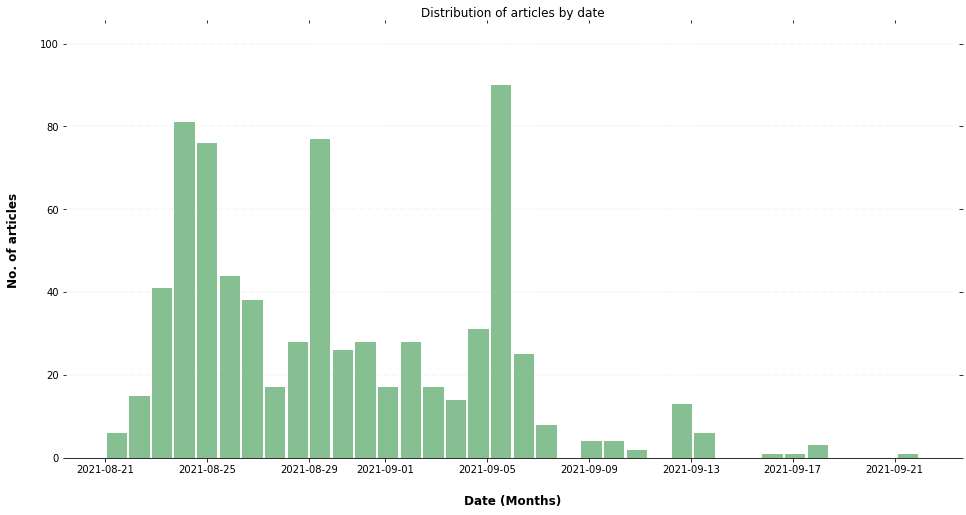

In [ ]:
ax = df_concepts['paralympic_games;japan;basketball'].hist(column='dateTime', bins=36, grid=False, figsize=(16,8), color='#86bf91', zorder=2, rwidth=0.9)

ax = ax[0]
for x in ax:

    # Despine
    x.spines['right'].set_visible(False)
    x.spines['top'].set_visible(False)
    x.spines['left'].set_visible(False)

    # Switch off ticks
    x.tick_params(axis="both", which="both", bottom="off", top="off", labelbottom="on", left="off", right="off", labelleft="on")

    # Draw horizontal axis lines
    vals = x.get_yticks()
    for tick in vals:
        x.axhline(y=tick, linestyle='dashed', alpha=0.4, color='#eeeeee', zorder=1)

    # Remove title
    x.set_title("Distribution of articles by date")

    # Set x-axis label
    x.set_xlabel("Date (Months)", labelpad=20, weight='bold', size=12)

    # Set y-axis label
    x.set_ylabel("No. of articles", labelpad=20, weight='bold', size=12)

   

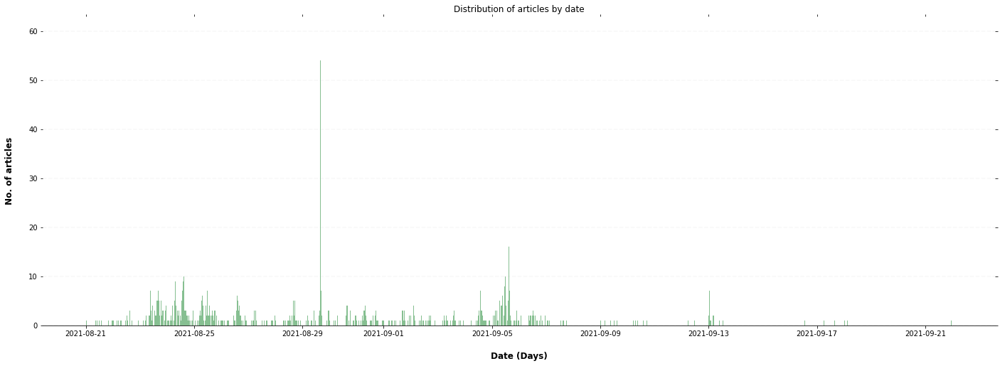

In [ ]:
ax = df_concepts['paralympic_games;japan;basketball'].hist(column='dateTime', bins=1080, grid=False, figsize=(24,8), color='#86bf91', zorder=2, rwidth=0.9)

ax = ax[0]
for x in ax:

    # Despine
    x.spines['right'].set_visible(False)
    x.spines['top'].set_visible(False)
    x.spines['left'].set_visible(False)

    # Switch off ticks
    x.tick_params(axis="both", which="both", bottom="off", top="off", labelbottom="on", left="off", right="off", labelleft="on")

    # Draw horizontal axis lines
    vals = x.get_yticks()
    for tick in vals:
        x.axhline(y=tick, linestyle='dashed', alpha=0.4, color='#eeeeee', zorder=1)

    # Remove title
    x.set_title("Distribution of articles by date")

    # Set x-axis label
    x.set_xlabel("Date (Days)", labelpad=20, weight='bold', size=12)

    # Set y-axis label
    x.set_ylabel("No. of articles", labelpad=20, weight='bold', size=12)

   

<AxesSubplot:title={'center':'Article distribution by language'}, ylabel='No. of Articles'>

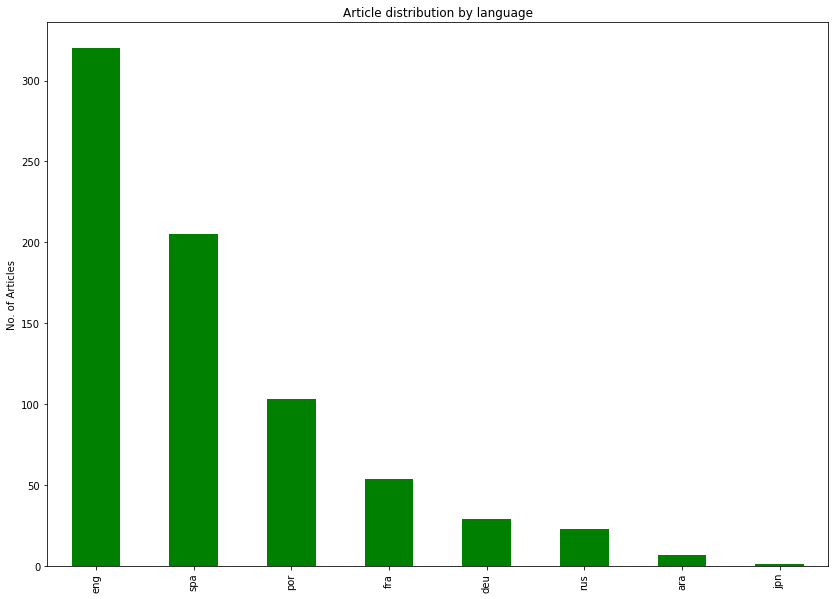

In [ ]:
df_concepts['paralympic_games;japan;basketball']['lang'].value_counts().plot(kind='bar', title='Article distribution by language', ylabel='No. of Articles', figsize=(14,10), color='green')

<AxesSubplot:title={'center':'Article distribution by source'}, ylabel='No. of Articles'>

/home/matevzm/.local/lib/python3.8/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 27598 (\N{CJK UNIFIED IDEOGRAPH-6BCE}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/matevzm/.local/lib/python3.8/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 26085 (\N{CJK UNIFIED IDEOGRAPH-65E5}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/matevzm/.local/lib/python3.8/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 26032 (\N{CJK UNIFIED IDEOGRAPH-65B0}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/matevzm/.local/lib/python3.8/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 32862 (\N{CJK UNIFIED IDEOGRAPH-805E}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/matevzm/.local/lib/python3.8/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 26397 (\N{CJK UNIFIED IDEOGRAPH-671D}) missing from current font.
  

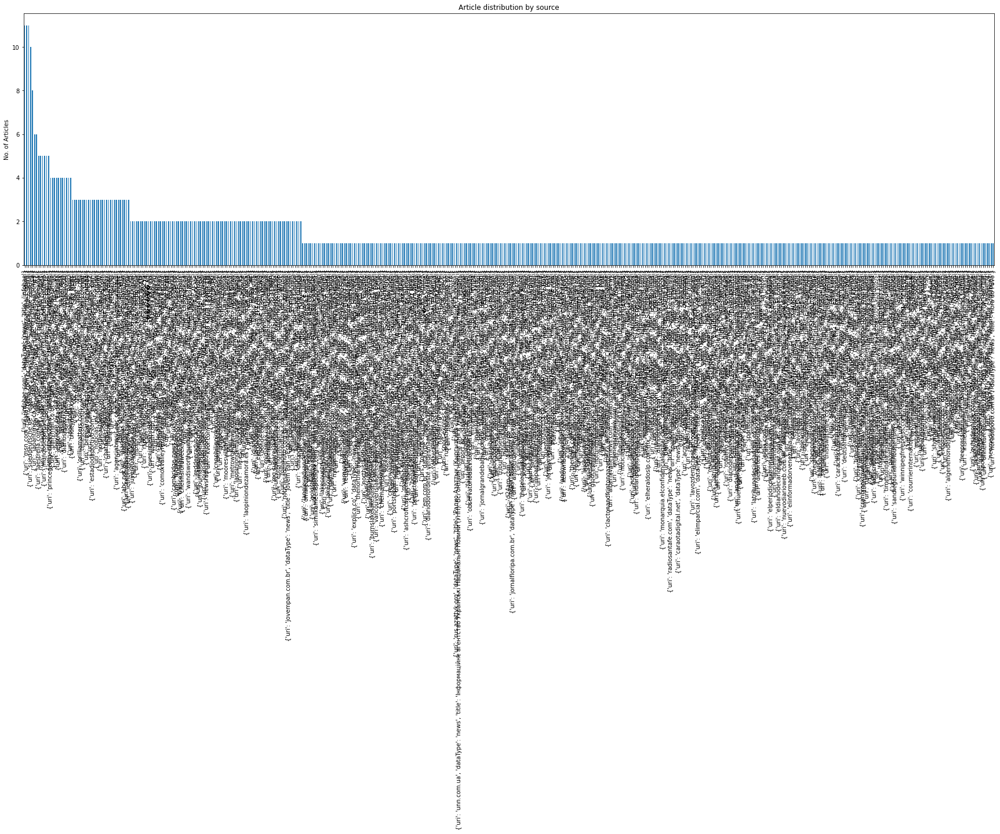

In [ ]:
df_concepts['paralympic_games;japan;basketball'].source.value_counts().plot(kind='bar', title='Article distribution by source', ylabel='No. of Articles', figsize=(30, 8) )

In [ ]:
df_concepts['paralympic_games;japan;basketball']['isDuplicate'].value_counts()

False    463
True     279
Name: isDuplicate, dtype: int64

In [ ]:
df_concepts['paralympic_games;japan;swimming']

,concepts,source,eventUri,lang,dateTime,isDuplicate
186733,paralympic_games;japan;swimming,"{'uri': 'verlagshaus-jaumann.de', 'dataType': ...",6.715906e+09,deu,2021-09-05 03:13:00,False
191545,paralympic_games;japan;swimming,"{'uri': 'tokio.sportschau.de', 'dataType': 'ne...",6.700204e+09,deu,2021-08-24 08:32:00,False
191546,paralympic_games;japan;swimming,"{'uri': 'taz.de', 'dataType': 'news', 'title':...",6.702078e+09,deu,2021-08-25 13:53:00,False
191547,paralympic_games;japan;swimming,"{'uri': 'bernerzeitung.ch', 'dataType': 'news'...",6.703202e+09,deu,2021-08-26 09:41:00,True
524716,paralympic_games;japan;swimming,"{'uri': 'canarias24horas.com', 'dataType': 'ne...",6.728099e+09,spa,2021-09-14 11:54:00,False
...,...,...,...,...,...,...
2485281,paralympic_games;japan;swimming,"{'uri': 'mundolusiada.com.br', 'dataType': 'ne...",6.705446e+09,por,2021-08-27 21:44:00,False
2485282,paralympic_games;japan;swimming,"{'uri': 'correiobraziliense.com.br', 'dataType...",6.705460e+09,por,2021-08-27 22:01:00,False
2515680,paralympic_games;japan;swimming,"{'uri': 'noticias.r7.com', 'dataType': 'news',...",6.737450e+09,por,2021-09-21 12:21:00,False
2515681,paralympic_games;japan;swimming,"{'uri': 'g1.globo.com', 'dataType': 'news', 't...",6.738066e+09,por,2021-09-21 21:07:00,False


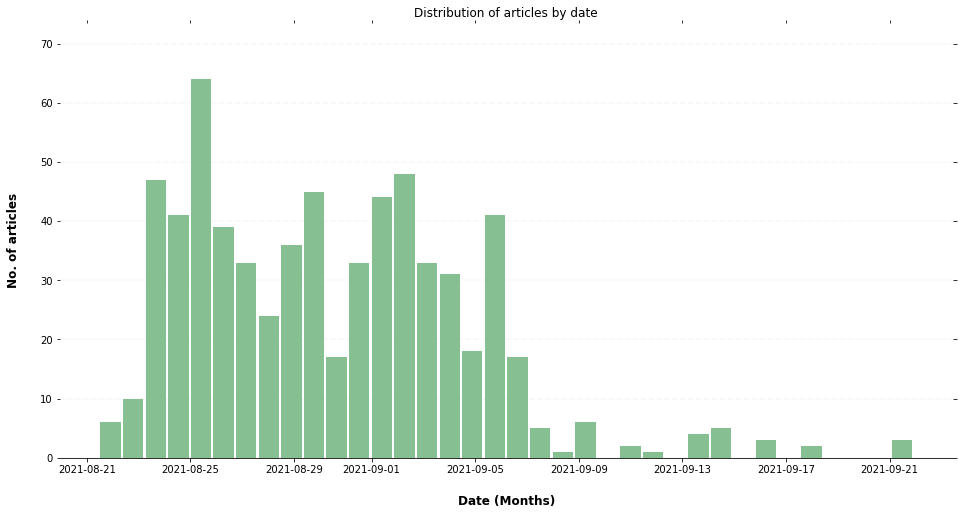

In [ ]:
ax = df_concepts['paralympic_games;japan;swimming'].hist(column='dateTime', bins=36, grid=False, figsize=(16,8), color='#86bf91', zorder=2, rwidth=0.9)

ax = ax[0]
for x in ax:

    # Despine
    x.spines['right'].set_visible(False)
    x.spines['top'].set_visible(False)
    x.spines['left'].set_visible(False)

    # Switch off ticks
    x.tick_params(axis="both", which="both", bottom="off", top="off", labelbottom="on", left="off", right="off", labelleft="on")

    # Draw horizontal axis lines
    vals = x.get_yticks()
    for tick in vals:
        x.axhline(y=tick, linestyle='dashed', alpha=0.4, color='#eeeeee', zorder=1)

    # Remove title
    x.set_title("Distribution of articles by date")

    # Set x-axis label
    x.set_xlabel("Date (Months)", labelpad=20, weight='bold', size=12)

    # Set y-axis label
    x.set_ylabel("No. of articles", labelpad=20, weight='bold', size=12)

   

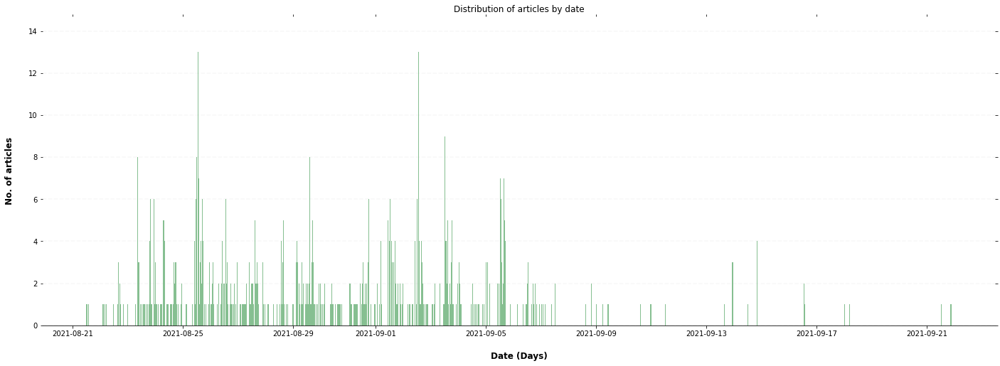

In [ ]:
ax = df_concepts['paralympic_games;japan;swimming'].hist(column='dateTime', bins=1080, grid=False, figsize=(24,8), color='#86bf91', zorder=2, rwidth=0.9)

ax = ax[0]
for x in ax:

    # Despine
    x.spines['right'].set_visible(False)
    x.spines['top'].set_visible(False)
    x.spines['left'].set_visible(False)

    # Switch off ticks
    x.tick_params(axis="both", which="both", bottom="off", top="off", labelbottom="on", left="off", right="off", labelleft="on")

    # Draw horizontal axis lines
    vals = x.get_yticks()
    for tick in vals:
        x.axhline(y=tick, linestyle='dashed', alpha=0.4, color='#eeeeee', zorder=1)

    # Remove title
    x.set_title("Distribution of articles by date")

    # Set x-axis label
    x.set_xlabel("Date (Days)", labelpad=20, weight='bold', size=12)

    # Set y-axis label
    x.set_ylabel("No. of articles", labelpad=20, weight='bold', size=12)

   

<AxesSubplot:title={'center':'Article distribution by language'}, ylabel='No. of Articles'>

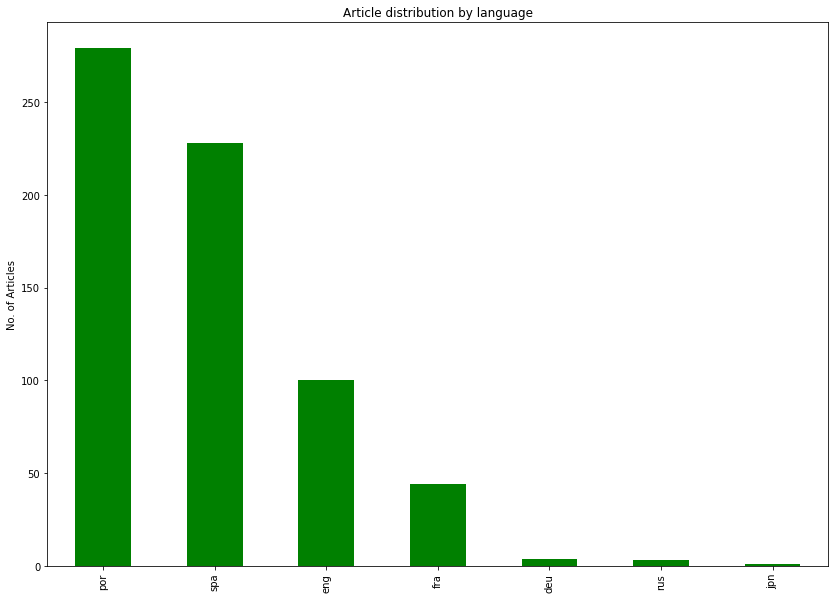

In [ ]:
df_concepts['paralympic_games;japan;swimming']['lang'].value_counts().plot(kind='bar', title='Article distribution by language', ylabel='No. of Articles', figsize=(14,10), color='green')

<AxesSubplot:title={'center':'Article distribution by source'}, ylabel='No. of Articles'>

/home/matevzm/.local/lib/python3.8/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 27598 (\N{CJK UNIFIED IDEOGRAPH-6BCE}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/matevzm/.local/lib/python3.8/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 26085 (\N{CJK UNIFIED IDEOGRAPH-65E5}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/matevzm/.local/lib/python3.8/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 26032 (\N{CJK UNIFIED IDEOGRAPH-65B0}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/matevzm/.local/lib/python3.8/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 32862 (\N{CJK UNIFIED IDEOGRAPH-805E}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)


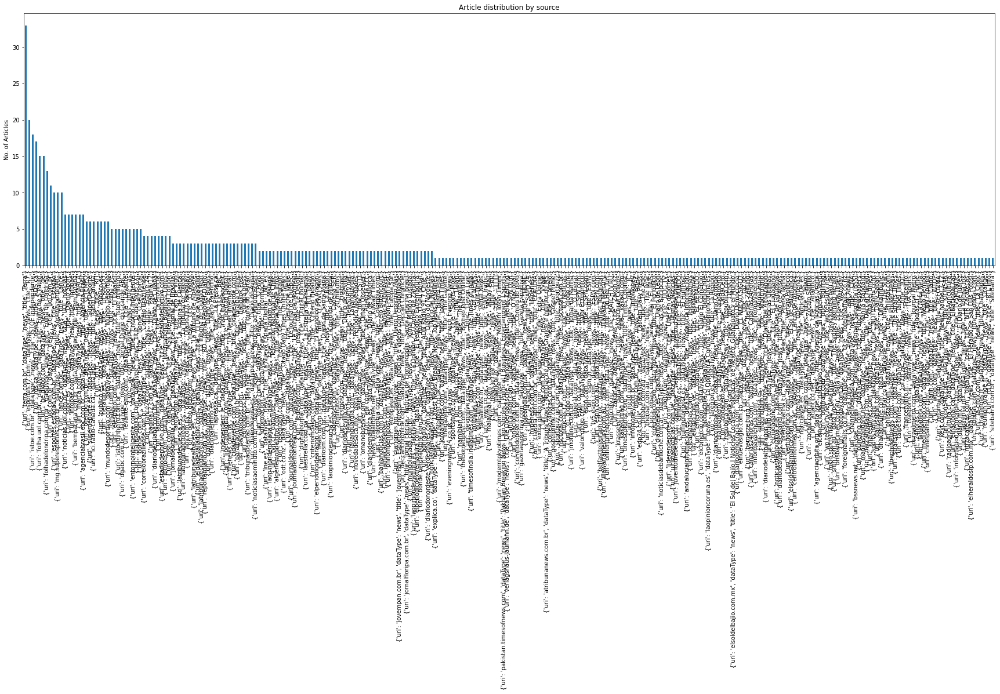

In [ ]:
df_concepts['paralympic_games;japan;swimming'].source.value_counts().plot(kind='bar', title='Article distribution by source', ylabel='No. of Articles', figsize=(30, 8) )

In [ ]:
df_concepts['paralympic_games;japan;swimming']['isDuplicate'].value_counts()

False    474
True     185
Name: isDuplicate, dtype: int64

In [ ]:
df_concepts['ever_given;suez_canal']

,concepts,source,eventUri,lang,dateTime,isDuplicate
968565,ever_given;suez_canal,"{'uri': 'atlanticcouncil.org', 'dataType': 'ne...",6.754148e+09,eng,2021-10-04 04:44:00,False
968566,ever_given;suez_canal,"{'uri': 'newyorker.com', 'dataType': 'news', '...",6.754523e+09,eng,2021-10-04 10:32:00,False
968567,ever_given;suez_canal,"{'uri': 'cnet.com', 'dataType': 'news', 'title...",6.754733e+09,eng,2021-10-04 13:13:00,False
968568,ever_given;suez_canal,"{'uri': 'english.sina.com', 'dataType': 'news'...",6.754946e+09,eng,2021-10-04 15:57:00,False
968569,ever_given;suez_canal,"{'uri': 'news.cn', 'dataType': 'news', 'title'...",6.755386e+09,eng,2021-10-05 00:02:00,False
...,...,...,...,...,...,...
2185170,ever_given;suez_canal,"{'uri': 'smh.com.au', 'dataType': 'news', 'tit...",6.780458e+09,eng,2021-10-23 18:10:00,True
2185171,ever_given;suez_canal,"{'uri': 'brisbanetimes.com.au', 'dataType': 'n...",6.780461e+09,eng,2021-10-23 18:14:00,True
2185172,ever_given;suez_canal,"{'uri': 'forbes.com', 'dataType': 'news', 'tit...",6.780693e+09,eng,2021-10-24 01:20:00,False
2185173,ever_given;suez_canal,"{'uri': 'autocar.co.uk', 'dataType': 'news', '...",6.780822e+09,eng,2021-10-24 05:40:00,False


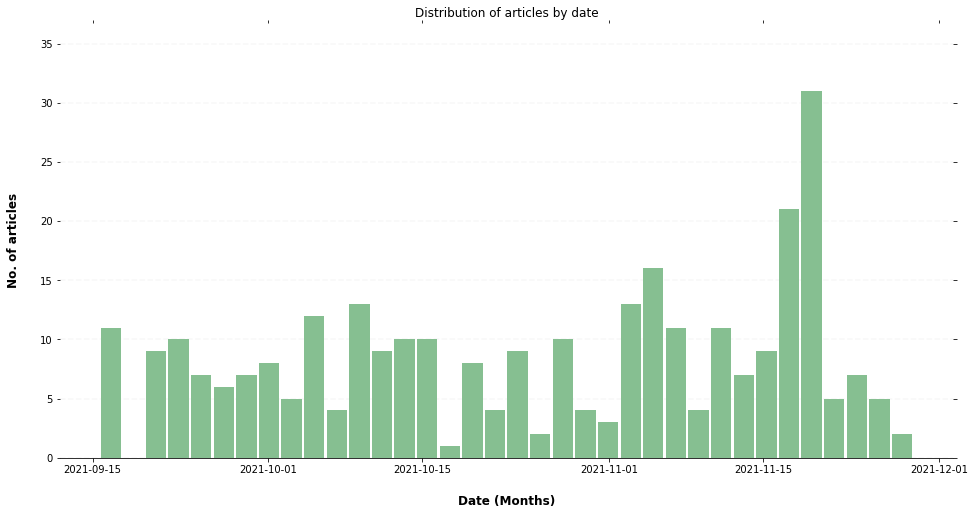

In [ ]:
ax = df_concepts['ever_given;suez_canal'].hist(column='dateTime', bins=36, grid=False, figsize=(16,8), color='#86bf91', zorder=2, rwidth=0.9)

ax = ax[0]
for x in ax:

    # Despine
    x.spines['right'].set_visible(False)
    x.spines['top'].set_visible(False)
    x.spines['left'].set_visible(False)

    # Switch off ticks
    x.tick_params(axis="both", which="both", bottom="off", top="off", labelbottom="on", left="off", right="off", labelleft="on")

    # Draw horizontal axis lines
    vals = x.get_yticks()
    for tick in vals:
        x.axhline(y=tick, linestyle='dashed', alpha=0.4, color='#eeeeee', zorder=1)

    # Remove title
    x.set_title("Distribution of articles by date")

    # Set x-axis label
    x.set_xlabel("Date (Months)", labelpad=20, weight='bold', size=12)

    # Set y-axis label
    x.set_ylabel("No. of articles", labelpad=20, weight='bold', size=12)

   

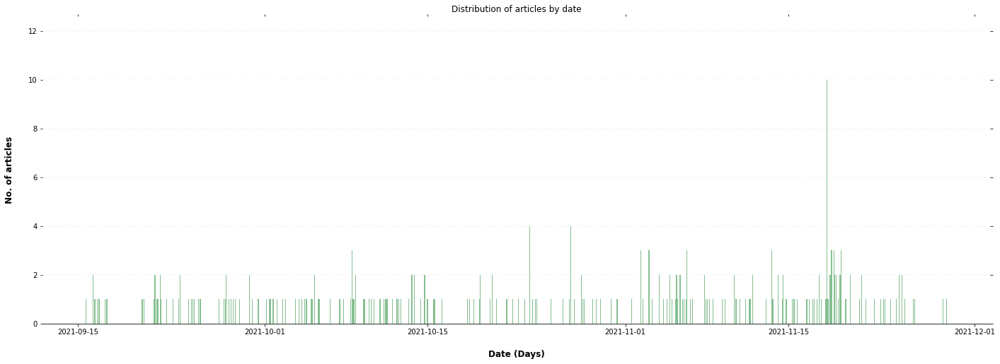

In [ ]:
ax = df_concepts['ever_given;suez_canal'].hist(column='dateTime', bins=1080, grid=False, figsize=(24,8), color='#86bf91', zorder=2, rwidth=0.9)

ax = ax[0]
for x in ax:

    # Despine
    x.spines['right'].set_visible(False)
    x.spines['top'].set_visible(False)
    x.spines['left'].set_visible(False)

    # Switch off ticks
    x.tick_params(axis="both", which="both", bottom="off", top="off", labelbottom="on", left="off", right="off", labelleft="on")

    # Draw horizontal axis lines
    vals = x.get_yticks()
    for tick in vals:
        x.axhline(y=tick, linestyle='dashed', alpha=0.4, color='#eeeeee', zorder=1)

    # Remove title
    x.set_title("Distribution of articles by date")

    # Set x-axis label
    x.set_xlabel("Date (Days)", labelpad=20, weight='bold', size=12)

    # Set y-axis label
    x.set_ylabel("No. of articles", labelpad=20, weight='bold', size=12)

   

<AxesSubplot:title={'center':'Article distribution by language'}, ylabel='No. of Articles'>

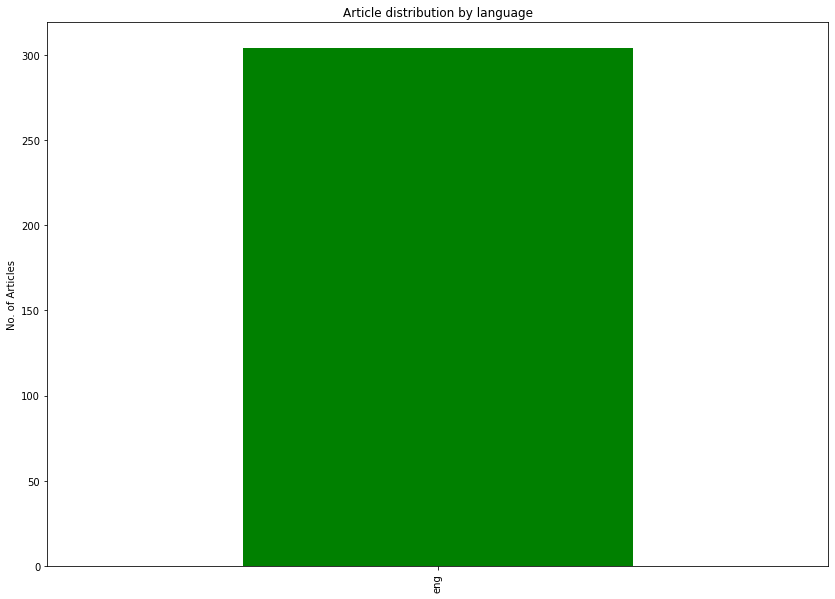

In [ ]:
df_concepts['ever_given;suez_canal']['lang'].value_counts().plot(kind='bar', title='Article distribution by language', ylabel='No. of Articles', figsize=(14,10), color='green')

<AxesSubplot:title={'center':'Article distribution by source'}, ylabel='No. of Articles'>

/home/matevzm/.local/lib/python3.8/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 20013 (\N{CJK UNIFIED IDEOGRAPH-4E2D}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/matevzm/.local/lib/python3.8/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 22269 (\N{CJK UNIFIED IDEOGRAPH-56FD}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/matevzm/.local/lib/python3.8/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 26032 (\N{CJK UNIFIED IDEOGRAPH-65B0}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/matevzm/.local/lib/python3.8/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 38395 (\N{CJK UNIFIED IDEOGRAPH-95FB}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/matevzm/.local/lib/python3.8/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 32593 (\N{CJK UNIFIED IDEOGRAPH-7F51}) missing from current font.
  

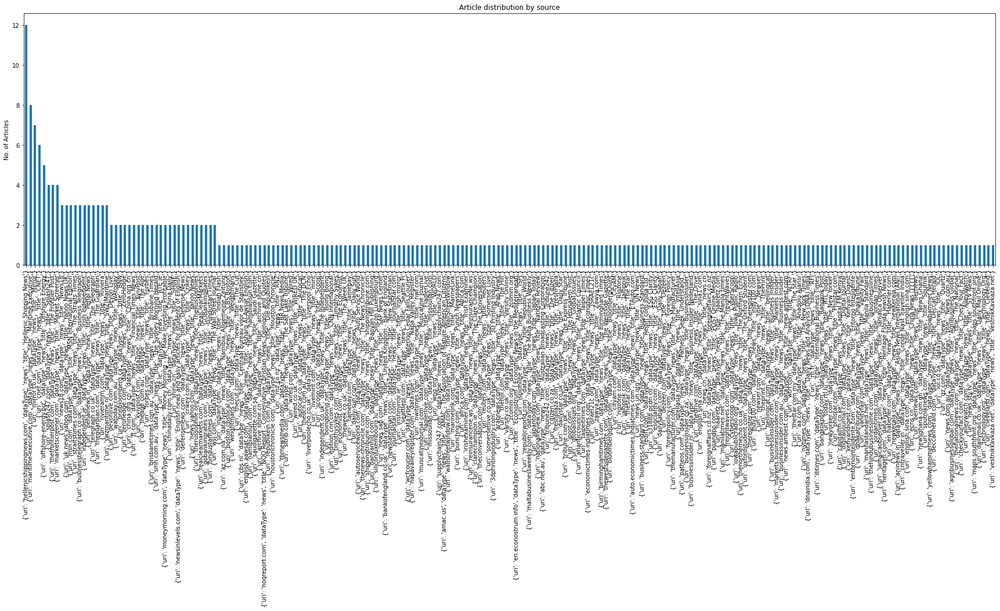

In [ ]:
df_concepts['ever_given;suez_canal'].source.value_counts().plot(kind='bar', title='Article distribution by source', ylabel='No. of Articles', figsize=(30, 8) )

In [ ]:
df_concepts['ever_given;suez_canal']['isDuplicate'].value_counts()

False    252
True      52
Name: isDuplicate, dtype: int64

In [ ]:
df_concepts['global_chip_shortage']

,concepts,source,eventUri,lang,dateTime,isDuplicate
901942,global_chip_shortage,"{'uri': 'foxbusiness.com', 'dataType': 'news',...",6.758130e+09,eng,2021-10-06 20:30:00,False
901943,global_chip_shortage,"{'uri': 'fox5atlanta.com', 'dataType': 'news',...",6.758231e+09,eng,2021-10-06 22:29:00,True
901944,global_chip_shortage,"{'uri': 'marketscreener.com', 'dataType': 'new...",6.758594e+09,eng,2021-10-07 06:51:00,False
901945,global_chip_shortage,"{'uri': 'channelnewsasia.com', 'dataType': 'ne...",6.758612e+09,eng,2021-10-07 07:07:00,False
901946,global_chip_shortage,"{'uri': 'canindia.com', 'dataType': 'news', 't...",6.763506e+09,eng,2021-10-11 07:34:00,False
...,...,...,...,...,...,...
2147107,global_chip_shortage,"{'uri': 'indianexpress.com', 'dataType': 'news...",6.801008e+09,eng,2021-11-08 15:56:00,False
2147108,global_chip_shortage,"{'uri': 'applephoneshow.com', 'dataType': 'new...",6.801047e+09,eng,2021-11-08 16:26:00,False
2147109,global_chip_shortage,"{'uri': 'kitguru.net', 'dataType': 'news', 'ti...",6.802544e+09,eng,2021-11-09 16:57:00,False
2147110,global_chip_shortage,"{'uri': 'chinadaily.com.cn', 'dataType': 'news...",6.802925e+09,eng,2021-11-09 23:31:00,False


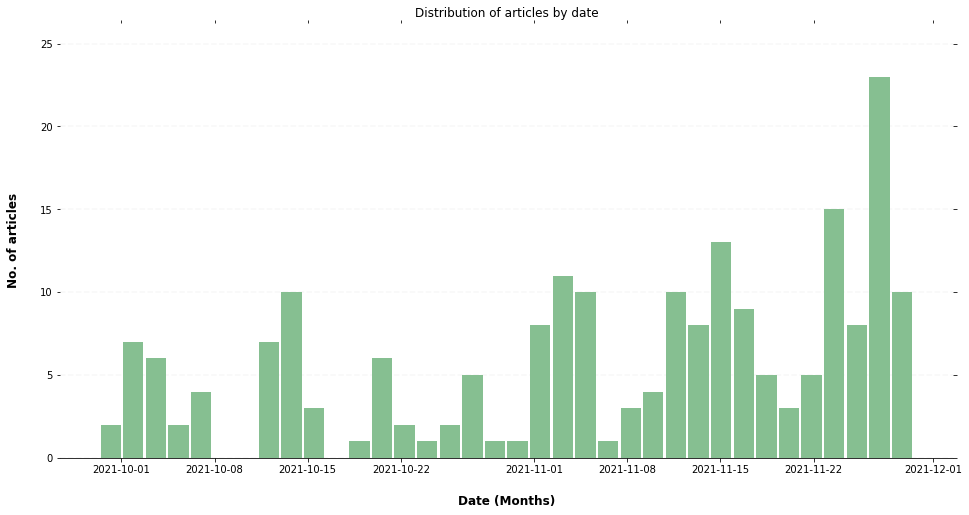

In [ ]:
ax = df_concepts['global_chip_shortage'].hist(column='dateTime', bins=36, grid=False, figsize=(16,8), color='#86bf91', zorder=2, rwidth=0.9)

ax = ax[0]
for x in ax:

    # Despine
    x.spines['right'].set_visible(False)
    x.spines['top'].set_visible(False)
    x.spines['left'].set_visible(False)

    # Switch off ticks
    x.tick_params(axis="both", which="both", bottom="off", top="off", labelbottom="on", left="off", right="off", labelleft="on")

    # Draw horizontal axis lines
    vals = x.get_yticks()
    for tick in vals:
        x.axhline(y=tick, linestyle='dashed', alpha=0.4, color='#eeeeee', zorder=1)

    # Remove title
    x.set_title("Distribution of articles by date")

    # Set x-axis label
    x.set_xlabel("Date (Months)", labelpad=20, weight='bold', size=12)

    # Set y-axis label
    x.set_ylabel("No. of articles", labelpad=20, weight='bold', size=12)


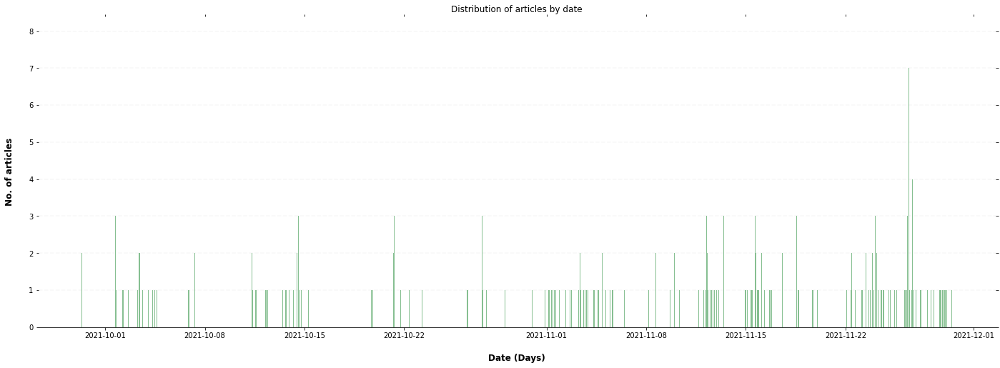

In [ ]:
ax = df_concepts['global_chip_shortage'].hist(column='dateTime', bins=1080, grid=False, figsize=(24,8), color='#86bf91', zorder=2, rwidth=0.9)

ax = ax[0]
for x in ax:

    # Despine
    x.spines['right'].set_visible(False)
    x.spines['top'].set_visible(False)
    x.spines['left'].set_visible(False)

    # Switch off ticks
    x.tick_params(axis="both", which="both", bottom="off", top="off", labelbottom="on", left="off", right="off", labelleft="on")

    # Draw horizontal axis lines
    vals = x.get_yticks()
    for tick in vals:
        x.axhline(y=tick, linestyle='dashed', alpha=0.4, color='#eeeeee', zorder=1)

    # Remove title
    x.set_title("Distribution of articles by date")

    # Set x-axis label
    x.set_xlabel("Date (Days)", labelpad=20, weight='bold', size=12)

    # Set y-axis label
    x.set_ylabel("No. of articles", labelpad=20, weight='bold', size=12)

 

<AxesSubplot:title={'center':'Article distribution by language'}, ylabel='No. of Articles'>

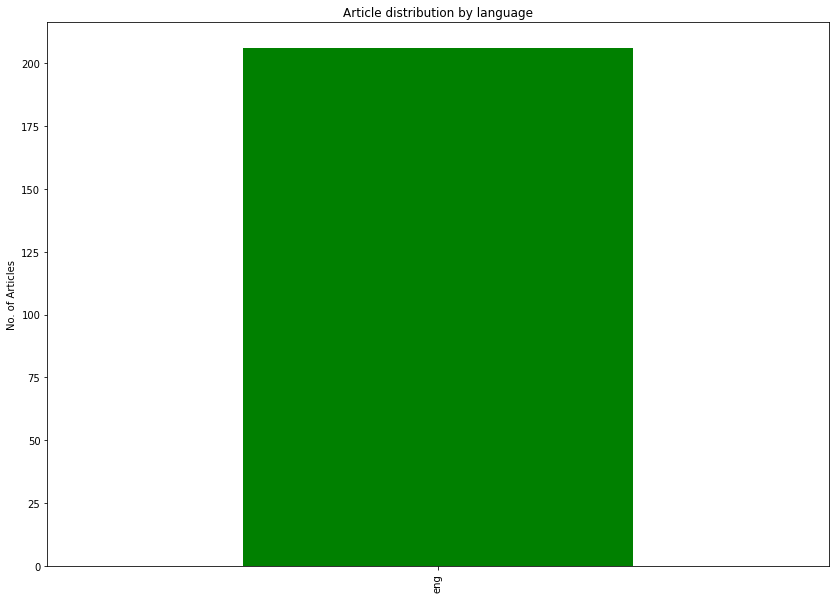

In [ ]:
df_concepts['global_chip_shortage']['lang'].value_counts().plot(kind='bar', title='Article distribution by language', ylabel='No. of Articles', figsize=(14,10), color='green')

<AxesSubplot:title={'center':'Article distribution by source'}, ylabel='No. of Articles'>

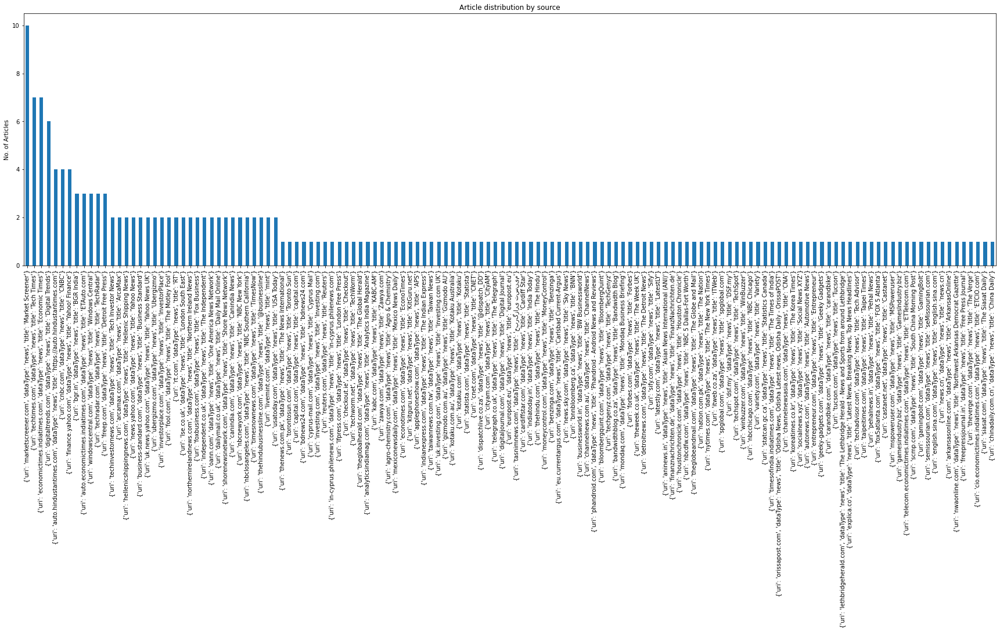

In [ ]:
df_concepts['global_chip_shortage'].source.value_counts().plot(kind='bar', title='Article distribution by source', ylabel='No. of Articles', figsize=(30, 8) )

In [ ]:
df_concepts['global_chip_shortage']['isDuplicate'].value_counts()

False    166
True      40
Name: isDuplicate, dtype: int64